## Predict whether the Tweet is a real Disaster or Not?
### Target = 1 means Real Disaster Tweet or else Target =0 Not Real Disaster Tweet

In [38]:
import pandas as pd
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
from nltk.tokenize import word_tokenize
from tqdm import tqdm
from nltk.corpus import stopwords
stop=set(stopwords.words('english'))

from collections import defaultdict,Counter
from sklearn.feature_extraction.text import CountVectorizer

import string
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from keras.layers import Embedding,LSTM,Dense,SpatialDropout1D
from keras.initializers import Constant
from keras.models import Sequential
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split

## Loading Data and Performing Exploratory Data Analysis

In [2]:
train_data = pd.read_csv("train.csv")
test_data = pd.read_csv("test.csv")
sample_sub=pd.read_csv('sample_submission.csv')
train_data.head()

,id,keyword,location,text,target
0,1,NaN,NaN,Our Deeds are the Reason of this #earthquake M...,1
1,4,NaN,NaN,Forest fire near La Ronge Sask. Canada,1
2,5,NaN,NaN,All residents asked to 'shelter in place' are ...,1
3,6,NaN,NaN,"13,000 people receive #wildfires evacuation or...",1
4,7,NaN,NaN,Just got sent this photo from Ruby #Alaska as ...,1


In [3]:
print('There are {} rows and {} columns in train'.format(train_data.shape[0],train_data.shape[1]))
print('There are {} rows and {} columns in train'.format(test_data.shape[0],test_data.shape[1]))

There are 7613 rows and 5 columns in train
There are 3263 rows and 4 columns in train


         id  keyword                       location  \
31       48   ablaze                     Birmingham   
32       49   ablaze  Est. September 2012 - Bristol   
33       50   ablaze                         AFRICA   
34       52   ablaze               Philadelphia, PA   
35       53   ablaze                     London, UK   
...     ...      ...                            ...   
7578  10830  wrecked                            NaN   
7579  10831  wrecked              Vancouver, Canada   
7580  10832  wrecked                        London    
7581  10833  wrecked                        Lincoln   
7582  10834  wrecked                            NaN   

                                                   text  target  
31    @bbcmtd Wholesale Markets ablaze http://t.co/l...       1  
32    We always try to bring the heavy. #metal #RT h...       0  
33    #AFRICANBAZE: Breaking news:Nigeria flag set a...       1  
34                   Crying out for more! Set me ablaze       0  
35    On 

Text(0, 0.5, 'samples')

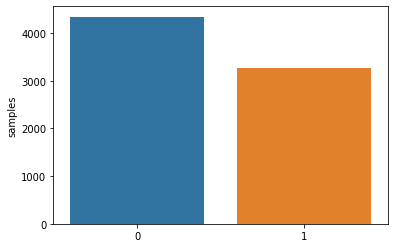

In [4]:
print(train_data[~train_data['keyword'].isnull()])
"""
Class Distribution of the Target Variable. There are more tweets with class 0 ( No disaster) 
than class 1 ( disaster tweets)
"""
x = train_data.target.value_counts()
sns.barplot(x.index,x)
plt.gca().set_ylabel('samples')



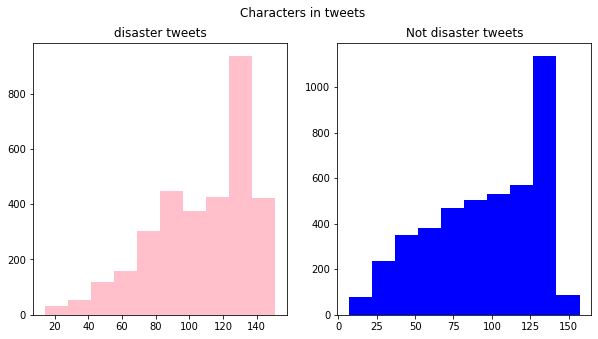

In [5]:
"""
Number of Characters in a tweets.
The distribution of both seems to be almost same.120 t0 140 characters in a tweet are the most common among both.
"""

fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
tweet_len=train_data[train_data['target']==1]['text'].str.len()
ax1.hist(tweet_len,color='pink')
ax1.set_title('disaster tweets')

tweet_len=train_data[train_data['target']==0]['text'].str.len()
ax2.hist(tweet_len,color='blue')
ax2.set_title('Not disaster tweets')
fig.suptitle('Characters in tweets')
plt.show()

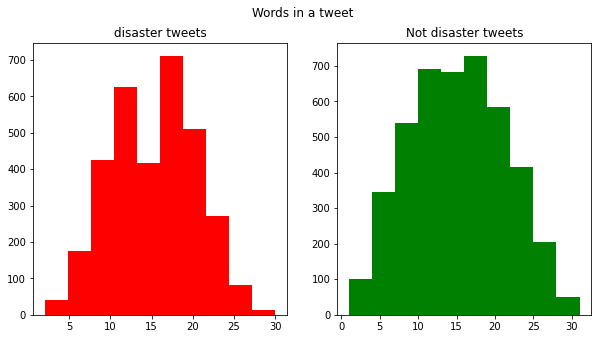

In [6]:
"""
Number of Words in a tweet
"""
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
tweet_len=train_data[train_data['target']==1]['text'].str.split().map(lambda x: len(x))
ax1.hist(tweet_len,color='red')
ax1.set_title('disaster tweets')
tweet_len=train_data[train_data['target']==0]['text'].str.split().map(lambda x: len(x))
ax2.hist(tweet_len,color='green')
ax2.set_title('Not disaster tweets')
fig.suptitle('Words in a tweet')
plt.show()

Text(0.5, 0.98, 'Average word length in each tweet')

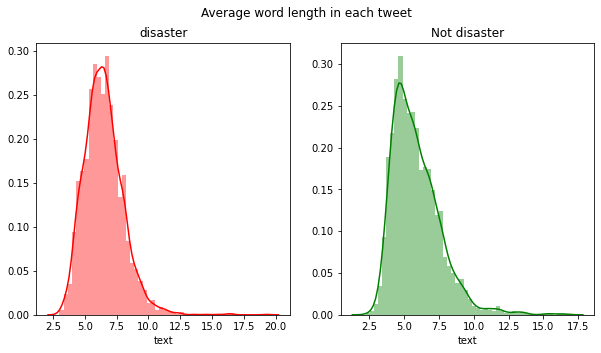

In [7]:
"""
Avergae Word Length in Tweet      
"""
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
word=train_data[train_data['target']==1]['text'].str.split().apply(lambda x : sum(len(word) for word in x) / len(x))
sns.distplot(word,ax=ax1,color='red')
ax1.set_title('disaster')

word=train_data[train_data['target']==0]['text'].str.split().apply(lambda x : sum(len(word) for word in x) / len(x))
sns.distplot(word,ax=ax2,color='green')
ax2.set_title('Not disaster')
fig.suptitle('Average word length in each tweet')

In [8]:
def create_corpus(target):
    corpus=[]
    
    for x in train_data[train_data['target']==target]['text'].str.split():
        
        for i in x:
            corpus.append(i)
    return corpus

<BarContainer object of 10 artists>

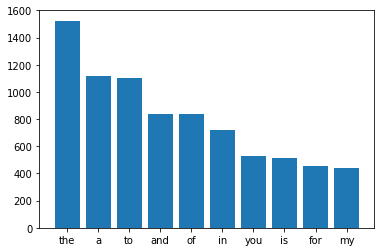

In [9]:
"""
Commomn Stopwords in Tweets - Class 0 (Non Disaster Tweet)
"""
corpus=create_corpus(0)

dic = defaultdict(int)
for word in corpus:
    if word in stop:
        dic[word] = dic[word] + 1

top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:10] 
x,y=zip(*top)
plt.bar(x,y)

<BarContainer object of 10 artists>

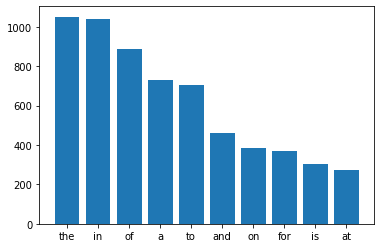

In [10]:
"""
Commomn Stopwords in Tweets - Class 1 (Disaster Tweet)
"""
corpus=create_corpus(1)

dic=defaultdict(int)
for word in corpus:
    if word in stop:
        dic[word]+=1

top=sorted(dic.items(), key=lambda x:x[1],reverse=True)[:10] 
    
x,y=zip(*top)
plt.bar(x,y)

<BarContainer object of 20 artists>

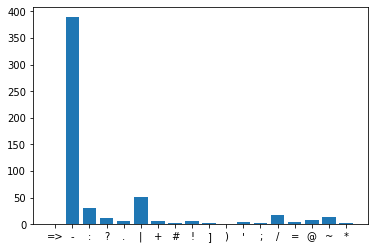

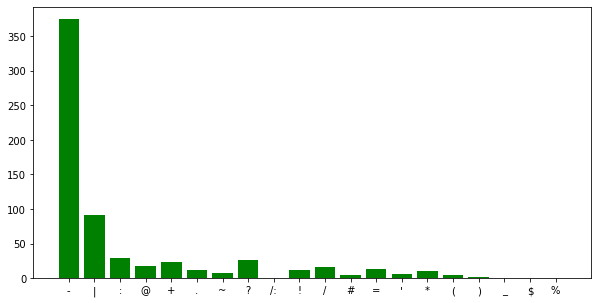

In [11]:
"""
Analyzing Punctuations - Class -1 (Real Disaster)
"""
corpus=create_corpus(1)

dic=defaultdict(int)
import string
special = string.punctuation
for i in (corpus):
    if i in special:
        dic[i]+=1
        
x,y=zip(*dic.items())
plt.bar(x,y)

"""
Class 0 (Not Real Disaster)
"""
plt.figure(figsize=(10,5))
corpus=create_corpus(0)

dic=defaultdict(int)
import string
special = string.punctuation
for i in (corpus):
    if i in special:
        dic[i]+=1
        
x,y=zip(*dic.items())
plt.bar(x,y,color='green')

## Observation : In both of them,"the" dominates which is followed by "a" in class 0 and "in" in class 1.

In [12]:
def create_corpus_all():
    corpus=[]
    
    for x in train_data['text'].str.split():
        
        for i in x:
            corpus.append(i)
    return corpus

all_words_corpus = create_corpus_all()

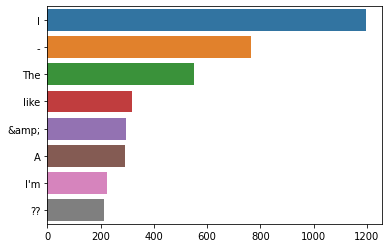

In [13]:
"""
Common Words  Across Entire Corpus
"""
count = Counter(all_words_corpus)
most=count.most_common()
x=[]
y=[]
for word,count in most[:40]:
    if (word not in stop) :
        x.append(word)
        y.append(count)
sns.barplot(x=y,y=x)

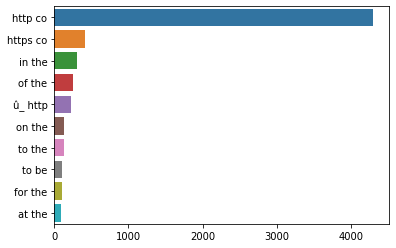

In [14]:
def get_top_tweet_bigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

top_tweet_bigrams=get_top_tweet_bigrams(train_data['text'])[:10]
x,y=map(list,zip(*top_tweet_bigrams))
sns.barplot(x=y,y=x)

### Performing Some Basic Data Cleaning before going to modelling. Data Cleaning process would include

Removing URL's
Removing HTML Tags
Removing Emojis
Removing Punctuations
Spelling Correction



In [15]:
def remove_URL(text):
    url = re.compile(r'https?://\S+|www\.\S+')
    return url.sub(r'',text)

def remove_html(text):
    html=re.compile(r'<.*?>')
    return html.sub(r'',text)

def remove_emoji(text):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', text)

def remove_punct(text):
    table=str.maketrans('','',string.punctuation)
    return text.translate(table)

In [16]:
df=pd.concat([train_data,test_data])
df.shape

"""
Removing URL's
"""

df['text']=df['text'].apply(lambda x : remove_URL(x))
df['text']=df['text'].apply(lambda x : remove_html(x))
df['text']=df['text'].apply(lambda x: remove_emoji(x))
df['text']=df['text'].apply(lambda x : remove_punct(x))

df

/Users/mdp/.pyenv/versions/3.6.9/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  """Entry point for launching an IPython kernel.


,id,keyword,location,target,text
0,1,NaN,NaN,1.0,Our Deeds are the Reason of this earthquake Ma...
1,4,NaN,NaN,1.0,Forest fire near La Ronge Sask Canada
2,5,NaN,NaN,1.0,All residents asked to shelter in place are be...
3,6,NaN,NaN,1.0,13000 people receive wildfires evacuation orde...
4,7,NaN,NaN,1.0,Just got sent this photo from Ruby Alaska as s...
...,...,...,...,...,...
3258,10861,NaN,NaN,NaN,EARTHQUAKE SAFETY LOS ANGELES ÛÒ SAFETY FASTE...
3259,10865,NaN,NaN,NaN,Storm in RI worse than last hurricane My citya...
3260,10868,NaN,NaN,NaN,Green Line derailment in Chicago
3261,10874,NaN,NaN,NaN,MEG issues Hazardous Weather Outlook HWO


In [17]:
"""
Glove for Vectorization
"""
def create_corpus(df):
    corpus=[]
    for tweet in tqdm(df['text']):
        #print(tweet)
        words=[word.lower() for word in word_tokenize(tweet) if((word.isalpha()==1) & (word not in stop))]
        #print(words)
        corpus.append(words)
    return corpus
        

In [ ]:
"""
each element of `text` contains an sequence of words. Now we use a Tokenizer to represent words by their 
word indexes.
we pad the sequences to create a sequence of same length to be passed to the LSTM network.
This tells the tokenizer to consider only the most frequently occurring 100K words in the training dataset.
"""

In [20]:
corpus=create_corpus(df)
MAX_LEN = 50

tokenizer_obj=Tokenizer()
tokenizer_obj.fit_on_texts(corpus)
sequences=tokenizer_obj.texts_to_sequences(corpus)

tweet_pad=pad_sequences(sequences,maxlen=MAX_LEN,truncating='post',padding='post')
print(tweet_pad)

100%|██████████| 10876/10876 [00:01<00:00, 5730.47it/s]


[[ 622 5467  738 ...    0    0    0]
 [  96    7  138 ...    0    0    0]
 [ 119 1469 1386 ...    0    0    0]
 ...
 [ 749  478  348 ...    0    0    0]
 [4085  536  372 ...    0    0    0]
 [3997 2557 1462 ...    0    0    0]]


In [80]:
type(tweet_pad)

numpy.ndarray

In [47]:
word_index=tokenizer_obj.word_index
print('Number of unique words:',len(word_index))


Number of unique words: 20342


In [25]:
embedding_dict={}
with open('glove.6B.100d.txt','r') as f:
    for line in f:
        values=line.split()
        #print(values)
        word=values[0]
        #print(word)
        vectors=np.asarray(values[1:],'float32')
        #print(vectors)
        embedding_dict[word]=vectors
        
f.close()
embedding_dict

{'the': array([-0.038194, -0.24487 ,  0.72812 , -0.39961 ,  0.083172,  0.043953,
        -0.39141 ,  0.3344  , -0.57545 ,  0.087459,  0.28787 , -0.06731 ,
         0.30906 , -0.26384 , -0.13231 , -0.20757 ,  0.33395 , -0.33848 ,
        -0.31743 , -0.48336 ,  0.1464  , -0.37304 ,  0.34577 ,  0.052041,
         0.44946 , -0.46971 ,  0.02628 , -0.54155 , -0.15518 , -0.14107 ,
        -0.039722,  0.28277 ,  0.14393 ,  0.23464 , -0.31021 ,  0.086173,
         0.20397 ,  0.52624 ,  0.17164 , -0.082378, -0.71787 , -0.41531 ,
         0.20335 , -0.12763 ,  0.41367 ,  0.55187 ,  0.57908 , -0.33477 ,
        -0.36559 , -0.54857 , -0.062892,  0.26584 ,  0.30205 ,  0.99775 ,
        -0.80481 , -3.0243  ,  0.01254 , -0.36942 ,  2.2167  ,  0.72201 ,
        -0.24978 ,  0.92136 ,  0.034514,  0.46745 ,  1.1079  , -0.19358 ,
        -0.074575,  0.23353 , -0.052062, -0.22044 ,  0.057162, -0.15806 ,
        -0.30798 , -0.41625 ,  0.37972 ,  0.15006 , -0.53212 , -0.2055  ,
        -1.2526  ,  0.071624,  

In [48]:
num_words=len(word_index)+1
embedding_matrix=np.zeros((num_words,100))

embedding_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [53]:
word_index

{'i': 1,
 'the': 2,
 'like': 3,
 'amp': 4,
 'im': 5,
 'a': 6,
 'fire': 7,
 'get': 8,
 'new': 9,
 'via': 10,
 'news': 11,
 'people': 12,
 'one': 13,
 'in': 14,
 'dont': 15,
 'us': 16,
 'emergency': 17,
 'video': 18,
 'disaster': 19,
 'would': 20,
 'this': 21,
 'to': 22,
 'police': 23,
 'still': 24,
 'is': 25,
 'got': 26,
 'you': 27,
 'my': 28,
 'suicide': 29,
 'body': 30,
 'crash': 31,
 'burning': 32,
 'first': 33,
 'storm': 34,
 'rt': 35,
 'attack': 36,
 'time': 37,
 'back': 38,
 'know': 39,
 'california': 40,
 'fires': 41,
 'buildings': 42,
 'see': 43,
 'going': 44,
 'and': 45,
 'man': 46,
 'day': 47,
 'love': 48,
 'two': 49,
 'world': 50,
 'cant': 51,
 'bomb': 52,
 'if': 53,
 'nuclear': 54,
 'full': 55,
 'go': 56,
 'hiroshima': 57,
 'dead': 58,
 'youtube': 59,
 'watch': 60,
 'today': 61,
 'life': 62,
 'think': 63,
 'car': 64,
 'train': 65,
 'last': 66,
 'killed': 67,
 'it': 68,
 'accident': 69,
 'its': 70,
 'good': 71,
 'of': 72,
 'say': 73,
 'we': 74,
 'make': 75,
 'war': 76,
 'no':

In [54]:
for word,i in tqdm(word_index.items()):
    print("Word",word)
    print("I___",i)
    
    if i > num_words:
        continue
    
    emb_vec=embedding_dict.get(word)
    print("Embed",emb_vec)
    if emb_vec is not None:
        embedding_matrix[i]=emb_vec

  1%|          | 111/20342 [00:00<00:37, 535.87it/s]

Word i
I___ 1
Embed [-0.046539   0.61966    0.56647   -0.46584   -1.189      0.44599
  0.066035   0.3191     0.14679   -0.22119    0.79239    0.29905
  0.16073    0.025324   0.18678   -0.31001   -0.28108    0.60515
 -1.0654     0.52476    0.064152   1.0358    -0.40779   -0.38011
  0.30801    0.59964   -0.26991   -0.76035    0.94222   -0.46919
 -0.18278    0.90652    0.79671    0.24825    0.25713    0.6232
 -0.44768    0.65357    0.76902   -0.51229   -0.44333   -0.21867
  0.3837    -1.1483    -0.94398   -0.15062    0.30012   -0.57806
  0.20175   -1.6591    -0.079195   0.026423   0.22051    0.99714
 -0.57539   -2.7266     0.31448    0.70522    1.4381     0.99126
  0.13976    1.3474    -1.1753     0.0039503  1.0298     0.064637
  0.90887    0.82872   -0.47003   -0.10575    0.5916    -0.4221
  0.57331   -0.54114    0.10768    0.39784   -0.048744   0.064596
 -0.61437   -0.286      0.5067    -0.49758   -0.8157     0.16408
 -1.963     -0.26693   -0.37593   -0.95847   -0.8584    -0.71577
 -0.3

  1%|          | 220/20342 [00:00<00:37, 541.53it/s]

 on
I___ 116
Embed [-2.1863e-01 -4.2664e-01  5.1960e-01  4.3103e-03  5.8045e-01 -1.0873e-01
 -3.7726e-01  4.5660e-01 -6.0627e-01 -7.5773e-02  1.1306e-01  1.7703e-01
  1.6050e-01  7.4514e-02  6.3649e-01 -7.8852e-02  7.5268e-01 -2.4962e-01
 -5.1628e-01 -3.3348e-01  6.6754e-01 -3.4183e-01  6.1316e-01  3.1668e-01
  6.4846e-01 -7.9312e-02 -6.5219e-02 -1.7718e-01 -3.2439e-01  5.1868e-01
 -2.3424e-01  3.4381e-01  4.6851e-02  7.4025e-01 -4.7005e-01  5.3685e-01
 -3.5549e-01  4.0737e-01 -9.3421e-02 -1.3439e-01 -4.1969e-01 -3.0041e-01
  2.8646e-01  3.7419e-01 -4.6054e-01 -3.0700e-01 -3.8580e-01 -6.9317e-01
 -9.2461e-04 -6.1984e-01  1.1978e-01  1.4950e-01  1.7833e-01  1.5313e+00
 -9.2445e-01 -3.0428e+00  3.0761e-02 -6.4359e-01  2.3824e+00  5.6219e-01
 -5.6021e-01  1.0264e+00 -4.5143e-01  1.4117e-01  6.5944e-01  3.7572e-01
  9.8334e-02  3.8304e-01 -7.6882e-02 -2.1781e-01 -2.9892e-01 -4.9458e-01
  9.5239e-02 -6.3059e-01 -6.1311e-02  1.7767e-01 -1.4051e-01  4.7182e-01
 -9.5891e-01  4.5334e-02  8.0800

  2%|▏         | 315/20342 [00:00<00:39, 502.32it/s]

[ 0.12648    0.1366     0.22192   -0.025204  -0.7197     0.66147
  0.48509    0.057223   0.13829   -0.26375   -0.23647    0.74349
  0.46737   -0.462      0.20031   -0.26302    0.093948  -0.61756
 -0.28213    0.1353     0.28213    0.21813    0.16418    0.22547
 -0.98945    0.29624   -0.62476   -0.29535    0.21534    0.92274
  0.38388    0.55744   -0.14628   -0.15674   -0.51941    0.25629
 -0.0079678  0.12998   -0.029192   0.20868   -0.55127    0.075353
  0.44746   -0.71046    0.75562    0.010378   0.095229   0.16673
  0.22073   -0.46562   -0.10199   -0.80386    0.45162    0.45183
  0.19869   -1.6571     0.7584    -0.40298    0.82426   -0.386
  0.0039546  0.61318    0.02701   -0.3308    -0.095652  -0.082164
  0.7858     0.13394   -0.32715   -0.31371   -0.20247   -0.73001
 -0.49343    0.56445    0.61038    0.36777   -0.070182   0.44859
 -0.61774   -0.18849    0.65592    0.44797   -0.10469    0.62512
 -1.9474    -0.60622    0.073874   0.50013   -1.1278    -0.42066
 -0.37322   -0.50538    0

  2%|▏         | 424/20342 [00:00<00:38, 523.86it/s]


Word county
I___ 328
Embed [-0.22318   -0.5274     0.82868   -0.32932    0.76478    0.93719
  0.49739    1.4427     0.11256   -0.19446   -1.176     -0.2777
  0.28358    0.011508   0.29242   -0.90981    1.9659     0.35991
 -0.8521     0.61113    0.25263    0.33603    0.72212   -0.049378
 -1.1165    -0.33716   -0.0086157 -0.37551   -0.65489    0.3186
  0.2503    -0.020876   1.1594    -0.16441   -0.20228   -0.84529
  0.3321    -0.37713    0.88493   -0.21008   -0.9008    -0.89642
 -0.48555   -1.3986     0.57437   -0.29629    0.93384   -1.6209
  0.47179   -0.65098   -0.2578    -1.0029     0.29574   -0.074997
 -0.063019  -1.9356     0.46288   -0.82475    1.1085     0.39807
 -0.11419    0.40505    0.43049    1.1894     0.57375   -0.63348
  0.21335    0.90243    0.44558    1.011     -0.59368    0.96174
  0.19372   -0.73644    1.6105    -0.24088    0.20594    0.46957
 -0.65403    0.098246   0.32936    0.77842   -0.016287  -0.4789
 -0.46798    0.14883   -0.579     -0.65878    1.1676     0.22632

  3%|▎         | 539/20342 [00:01<00:36, 548.50it/s]


Word me
I___ 453
Embed [ 5.6719e-02  1.3333e-01  7.2690e-01 -4.6336e-01 -5.9334e-01  7.1746e-01
 -1.1795e-01  2.1614e-01  4.3036e-01 -6.7053e-01  5.7480e-01  2.6827e-01
  2.4659e-02  1.6066e-01  2.0400e-01 -3.9246e-01 -6.3294e-01  6.2915e-01
 -7.6340e-01  1.1581e+00  3.6218e-01  3.1932e-01 -6.5613e-01 -4.7797e-01
  2.9885e-01  6.2435e-01 -4.6060e-01 -9.6276e-01  1.2214e+00 -2.3152e-01
 -6.8889e-02  6.3519e-01  7.7546e-01  3.3128e-01 -3.5220e-01  7.4236e-01
 -6.6703e-01  3.2260e-01  4.3490e-01 -6.0154e-01 -4.2067e-01  2.1991e-02
  1.6378e-01 -9.5682e-01 -6.4464e-01 -9.4111e-02 -2.7105e-01 -2.3312e-01
 -3.8453e-01 -1.2665e+00 -1.8289e-01  5.0432e-01 -5.4260e-02  1.1872e+00
 -4.7143e-01 -2.6562e+00  4.4917e-01  6.7218e-01  1.4074e+00  1.9179e-03
  4.0658e-01  1.4287e+00 -1.0631e+00 -2.1713e-01  4.7800e-01  1.3170e-01
  1.2494e+00  7.2980e-01 -2.0880e-01  2.5449e-01  1.2297e-01  3.4922e-01
  2.4051e-01 -8.1023e-01  5.2047e-01  6.8801e-01  6.7784e-02 -2.2132e-01
 -1.2176e-01 -1.6238e-01  5

  3%|▎         | 655/20342 [00:01<00:35, 561.38it/s]

566
Embed [ 1.2705e-01  3.7253e-01  2.3076e-01 -1.0727e-01  1.4273e+00  7.7990e-01
 -5.5009e-02 -1.8909e-01 -4.2828e-01  2.8443e-01  1.1920e-01 -6.1978e-01
 -3.9817e-01  1.9127e-01 -3.2098e-01 -2.4116e-01  6.0927e-01 -3.5765e-01
  2.0159e-01  9.1107e-01 -4.8977e-01 -2.8970e-01  1.0098e+00 -6.6149e-01
  7.0414e-02  1.3353e-01  4.2234e-01 -8.0188e-02  1.0722e+00  2.6426e-01
 -7.3982e-01  6.4958e-01 -4.8367e-01  8.5837e-01 -3.9008e-01 -1.3020e-01
  2.2331e-01  2.0818e-01 -4.7260e-01 -1.7275e+00  3.7209e-01  5.5544e-01
 -8.9025e-01  8.7442e-01 -2.9063e-01 -7.1175e-01 -3.3437e-01 -4.1141e-01
  9.9049e-01 -4.6207e-01 -2.5777e-01  4.9513e-02 -2.2242e-01 -3.3757e-01
 -1.5677e-01 -2.9576e+00 -5.8878e-01  2.2432e-01  1.6375e+00  1.0263e+00
  8.9573e-01  1.3718e+00 -3.7709e-01 -8.2095e-02  1.6339e-01 -2.5294e-01
  1.0987e+00 -2.0032e-03  7.9235e-01 -2.9403e-01 -2.6906e-01  2.3123e-01
  3.3826e-01  1.7150e-01 -3.5479e-01 -1.3497e-01  6.4417e-02 -3.4495e-01
  1.0946e-01 -6.6469e-01 -7.0734e-02 -6.8

  4%|▍         | 776/20342 [00:01<00:34, 571.70it/s]


Word called
I___ 705
Embed [-0.69321   -0.4055    -0.097805  -0.24244    0.17236    0.08163
 -0.047831   0.44821   -0.24222   -0.065717  -0.53115   -0.40135
  0.28277    0.20314    0.30505    0.14683    0.72686   -0.12494
 -0.42272    0.016589   0.2993    -0.23278   -0.34599   -0.28389
  0.21532    0.072135  -0.080068  -0.097477   0.039596   0.54599
  0.31484    0.75374   -0.12927    0.39599    0.5641     0.14666
  0.42306    0.27284    0.1955    -0.12319   -0.65589    0.27151
  0.23175   -0.35651   -0.0093057 -0.095994  -0.30947   -0.0073496
 -0.078173   0.085239  -0.18881    0.14317    0.46056    0.70236
 -1.0063    -2.6236    -0.20536   -0.08254    1.3812     0.91392
 -0.03478    0.22303   -0.038465  -0.35531    0.97832   -0.3384
  0.42215    0.504      0.24439   -0.40787    0.10728   -0.2331
 -0.48326   -0.39685   -0.10597   -0.047702   0.20389    0.28397
 -1.0879     0.045633   0.61092   -0.44083   -0.58399    0.007972
 -1.478      0.15884    0.17551   -0.25211    0.096376  -0.50

  4%|▍         | 899/20342 [00:01<00:33, 585.30it/s]

I___ 828
Embed [ 2.5104e-02  2.5109e-01  6.8351e-01 -4.1564e-01 -1.0884e+00  2.4467e-01
 -4.9475e-01  3.8726e-01  4.5608e-01 -5.3721e-01  5.9937e-01  1.0818e-01
  9.1310e-02  2.5231e-01 -3.3815e-01 -1.3615e-01  6.9624e-02  9.6199e-01
 -4.0212e-01  5.5325e-01  2.8682e-01  4.9279e-01  5.9342e-02 -3.6391e-01
 -4.6083e-01  1.5661e-01 -5.9443e-01 -1.0090e+00  7.6246e-01 -4.2156e-01
 -1.7240e-02  8.7531e-01  2.5855e-01  4.5215e-02  2.9108e-01  3.0749e-01
 -2.8534e-01  2.4199e-01  9.2311e-01 -5.4466e-01  1.2054e-01 -8.6023e-03
 -7.1872e-01 -1.1377e+00 -6.6307e-01 -2.6319e-01  1.6587e-05 -3.8913e-01
 -4.8201e-01 -1.0784e+00  1.1614e-01 -5.2009e-02  3.2136e-02  6.2282e-01
  3.2842e-01 -1.9841e+00  1.4211e-01  3.7583e-01  1.3575e+00  1.9705e-01
 -1.6906e-01  5.8690e-01 -9.3320e-01 -4.4678e-01  7.7586e-01  3.1231e-01
  7.1754e-01  2.3560e-01 -4.3405e-01 -2.1243e-01  4.4494e-01  7.9650e-02
 -2.6846e-01 -4.3429e-01  1.2376e-01 -1.8461e-01 -5.9016e-02 -2.5812e-02
 -4.3252e-01  1.8477e-01  3.5901e-01

  5%|▍         | 958/20342 [00:01<00:44, 434.48it/s]


Word members
I___ 930
Embed [ 1.2804e-01  1.7035e-01  1.6697e-04 -7.2995e-01  2.1784e-01  6.7215e-01
 -6.5565e-02  4.4775e-01 -3.8164e-01 -1.2586e-01  3.3258e-01 -4.8206e-01
  1.0431e+00  1.7192e-01 -5.0811e-01 -5.8984e-01  1.0478e-01 -6.1272e-01
 -8.6102e-01  1.9620e-01  4.2851e-01 -3.1176e-01  2.5709e-01 -5.7597e-01
 -4.4215e-01 -9.8682e-01  1.9055e-01 -2.9888e-01  9.9260e-01  4.4657e-01
  7.2666e-01  6.3624e-01 -4.9693e-01 -5.5484e-02  1.2474e-01  1.3647e-01
  9.0847e-01  4.2567e-01  1.3833e-01  1.3251e-01 -1.2708e+00 -1.2705e-01
  1.0378e+00  1.8706e-01  2.3332e-01 -3.2289e-01 -5.4932e-01  4.9797e-03
 -3.7152e-01 -8.2057e-02 -3.9388e-01 -4.3560e-01 -3.9053e-01  7.8519e-01
 -3.7901e-01 -1.6479e+00  4.1538e-01 -8.5929e-01  1.6895e+00  8.3287e-01
 -4.2748e-01  8.1610e-01  3.3560e-01  3.2526e-01  6.0771e-01 -1.0563e-01
  1.2662e-02  7.9631e-01  1.1112e+00 -2.9734e-01  3.3521e-01 -5.9666e-01
 -8.1183e-01 -7.4802e-01 -3.9796e-01  1.7214e-01 -2.2177e-01 -5.5819e-01
 -8.9832e-01 -2.8444e-

  5%|▌         | 1065/20342 [00:02<00:42, 450.72it/s]

I___ 981
Embed [ 0.080541  -0.24853    0.49877   -0.40117   -0.31195   -0.082373
 -0.37048    0.19148    0.52062    0.17868    0.0077633  0.50248
  0.49648   -0.24741   -0.22858   -0.22163   -0.33014   -0.44667
 -0.615      0.14616    0.36147    0.028392  -0.25705    0.04591
 -0.25025    0.27139   -0.14657   -0.11115   -0.036146   0.38291
  0.27912    0.41813   -0.027788   0.14415    0.040518   0.19159
  0.25789    0.064674  -0.35255   -0.1907    -1.111      0.28486
  0.41228   -0.077736  -0.31641   -0.57967    0.1685    -0.48568
 -0.54785   -1.0328     0.71192    0.26502    0.41243    1.2761
 -0.69966   -2.1557    -0.13692   -0.053583   1.5774     0.75069
 -0.22124   -0.069583  -0.4853    -0.43006    0.32896    0.13117
  0.59977    0.9336    -0.33677    0.021782   0.40247   -0.35552
  0.16349   -0.62828    0.29131    0.6594     0.23263    0.46422
 -1.5815     0.071634   0.79564   -0.55577   -0.22991   -0.50637
 -1.5861    -0.61409   -0.28321    0.23409   -0.40721   -0.35671
  0.42893 

  6%|▌         | 1182/20342 [00:02<00:37, 509.94it/s]


Word department
I___ 1104
Embed [ 0.38717  -0.58237   0.17566  -0.21869   0.5413   -0.55772  -0.071492
  1.0838    0.30724   0.48699  -0.15413  -0.86593   0.11658   0.69209
 -0.5106    0.35072   0.69951  -0.03115  -0.91644  -0.15303   0.28233
 -0.048093  0.3012   -0.49115  -1.0011   -0.24409   0.42998  -1.0131
 -0.74032  -0.48478  -0.19952  -0.039122 -0.38332   0.22545  -0.94902
  0.49169  -0.62747  -0.1561    0.43547  -0.21603  -0.18486  -0.73807
 -0.5248    0.1839    0.40135   0.14385  -0.19514   0.2725   -0.13323
 -0.89427   1.313    -0.63222   0.048517  0.4761   -0.35422  -1.6572
  0.19347  -0.59862   2.076     0.66838  -0.12751  -0.25637   0.39386
 -0.30245   0.62125  -0.27639  -0.066005  1.2287    1.3532    1.5431
  0.21105   0.35322  -0.21321  -0.3326    0.68279   0.26841  -0.33587
  0.66004  -1.3282    0.11535   0.14965  -0.15981  -0.84111  -0.010433
 -1.3863   -0.19899   0.12792  -0.051545 -0.062002 -0.58003   0.93125
 -0.56496  -0.50203   0.16674  -0.31783   0.58256  -0.2195

  6%|▋         | 1289/20342 [00:02<00:39, 481.40it/s]

[ 6.1014e-01  3.7450e-01  3.6024e-01 -1.0522e+00  9.7883e-01  5.8461e-01
  2.3994e-01  7.8352e-01  3.8005e-01  2.9182e-01 -9.7297e-03  1.5972e+00
 -8.5543e-02  1.2395e-01 -2.6860e-01  4.2902e-01 -4.3340e-02 -1.2002e-01
  5.2070e-01 -2.6676e-01 -1.1873e-01 -1.3220e-01  1.5766e-01 -2.9107e-01
  8.1801e-01  1.1628e-01 -2.7779e-01 -9.7902e-01  1.3431e-01 -1.3703e+00
  1.9457e-01 -4.7067e-01  5.6822e-01  1.4734e-01  1.8163e-01  1.5049e-01
 -3.7055e-01  1.0581e+00 -7.0661e-02  1.9461e-01  8.6618e-01 -7.2678e-01
  5.8463e-01 -5.3164e-01 -6.9930e-01 -3.3136e-01  1.5184e-01 -6.5722e-01
 -2.7578e-01 -2.2782e-01 -3.9517e-01  3.6234e-01  7.1269e-01  5.1063e-01
 -2.9516e-01 -8.0251e-01 -6.7107e-02 -5.9274e-01  5.1046e-01 -1.6815e-02
  5.2484e-01  6.2412e-02 -4.5783e-01  8.2703e-01 -7.7119e-02 -4.0058e-01
 -6.4494e-01  5.6521e-01  8.3850e-01 -2.5604e-01  2.6324e-02 -3.6223e-01
  1.3618e-01  4.1161e-01 -3.9040e-01  6.9487e-01 -1.9372e-01 -1.9526e-01
 -1.1969e-01  3.7929e-01  5.2109e-01 -1.2397e-01 -3

  7%|▋         | 1393/20342 [00:02<00:39, 479.76it/s]


Embed [-0.21028   0.71205   0.38302   0.28301   0.056311  0.018544 -0.094069
 -0.56188   0.01212  -0.08295  -1.1934   -0.34129   0.37237   0.62108
  0.24494  -0.30245   0.017338 -0.20248  -0.40166  -0.11364   0.10561
 -0.32799   0.29568   0.13978   0.35362  -0.025882  0.30219  -0.52062
 -0.54385   0.375     0.15784   0.7327   -0.038845 -0.35941   0.66166
  0.38688   0.18103  -0.12359   0.81587   0.031975 -0.24265  -0.12955
  0.19998  -0.40885  -0.15014   0.37412   0.48327   0.12555  -0.94652
 -0.61997   0.35302  -0.037146 -0.086757  0.67132  -0.29295  -1.8341
  0.28691  -0.33282   1.6753    0.075936 -0.099551  0.7083   -0.094524
 -0.16793   1.0438   -0.11405  -0.28094  -0.3992    0.84396  -1.0419
 -1.1151   -0.14592   0.080421 -0.32085   0.30903  -0.19911  -0.43865
 -0.15909  -1.0732    0.19886   0.37885   0.010478  0.086826  0.089081
 -1.4753    0.48892  -0.25989  -0.16826   0.11673   0.50149  -0.55568
 -0.24129  -0.19091   0.28808  -0.40671   0.30576  -1.1831   -0.93248
  0.73838   

  7%|▋         | 1500/20342 [00:02<00:37, 505.76it/s]

Word usatoday
I___ 1414
Embed [-0.37299   -0.061408  -0.018207  -0.044065  -0.20196   -0.11281
  0.57133   -0.47255    0.51376    0.28339    0.073676   0.21109
 -0.24435   -0.2148    -0.093817   0.40553   -0.27171   -0.75546
  0.072035  -0.12569    0.075639   0.46045   -0.93302    0.12234
  0.049776  -0.031647   0.59995    0.59751   -0.060626   0.033537
  0.40388   -0.34567   -0.049583   0.66117   -0.16076    0.34799
  0.1442    -0.5551    -0.029386   0.20488    0.15382    0.32414
 -0.45288    0.46602    0.044898  -0.041939  -0.58514    0.0053999
  0.0036407  0.1374    -0.013022   0.44172   -0.50446   -0.5188
 -0.22585    0.62061    0.63257    0.78441   -0.50741   -0.37386
 -0.20656   -0.57491   -0.45293   -0.55667    0.29558    0.77758
 -0.53621   -0.083675   0.052729   0.062867  -0.16003    0.7393
  0.32854    0.2483    -0.23475   -0.18765    0.11878   -0.058449
  0.052184  -0.22341   -0.24006   -0.5474     0.72806   -0.19667
  0.28894   -0.19344   -0.10747    0.076967  -0.46433    0

  8%|▊         | 1606/20342 [00:03<00:37, 504.44it/s]


Word damaged
I___ 1537
Embed [-0.35613   0.28313  -0.30801   0.087711 -0.30309   0.025455  0.30112
  0.15852   1.0786    1.0045    0.4268    0.48706   1.1396    0.035078
 -0.30103  -0.47046  -0.44631   0.069391 -0.13813   0.73287   0.49655
 -0.15572   0.7529   -0.054262  0.48709  -0.19788  -0.92855  -0.098132
  0.070759  0.47779   1.0617   -0.2594    0.093305  0.51513  -0.48283
 -0.23302  -0.034087 -0.3351   -0.29851   0.84485  -0.18426  -1.0649
  0.51518   0.093439  1.1985    0.34514   0.42963   0.38058   0.23237
 -0.69427   0.015784  0.27034  -0.079476  0.42212   0.1      -1.5864
 -0.055688 -0.13018   1.2887    0.84003  -0.40722   1.3507    0.11182
  0.97552   0.060349  0.061703  0.014627 -0.056619  0.28492  -0.69934
  0.21346   0.4084    0.8973    0.010256  0.80454  -0.10148   0.86563
  1.1019   -0.60911   0.85762   0.44268   0.072859 -0.66535   0.93165
 -0.49952   0.17343   0.065135  0.41086  -0.80231  -0.067259  0.56492
 -0.3681    0.34755   0.2962   -0.61367   0.39533   0.16841 

  9%|▊         | 1730/20342 [00:03<00:34, 537.65it/s]

 1631
Embed [-0.82109  -0.14813  -0.19445   0.65437  -0.085201 -0.63956  -1.0357
  0.38669   0.15399   0.68188  -0.61879   0.044064 -0.4463   -0.33256
  0.12512  -0.64544  -0.20709  -0.040893 -0.029419 -0.26563  -0.021389
 -0.53546   0.029777  0.40164  -0.42638   0.37199  -0.26064  -0.55814
 -0.011009 -0.19492   0.060569  0.70201  -0.68853  -0.26258  -0.64669
  0.32788   0.50502  -0.28407  -0.28527   0.40945   0.020793 -0.64564
 -0.80087  -0.26768   0.21707   0.52002   0.016749 -0.41947  -0.78166
 -0.94851   0.11327  -0.34384  -1.0389    1.1208   -0.033532 -1.8492
  0.20457  -0.80068   1.7048    0.12941   0.12149  -0.18381  -0.12235
  0.22294   0.79433   0.33877   0.16178  -0.24508   0.68019  -0.88639
  0.77182  -0.7581   -0.054336  0.30601   0.44361  -0.13534  -0.27489
 -0.19841  -0.44878   0.50834   0.87351  -0.24283  -0.35237  -0.077965
 -1.487    -0.24006   0.21349   0.34491  -0.80619   0.5092   -0.82454
 -0.06241  -0.072234 -0.8418   -0.62504  -0.33249   0.50673  -0.55499
  0.8042

  9%|▉         | 1856/20342 [00:03<00:32, 564.26it/s]

Word keeps
I___ 1752
Embed [-2.8212e-01  8.1407e-02  1.0041e+00 -2.1619e-01  3.8559e-01  5.8096e-01
 -7.4637e-01  9.6754e-02  1.3090e-01 -5.7634e-01  5.7288e-01 -1.5900e-01
  1.3582e-01  2.7628e-01 -4.4655e-01  1.5342e-01 -4.1672e-01 -2.2789e-01
  1.1763e+00  4.3135e-04 -2.0838e-01  4.4750e-01 -1.4259e-01 -4.7203e-01
  2.8749e-01  1.8887e-01 -8.8928e-01 -8.2278e-01 -3.1343e-01 -5.6226e-02
 -3.2358e-01  4.7065e-01  1.2294e-01  1.3080e-01  6.5288e-02 -3.1797e-01
 -2.3859e-01 -4.7632e-01 -2.3364e-02 -4.4278e-01 -2.0717e-01 -4.5140e-01
  4.4082e-01 -3.7247e-01  6.3666e-02 -2.6637e-01 -3.7114e-01 -1.4971e-01
  2.7836e-01 -8.9750e-01  7.6634e-01 -6.3621e-01 -7.2737e-02  1.0848e+00
  2.2928e-01 -1.6516e+00  8.1383e-02  5.1793e-02  7.1174e-01  2.2299e-01
  8.2580e-01  3.6125e-02  2.4621e-01 -1.3305e-01  9.9692e-02  7.9609e-01
  5.6096e-01  1.4129e-01  2.1741e-01  2.1998e-01  4.8408e-01 -9.3512e-02
 -1.1885e-01 -4.0587e-02  6.3986e-01  2.3246e-01  2.8093e-01 -2.3691e-01
 -2.3029e-01  2.4496e-01

 10%|▉         | 1995/20342 [00:03<00:29, 612.74it/s]


Word audio
I___ 1896
Embed [-3.9616e-01 -6.1325e-01  6.4939e-01 -5.2429e-01  1.2687e+00 -2.0132e-01
  6.2177e-01  1.2881e-01  4.5689e-02 -7.8762e-03  9.7034e-01 -7.9953e-01
 -6.0806e-01 -5.0678e-02  3.0923e-01  8.7168e-01  2.6336e-01 -6.1132e-01
  6.1116e-01  8.9532e-01 -6.5614e-01 -9.1369e-01  5.7878e-01 -4.6010e-01
  4.0489e-01 -4.5650e-01  4.8651e-01  8.1883e-01  6.5863e-02  6.7231e-01
  2.3904e-01  3.4658e-01 -1.4804e+00  6.6157e-01  3.2557e-01  1.8154e-01
 -2.8793e-01  7.0116e-01  4.0155e-01 -7.7595e-01  7.8761e-02 -1.6425e-02
 -5.4537e-01  3.0252e-01 -2.6642e-01 -4.1790e-01  1.8869e-01 -6.6690e-01
  6.6099e-01 -8.3337e-01 -5.5460e-02  4.5591e-01  3.9849e-01  1.8036e-01
  9.4189e-01 -1.2552e+00 -2.2147e-01 -1.9373e-01  1.3293e+00 -1.1830e-04
  7.9870e-01  7.1491e-01  1.3121e-04 -5.6807e-01  5.0019e-02  6.6408e-02
  9.8045e-01 -5.6745e-02  2.7031e-01 -1.1717e-01 -4.2643e-03  5.7136e-01
  1.4474e+00 -5.2900e-01 -2.3253e-01  5.6632e-01  1.8655e-01  4.9279e-01
  2.4637e-01 -4.9661e-0

 10%|█         | 2129/20342 [00:04<00:30, 596.91it/s]

 except
I___ 2031
Embed [-2.4908e-01  1.3316e-01  3.7699e-01 -1.8829e-02  1.0293e-01  3.5307e-01
 -3.5693e-01  5.4991e-01  2.0490e-01 -5.7925e-01  2.8371e-01 -1.7321e-01
  5.3532e-01  5.6944e-01  9.3420e-02 -4.1949e-01 -7.5529e-02  3.1111e-01
 -2.8061e-01  2.7071e-01  3.7140e-01  2.0406e-01  1.3074e-01 -2.3032e-01
 -1.7520e-02  2.9238e-02 -7.6957e-02 -5.0413e-01  2.0260e-01  2.3648e-01
  2.5190e-01 -1.0644e-02  8.1792e-02 -5.5665e-01  2.7262e-01  5.4551e-01
  1.8013e-01 -4.6680e-02 -1.6650e-01 -5.6350e-01  1.5800e-03 -3.7151e-01
  1.0301e-01  2.9011e-01 -4.4075e-01 -1.3436e-01  4.5887e-01 -1.6718e-01
 -2.4952e-01 -9.9175e-01  5.6106e-01  3.2016e-01  7.3257e-02  4.9265e-01
 -5.2215e-02 -1.6422e+00 -1.7925e-01 -1.9254e-01  1.3891e+00  6.2086e-01
 -5.2743e-01  6.2301e-01 -1.3994e-01 -2.3544e-01  1.1384e+00 -1.8638e-01
  5.2179e-01 -1.7772e-01  1.7206e-02  1.5493e-01 -4.9557e-01 -4.5761e-01
  3.8536e-01  1.2538e-01  4.8394e-01  4.0620e-01 -3.6949e-02 -1.1937e-02
 -1.5438e-01 -2.2820e-01  1

 11%|█         | 2259/20342 [00:04<00:30, 589.98it/s]

 theatre
I___ 2151
Embed [ 0.92796   -0.18098   -0.44274    0.962      0.56298    0.24091
  0.27074    0.24611   -0.92267   -0.067397  -0.38463   -0.53376
  0.078899   0.46701   -0.9167     0.17831    0.25142    0.47172
  0.61103    0.45109   -0.27765   -0.53143    0.59984   -1.0853
  0.43076   -0.40317    0.42722    0.18427    0.86768    0.23904
 -0.97066    0.7355     0.24944   -0.070911   0.11235    0.2349
  0.10299    0.56474   -0.48409   -0.87009    0.60993    0.14338
 -0.92285    0.35679    1.5222    -0.51537   -0.53137   -0.54743
  0.7718     0.78316   -0.79897   -0.44359    0.15236    0.54309
 -0.27281   -2.5573    -0.31762   -0.5446     0.19628    0.070925
  0.2068     1.3085    -0.29486    0.50226   -0.043607  -0.33811
  0.70166   -0.0066101  0.10508    0.60077   -0.034836  -0.18177
 -0.065585  -0.054193  -0.24827   -1.2368     0.66209    0.60516
 -0.78296   -0.32633   -0.84452   -0.3336     0.71255    0.37512
 -1.0928     0.23254   -0.18506   -0.50163   -0.072278  -0.080634


 11%|█▏        | 2320/20342 [00:04<00:33, 542.43it/s]

Embed [-0.16246   -0.095338   0.26579    0.22772   -0.85265   -0.14888
  0.23727   -0.12231   -0.80152    1.1312    -0.06524   -0.79644
 -0.13298   -0.82182    0.67659   -0.42817   -0.84676    0.46092
  0.16529    0.18527    0.23196   -0.53512   -0.07403    0.045806
  0.34236    0.89115    0.44888    0.10993    0.023785  -0.6208
  0.068057  -0.32653   -0.083067   0.83209   -0.30453   -0.56785
  0.21397   -0.13946    0.3806     0.3782     0.044784  -0.64595
 -0.036246   0.15804    0.06976   -0.36358    0.76879   -0.40438
  0.46962   -1.282      0.16014   -0.091135   0.03569    1.3373
  0.91822   -1.3105     0.57496   -0.27865    0.41754    0.6586
  0.54165    1.3057    -0.72861   -0.16968    0.1974     0.26087
 -0.15874   -0.71166    0.74981    0.073738   0.58002   -0.72631
  0.93424    0.36832    0.57209    0.14494    0.057615  -1.0545
  0.25495   -0.0028384  0.060989  -0.046602  -0.76462   -0.3962
 -0.44461    0.29886   -0.10548   -0.17731   -0.12712   -0.30419
 -0.17683    0.54062   

 12%|█▏        | 2377/20342 [00:04<00:42, 427.09it/s]


Word brazil
I___ 2357
Embed [ 0.58812    0.33941    1.2133    -0.024161   0.11645   -0.33827
 -0.39952    0.78621   -0.45435   -0.0035372  0.31808   -0.41877
 -0.69428    0.22282   -0.45944   -0.021126   0.94441    0.61681
  0.4212    -0.13973    0.35054    0.42008    0.73243    1.7395
 -0.29761   -0.40187    0.020292  -0.16933    0.84867   -0.41262
 -0.90653    0.2733    -0.20513   -0.17407    0.53591    0.35423
  0.58578   -0.14314   -0.83455   -0.032912  -0.70819   -0.42412
  1.0086    -0.33678    0.38924    0.29509    0.26592    0.31107
 -0.50112   -0.81796   -0.50259    0.9702    -0.76053    0.74158
 -0.29846   -1.8049    -1.356     -0.19763    1.0173     0.1139
 -0.42189   -0.052497   0.037111  -1.3163     0.24706    0.42419
 -0.53346    0.07898    0.7909     0.0090136  0.41951    0.36153
  0.112      0.095094   0.37597   -0.083929  -0.073086  -0.44685
 -0.52807    0.78156    0.92211   -0.59947   -1.1122    -0.50608
 -0.28988   -0.67995   -0.99816    0.45093   -0.74401   -0.9589

 12%|█▏        | 2485/20342 [00:04<00:42, 420.97it/s]


Word promise
I___ 2414
Embed [ 0.33207    0.10407    0.32345    0.3495     0.38931   -0.35678
 -0.5769     0.12767   -0.06672   -0.16047   -0.47139    0.33428
 -0.016098   0.12172   -0.32377   -0.42249    0.20941    0.50995
 -0.32246    0.11198   -0.095524  -0.5369    -0.6729    -0.020625
 -0.12083    0.67507   -0.50348   -0.50268    0.40391   -0.68769
  0.45378    0.32103    0.017019   0.16258   -0.094171   0.17548
  0.057468  -0.43244   -0.69377    0.1429    -0.01016    0.20629
  0.48692   -0.22276   -0.27439   -0.43094    0.29882   -0.1595
 -0.26734   -0.55746    0.041621  -0.13796    0.52411    0.75739
  0.49527   -1.6749     0.32112   -0.30732    1.1407    -0.29684
  0.24495    0.06796   -0.78571   -0.61267    0.40712    0.25569
  0.29397    0.37551   -0.097656  -0.87556    0.58419    0.0054409
 -0.4996    -0.65158   -0.45014    0.65284   -0.051507   0.060955
 -0.82109   -0.02117    0.57109    0.08652   -0.14395   -0.01668
 -1.2391     0.17051    0.47115    0.39442   -0.54463    

 13%|█▎        | 2590/20342 [00:05<00:45, 385.94it/s]


Word multiplayer
I___ 2534
Embed [-8.0390e-01  7.2139e-01 -3.9738e-01 -2.4546e-01 -9.5820e-02  7.6135e-01
  3.0162e-02 -7.1220e-01  1.2961e+00  2.7880e-04  1.1928e-01 -5.3330e-01
 -4.5576e-01 -1.8779e+00  5.8047e-01  7.1607e-01  1.3188e-01  5.2702e-01
 -2.6623e-02  8.9524e-01  5.1596e-01 -3.8868e-01 -4.8610e-02 -9.6610e-03
  2.4719e-01 -6.0819e-01  2.7887e-01  9.8287e-01 -8.3899e-01  7.2233e-01
 -7.9433e-01  6.8113e-01 -7.8169e-01 -3.2588e-01  2.2775e+00 -3.6717e-01
 -4.4658e-01  2.3031e-01 -5.2228e-01 -8.6489e-01  9.1947e-01  4.8154e-01
  4.9970e-01  7.0849e-02 -2.9337e-01  6.4973e-01 -6.6124e-01 -8.5667e-01
  1.3033e+00 -4.2691e-02 -2.8478e-01  6.1510e-01 -1.8971e-01 -9.1935e-02
  7.9344e-01 -1.0273e+00  1.2765e+00 -1.0694e+00  1.4171e-01  1.1794e+00
 -1.0868e+00  7.0276e-02 -2.4860e-01  9.9473e-02  3.9481e-01  3.3754e-01
 -5.5516e-01 -2.5771e-01  5.7961e-01 -9.7320e-03  4.1056e-01 -1.5742e-01
  8.6433e-01  1.5014e-01 -6.0430e-01  3.8095e-01  1.0874e-01  6.9019e-02
  1.5708e-01 -3.3

 13%|█▎        | 2697/20342 [00:05<00:39, 445.26it/s]


Word cofounder
I___ 2600
Embed [ 0.28907  -0.32688  -0.069685 -0.53642   0.88362  -0.10583   0.29355
 -0.14362  -0.29125  -0.1065   -0.23506   0.025316  0.30888  -0.47308
 -0.24044  -0.5964    0.24895  -0.47117   0.1722    0.12507  -0.60874
  0.22426   0.10115   0.1407    0.12221   0.25037   0.14122   0.2953
 -0.21003  -0.051052 -0.093466  0.6596   -0.44081  -0.22551  -0.50395
 -0.22709   0.14788   0.15597   0.82519  -0.35138   0.041007  0.44386
  0.29203   0.16577  -0.055388  0.39087  -0.23397   0.2631    0.099339
  0.28645   0.10238  -0.5943   -0.56381  -0.43514   0.19141  -0.16264
  0.059332  0.21632  -0.43854  -0.3452    0.21013  -0.37857   0.32454
  0.058489 -0.30921  -0.58641   0.67554   0.58889   0.79737  -0.18171
  0.59783   0.47406  -0.41097  -0.16129  -0.46891  -0.48413   0.52505
  0.055012  0.058281 -0.37176   0.097719 -0.1752   -0.033     0.67139
 -0.011176 -0.041298  0.51057  -0.23326   0.1385   -0.26177   0.66879
  0.092161  0.10287   0.17311   0.60663  -0.36717   0.3368

 14%|█▍        | 2806/20342 [00:05<00:37, 473.40it/s]

Word letting
I___ 2704
Embed [ 0.39756   -0.1764     0.49635    0.067419  -0.18875    0.66474
 -0.86889   -0.053645   0.17512   -0.52374    0.34366    0.09757
 -0.086728  -0.22046   -0.018333  -0.32288   -0.36777    0.21673
 -0.10257    0.27657   -0.33257   -0.12278   -0.15589   -0.42936
 -0.00294    0.33422   -0.53797   -0.57291    0.34667    0.093184
  0.016991   0.56942   -0.1557    -0.33852   -0.1994    -0.23107
  0.13853   -0.27876    0.17768   -0.17724   -0.27208   -0.26469
 -0.093762   0.034047  -0.21105   -0.049403  -0.17091   -0.0084978
 -0.4035    -0.82636    0.078659   0.17238   -0.50688    0.78855
  0.11185   -1.074      0.41532   -0.090449   1.3775    -0.12034
  0.073581   0.22591    0.092318   0.28402    0.51521    1.0312
  0.80632    0.43095   -0.26338   -0.32082   -0.30167   -0.14206
 -0.071974  -0.51848   -0.18517    0.073005  -0.013525  -0.075173
  0.23513    0.32234    0.62376   -0.29686   -0.61353   -0.046414
 -1.004     -0.20299   -0.0015241  0.64083   -0.31545   -

 14%|█▍        | 2909/20342 [00:05<00:36, 483.45it/s]


Word cleanup
I___ 2810
Embed [-0.2421     0.62313   -0.053085  -0.98244   -0.83585   -1.0729
 -0.10884    0.20215   -0.34345    1.0359     0.81843    0.092783
 -0.13223   -1.3254    -0.50989   -0.56322    0.87773    0.32765
  0.0028935  0.52342   -0.15235    0.5206    -0.50427    0.29614
 -0.60502    0.82047   -1.2301     0.73196   -0.8098    -0.43721
 -0.56083   -0.39635    0.2833     0.79431   -0.52016    0.0059805
 -0.67166   -1.0274     0.34133    0.54843    0.40771   -0.43394
  0.35986    0.1327     0.81386    0.33975   -0.4444    -0.77819
  0.016654  -0.049691   0.59648   -0.014399  -0.62883    0.76018
 -0.52006   -0.25712    0.19896   -0.62761    1.2641     1.0793
 -0.72223    0.31157    0.25841    0.23932    0.99534    0.28709
  0.026897  -0.57187    0.11081   -0.67932   -0.27717   -0.10366
 -0.57303    0.36104    0.66875   -0.45925   -0.56763    0.12883
 -0.043006   0.31129    0.69432    0.57628   -0.15978    0.33396
 -0.67741    0.59693    0.26564    0.046174  -0.65697   -0.

 15%|█▍        | 3013/20342 [00:05<00:35, 489.21it/s]


Embed [-1.0255    -0.37026    0.16078   -0.38025   -0.23474    0.26223
 -0.09687    0.91646   -1.0001    -0.39765   -0.59249    0.28895
 -0.45176    0.27605    0.35792   -1.3084     0.99916   -0.50552
  0.50045   -0.33505    0.396      0.10423    0.52685   -0.72916
  0.074489   0.40961   -0.30086   -0.36076   -0.33773   -0.5472
 -0.38563   -0.54357    0.22049    0.24149    0.27743   -0.19762
  0.38702   -0.0063981  0.17003    0.14948   -0.81328   -0.60396
  0.1209    -0.57038   -0.0042509  0.54697    0.71758   -0.20977
  0.24084    1.0253    -0.59367    0.48337   -0.091816  -0.0064497
 -0.55404   -1.8966    -1.1193    -0.61729    0.97216   -0.36788
 -0.69815    0.70698   -0.51122   -0.57825    0.064725   0.22437
 -0.58864   -0.081208   0.58262   -0.078708  -0.41647    0.16185
 -0.31401   -0.60124    0.065838  -0.086744   0.31324    0.8674
 -0.35691    0.28045   -0.64291    0.013351  -0.061293  -0.18749
  0.092908  -0.34269    0.13681    0.2466     0.55725    0.026684
  0.091174  -0.40

 15%|█▌        | 3122/20342 [00:06<00:34, 504.58it/s]


Word sprinter
I___ 3025
Embed [ 1.3116     0.31908    0.18285   -0.1869    -0.35836   -0.26552
  0.0095023 -0.34614   -0.99468    0.41247    0.048056   0.43738
 -0.36531    0.1048    -0.43112   -0.31612    0.23446    0.40639
 -0.15281   -0.35155    0.51823    0.58378    0.13753    0.28822
  0.66221    0.48482   -0.015932  -1.2043    -0.35849   -0.39099
 -0.49764    0.23611   -0.31964    0.54255    1.0476    -0.30907
 -0.60645    0.87745   -0.50073    1.0235     0.040212   0.52925
  0.53137   -0.52437   -0.17925    0.26752    0.67659   -0.78502
  0.34155    0.10086    0.27369    0.52881    0.70122    0.066302
  0.20594   -0.51557   -1.4504     1.3728     0.14801   -0.19622
  0.30764   -0.2942     0.80685    0.66824    0.66953    0.19671
  0.75979    0.77887    0.18858    0.35868    0.34007   -0.63094
 -1.1434     0.92574    0.65859    0.9112     1.0385    -0.33701
  0.90539   -1.6464     0.33492   -0.49585   -0.25169    0.54458
  0.13014    0.089713   0.59157    0.7128     0.33389   -0

 16%|█▌        | 3174/20342 [00:06<00:34, 500.53it/s]


Word reward
I___ 3125
Embed [ 0.70715    0.10404   -0.072744   0.025057   0.24732    0.12195
 -0.27894   -0.077417  -0.23198    0.3638     0.18672    0.56909
 -0.31635   -0.38125   -0.18907    0.17741    0.36154   -0.53358
 -0.42781    1.2119    -0.16373   -0.52632   -0.8       -0.33105
  0.12048    0.48224   -0.0086637  0.061027   0.057805  -0.92399
  0.36383    0.32277   -0.35765   -0.0079183  0.52382   -0.26712
 -0.37957    0.45036   -0.74361   -0.27602    0.27345   -0.031007
  0.32246   -0.60293    0.28225   -0.22959    0.38223   -0.32357
 -0.37521   -0.68256    0.17264   -0.5802     0.61082    1.0044
 -0.007259  -0.63536    0.5433    -0.9777     1.1399    -0.58679
  0.12483    0.058851  -0.62514    0.058948   0.20573   -0.29362
 -0.47402    0.55835    0.67563   -0.37842    0.1973    -0.39399
 -0.43955   -0.42417    0.13574    0.56117    0.43434   -0.21651
 -0.047728   0.59317    0.70017    0.15307   -0.56073   -1.0373
 -1.0536     0.49104    0.078734   0.21422   -0.32628   -0.681

 16%|█▌        | 3274/20342 [00:06<00:35, 477.37it/s]

3225
Embed [ 0.311     0.62399   0.64793   0.27445  -0.28931  -0.26674  -0.52165
  0.55228   0.73602  -0.27499  -0.067248  0.27378  -0.13092   0.26579
 -0.41151   0.16704   0.021758  0.066062 -0.20063   0.71368  -0.31144
 -0.50811  -0.20029  -0.055206 -0.14967   0.45198  -0.64064  -0.75201
  0.31998  -0.038814 -0.42223   1.1971   -0.48374   0.10264  -0.13179
  0.43313   0.41137  -0.85334  -0.025487 -0.28822  -0.61975   0.36242
  0.46735  -0.52498  -0.58097   0.017281 -0.79482   0.078256 -0.036726
 -0.29947   0.69851  -0.46838   0.25582   0.30126   0.055255 -1.3653
 -0.067302 -0.42007   0.5437    0.17872   0.5686   -0.79801   0.010149
 -0.71846   0.47354  -0.16901   0.018976  1.0338   -0.61887   0.1882
  0.44041  -0.55733  -0.49902  -0.44935   0.074235 -0.33611  -0.3213
 -0.44116  -0.33421  -0.18053   0.31572   0.065554 -0.31538  -0.10561
 -0.23209  -0.13177   0.30324   0.10597   0.2521    0.061707  0.19053
 -0.28636   0.049602 -0.54592  -0.30754   0.587     0.13605   0.017761
 -0.06387

 17%|█▋        | 3433/20342 [00:06<00:33, 510.66it/s]

[ 0.039783  0.19429   0.20361   0.84865   0.35298  -0.63227  -0.27989
  0.47584  -0.15481   0.016075 -0.49876  -0.48703   0.062223 -0.16121
 -0.25384   0.36582   1.1125    0.19306  -0.61764   0.44924   0.61721
  0.37236   0.11806  -0.39514  -0.25816  -0.99931  -0.3542   -0.064998
 -0.20621  -0.38156   0.04566  -0.28674   0.61724   0.69893  -0.2687
 -0.28393   0.22575  -0.47491  -0.12765   0.063995 -0.23475  -0.68332
  0.85687  -0.10865   0.49568   0.23378   0.8471    0.043953 -0.26908
 -0.14099   0.32533  -0.55902   0.48217  -0.021539 -0.098872 -2.6976
  0.089056 -0.54847   1.4438   -0.11694  -1.1102    0.62522   0.31417
  0.044272  0.37488  -0.34631   0.13474   0.038478 -0.32946  -0.83667
 -0.26783   0.62024  -0.13384  -0.38142   0.31902  -0.47342   0.1986
  0.28687  -0.78999   0.13487  -0.19946   0.36954   0.84645   0.5228
  0.075685  0.35179  -0.17602  -0.83962   0.25391   0.0977   -0.49609
 -0.27145  -0.11227   0.7554   -1.4336   -0.3096    0.37919  -0.47853
  0.56354   0.50315 ]
W

 17%|█▋        | 3558/20342 [00:07<00:29, 562.38it/s]

Word steam
I___ 3434
Embed [-0.53452    0.81197   -0.24997   -0.50114    0.33931   -0.84524
  0.92475    0.047031  -0.19397   -0.40454    0.27995    0.29819
 -0.74724    0.65648   -0.27242   -1.3483    -0.3241     0.25163
  0.34261   -0.92609    0.72125   -0.32556   -0.60705   -0.92492
  0.19722   -0.43509   -0.99115    0.46721   -0.2004     0.33468
 -0.52064    0.18069   -0.94552   -0.39733   -0.87828    0.34831
  0.060954  -0.69427    0.71339   -0.10077   -0.67026   -1.0672
 -0.37575   -0.49421    0.87882    0.019126   0.63018   -0.45878
  1.3492    -0.50639   -0.60674    0.44845   -0.037007   0.59822
  0.16497   -1.5688    -0.48435    0.41972    1.0518    -0.14557
  0.0060301 -0.0043333  0.04467    1.4621     0.96133    1.0137
 -0.33106   -0.50132    0.63622   -0.40921   -0.56112   -0.0058983
  0.73184   -0.1774    -0.15143    0.53896    0.95204   -0.7339
 -0.26341   -0.46484    0.49554   -0.38547   -0.54401    1.0739
  0.15624    0.35568    0.76186   -0.44422   -0.10855    0.030617

 18%|█▊        | 3616/20342 [00:07<00:32, 520.16it/s]


Word tied
I___ 3564
Embed [-1.6461e-01  1.6711e-02  3.6001e-01 -5.7253e-01  6.6378e-01  2.1428e-01
  2.9046e-01 -3.4557e-01 -1.2080e+00 -3.5005e-01  6.4074e-01  6.6066e-01
  2.9287e-01  7.7788e-01  3.1480e-02  3.7774e-01 -2.5198e-01  1.5876e-01
 -2.2343e-01 -3.4512e-01  2.3932e-01  3.8167e-01  7.9839e-01  6.4133e-01
  4.9448e-01 -6.2734e-01 -5.7329e-01 -4.3996e-01 -2.8248e-02 -7.2567e-01
 -2.5362e-01  7.1920e-01  4.0232e-01  3.6679e-01  2.1985e-01 -5.8384e-01
 -1.7585e-01  2.8184e-01 -3.9253e-01  6.3459e-01  7.0936e-01 -8.1280e-01
  4.3342e-01  5.2669e-01 -2.7085e-01 -2.1875e-01 -1.7498e-02  5.0373e-01
 -6.3460e-01 -9.6137e-01 -5.3773e-01 -1.7951e-01 -4.5599e-01  6.3831e-01
 -2.7298e-01 -1.7480e+00 -1.5626e-01 -4.1003e-02  7.6592e-01  1.2022e+00
 -7.0097e-01 -4.7038e-02 -7.7899e-02  2.4257e-04 -2.1153e-01  1.5793e-02
  5.7909e-01  4.7414e-01 -1.6705e-01  4.5214e-01 -3.5537e-01  1.1355e-01
  2.1623e-02  3.4925e-01  4.4878e-01 -7.7034e-02 -4.9215e-01 -4.7180e-01
 -4.3662e-01  4.4210e-01

 18%|█▊        | 3737/20342 [00:07<00:30, 550.57it/s]


Word caution
I___ 3672
Embed [-0.30321   -0.77163    0.2808     0.041209  -0.77793    0.30857
 -1.1618    -0.58801   -0.88095   -0.92569   -0.32324    0.40931
  0.050374  -0.83057   -0.38209   -0.24536   -0.69678    0.16144
 -0.28297   -0.50249    0.66382   -0.10799   -0.9769    -0.41866
 -0.30654    0.70973    0.29092    0.2745    -0.47349   -0.3486
 -0.40737   -0.10931   -0.87275    0.7024    -0.07577    0.74755
  0.16208    0.23802    0.71401    0.17387   -0.87874   -0.35232
  0.40461    0.0035478 -0.43186   -0.77896    0.57739   -0.050157
 -0.33405   -1.2885     0.59468   -0.018398  -0.93278    0.94258
 -0.16871   -1.156     -0.1365     0.058321   0.68153   -0.25832
 -0.32046    0.2587     0.37658    0.48586    0.041866   0.23536
 -0.31578   -0.67969    0.21986   -0.30819   -0.69484    0.34126
 -0.41145   -0.093972   0.063182   1.5693    -0.43863   -0.079928
 -0.1257    -0.71695    0.71067   -0.2619    -0.87473    0.36935
 -0.72747   -0.081211   0.20064   -0.16899    0.10323   -0.

 19%|█▉        | 3851/20342 [00:07<00:29, 550.73it/s]


I___ 3789
Embed [-0.41098   0.25391   0.65548   0.12951  -0.14761  -0.32137  -0.72311
  0.099318  0.24227   0.71864  -0.871     0.36436  -0.66101   0.9163
  0.67419  -0.038926  0.61193  -0.43118   0.030551 -0.39302  -0.071015
 -0.17089   0.15932   0.086012 -0.096071  0.48159   0.35669  -0.54809
 -0.043483 -0.28516  -0.035145  0.089028 -0.34679  -0.17213  -0.21
  0.38951  -0.11854   0.40791   0.10827  -0.8428    0.055691 -0.053678
 -0.68454  -0.061273  0.39056  -0.37253   0.20786   0.73998  -0.25878
 -0.089638 -0.52336   0.074788 -0.97038   0.92114  -0.069544 -0.3805
 -0.031075 -1.0769    0.14125   0.30466   0.87257  -0.94593   0.35593
 -0.29955   0.61572   0.50841   0.15501  -0.29021   0.59982  -0.71807
 -0.39079   0.02652   0.70315   0.29809   0.46018  -0.33224   0.21571
 -0.42526  -0.76548   0.20208  -0.15611   0.34454   0.46258   0.70663
 -0.46442   0.12711  -0.20358  -0.56237  -0.69827  -1.1614   -0.83642
  0.017319 -0.42236  -0.17425   0.22582  -0.22791   0.25636  -0.77196
  0.48

 20%|█▉        | 3977/20342 [00:07<00:28, 576.86it/s]


Word links
I___ 3908
Embed [-0.18101   0.064628 -0.168     0.10834   1.1431   -0.3887   -0.55399
 -0.53317   0.37597   0.19363   0.16969   0.69271   1.0774    0.63989
  0.52628   0.90761   0.43985  -1.4043   -0.82889   0.63993  -0.06772
  0.050272  0.38496  -0.40734  -0.46941  -0.57909   0.46057  -0.29413
 -0.25575  -0.033799  0.13264   0.58058   0.11344  -0.22687   0.73003
 -0.047785  0.13347  -0.20254  -0.61149   0.52067  -0.20918  -0.4069
  0.55536  -0.50889  -0.035453 -0.2162    0.64796   0.022591  0.52849
 -0.029224  0.27233   1.0361   -0.030372  0.62685  -0.11128  -1.3311
  0.21365  -0.03219   1.7389    0.55667  -1.0069    0.34295   0.10081
 -0.49775  -0.056555  0.41967   0.1912    0.31209   0.50953   0.1264
 -0.031307 -0.12948   0.34121  -0.98405  -0.19731  -0.63529   1.1221
 -0.069519 -0.47713   0.52682   0.53306  -0.14305   0.24188   0.084452
 -1.0982    0.60649  -0.24605   0.57767  -0.35289   0.34897  -0.59618
  0.53733   0.057541 -0.19657   0.16336  -0.22907  -0.020458 -0.7

 20%|██        | 4106/20342 [00:07<00:28, 568.24it/s]


Word pedestrian
I___ 4040
Embed [ 0.28379  -0.14061  -0.67424  -0.14539   0.7498    0.20417  -0.68688
  0.57915   1.2679    0.47403  -0.35207   0.37452  -0.08184  -1.225
  1.2201    0.84473   0.002292 -0.088333 -0.54702   0.067827  0.91557
  0.20425   0.11116  -0.71303   0.84267  -0.57168  -0.57109  -0.2138
 -0.13839   0.21716  -0.42252   0.17589   0.3573    0.21069   0.58821
 -0.14913  -0.22534   0.20804   0.33671   0.8906    0.95995  -0.17477
  0.28687   0.43595   0.75272   0.61517   0.38792  -0.22809   0.17838
 -0.04702   0.40252  -0.46531  -0.52745   0.40091  -0.19193  -1.3339
  0.65462   0.77058   0.89751   0.10693  -0.646     0.27744   0.9748
  0.31032   0.051948  0.31152   0.36322  -0.76977  -0.1267   -0.8034
 -0.80349  -0.60683   1.1433   -0.33112   0.48648  -0.43205   1.2815
  0.27242   0.52912  -1.1697    0.2072    0.79452   0.017814  0.64532
 -0.36767   0.71443  -0.623    -0.10726  -0.36257   0.38326   0.47092
 -0.11672  -0.56695  -0.28826  -0.10196   0.29333   0.41536  -0.

 21%|██        | 4298/20342 [00:08<00:26, 614.94it/s]

labour
I___ 4163
Embed [-0.75719    0.57922   -0.48336   -0.67161   -0.12696   -0.60146
 -0.68433   -0.2371    -0.57297   -0.28914   -0.60787   -0.58334
 -0.15602    0.50755    0.37439   -0.37795   -0.012964  -0.41157
  0.0090824 -0.066054   0.91986   -0.0090907  0.70647   -1.0071
 -0.36351   -1.2963     0.0037272 -0.66456    0.39159    0.35631
 -0.15928    0.64306    0.10902   -0.77521   -0.5487     0.30199
 -0.01683    0.28969   -0.84397   -0.1346    -1.0714    -0.38394
  0.80401    0.13328    0.16536   -0.60546   -0.044082  -0.13228
 -0.058168   0.12085    0.027338  -0.32794    0.11037    1.5193
  0.032801  -0.98421    0.18       0.20354    1.014      0.25782
  0.1997    -1.5726    -1.0105     0.48676    1.4881     0.64537
 -0.063766  -0.38405    1.0306    -0.26354   -0.11198    0.2154
 -0.89336   -0.42227    0.10528    0.0048318 -0.38591   -0.013923
 -0.91648   -0.029656  -0.14353    0.69252    0.31833   -0.16974
 -1.2958    -1.1005     0.13929    0.54683    0.17326   -0.087367
  0

 21%|██▏       | 4361/20342 [00:08<00:27, 589.19it/s]

Word heavenly
I___ 4299
Embed [ 0.75391    0.17249    0.88574    0.42229    0.42026    0.4801
 -0.62944    0.08924   -0.051405  -0.46689    0.19654    0.24168
  0.50474    0.070535   0.014678   0.13007    0.33871   -0.082082
 -0.52855    0.66514   -0.20559   -0.54879   -0.82491    0.14439
  0.67285    0.64276    0.21338   -0.025303   0.073893  -0.0081042
  0.62899   -1.008     -0.2022    -0.33366    0.13835    0.22564
 -0.031785   0.79187    0.52217   -0.89498   -0.033773   0.15493
  0.29828   -0.68076    0.02411   -0.0041485 -0.46249    0.41416
  0.056055   0.51614   -0.63309   -0.24161    0.91264    0.083305
  0.14925   -0.8207     0.89281    0.69978    0.15873   -0.036647
  0.21371    0.67997   -0.45764   -0.071058  -0.29229   -0.035573
 -0.35987   -0.34893   -0.36231   -0.74031   -0.29445   -0.75822
  0.88372   -0.24087   -0.2165    -0.096628   0.11862   -1.0468
 -0.1571    -0.22059   -0.31762    0.60683    0.24764    0.24365
 -0.14633    0.46391    0.70947   -0.030351   0.78235   

 22%|██▏       | 4490/20342 [00:08<00:27, 586.93it/s]


Word grandpa
I___ 4429
Embed [ 0.29292    0.10546    0.20205   -0.46411   -0.79896    0.48638
 -0.10722   -0.21052    0.1567    -0.72643    0.13938    0.083831
  0.049832   0.53657   -0.060421   0.16806    0.17665   -0.10583
 -0.12344    0.70678   -0.24731    0.32982   -0.21211   -0.13449
  0.53728    0.30301   -0.9645    -0.46321   -0.51587    0.62798
  0.072383   0.60838    0.90248    0.19973   -0.50738    0.75022
  0.012761   0.35831    0.47103   -0.44224   -0.073765   0.17389
  0.46648    0.0090455 -0.71846    0.2195    -0.12902   -0.021293
  0.55578   -0.22329   -0.49309    0.65186    0.47665    0.32302
 -0.24647    0.26492    0.13646    0.37149   -1.3264    -0.014062
  0.2427     1.0234    -0.44668    0.37986    0.48506    0.094615
  0.40822   -0.076785  -0.28977   -0.28558    0.49295   -0.64474
  0.19546   -0.69942   -0.20976    0.45108    0.14381   -0.28861
  0.037076   0.13568    0.53455   -0.42779   -0.1713    -0.64466
 -0.31762    0.45937   -0.81719   -0.21788   -0.07296   

 23%|██▎       | 4707/20342 [00:08<00:23, 671.38it/s]


Word gays
I___ 4555
Embed [ 0.95045    0.66468   -0.21398    0.028811  -0.25406    0.93608
 -0.79047   -0.034868   0.41411   -0.56143   -0.42754   -0.51307
  0.1342     0.64042    0.69238   -0.74382    0.28471    0.22384
 -0.89913   -0.036769   0.82404   -0.23629    0.033515   0.65622
  0.12548   -0.13755   -0.0576    -1.0391    -0.052031  -0.30722
  0.45001    0.78557    0.59812   -0.18651    0.57551    0.057555
  0.29938    0.5105    -0.52517    0.56724   -1.0028     0.2666
 -0.12528   -0.052634  -0.5089    -1.0567     0.2646     0.3121
 -0.23517   -0.41816    0.47564   -0.10758   -1.1246     0.44163
 -0.43549    0.055174   0.88947   -0.62104    1.4068    -0.3871
 -0.74398   -0.151      0.6396    -0.87183    0.48059    0.34481
  0.84025   -0.0077823 -0.29484   -0.0018188  0.63949   -0.53605
 -0.52474    0.043409  -0.10721    0.094965   0.048889   0.25841
  0.17776   -0.75541   -0.59963   -1.0607     0.56522    1.0919
 -0.84981   -0.81157   -0.14946    0.36921    0.062518  -0.6385
 -

 23%|██▎       | 4776/20342 [00:09<00:25, 598.98it/s]

Word core
I___ 4708
Embed [-0.14828   0.7132    0.32604  -0.22844  -0.10507  -0.65067  -0.17046
 -0.74577   0.14303   0.98697   0.27414  -0.53782   0.36607  -0.095681
 -0.45485  -0.21577  -0.21463   0.30474   0.29465  -0.24477   0.32116
 -1.0172   -0.15105   0.091343 -0.45392  -0.21536   0.24096  -0.032061
 -0.51314   0.70999   0.13202   0.19515   0.028717 -0.20936   0.14502
  0.023395  0.98232   0.070582 -0.096576 -0.43434  -0.032306 -0.75596
  0.7676    0.17975  -0.64523   0.050584 -0.098476  0.46262  -0.14276
 -0.328    -0.21518  -0.18995  -0.33552   0.24859   0.201    -1.6974
  0.21375  -0.59653   2.1438    0.45957   0.58822   0.30494  -0.45044
  0.14146   0.93786   0.27729   0.43002   0.1908    0.96688  -0.10398
  0.39993   0.37521   0.048327  0.17694  -0.6034   -0.31225   0.3221
 -0.11263   0.21502  -0.29828  -0.057163  0.49409  -0.84831   0.20811
 -1.2053    0.14095  -0.11544   0.11683   0.37308   0.46435  -0.26211
  0.41544  -0.31405   0.50588  -0.15955  -0.56035  -0.13661  -0.

 24%|██▍       | 4913/20342 [00:09<00:24, 623.14it/s]


Word fran
I___ 4825
Embed [-0.20237   -0.54151   -0.055705  -1.2194    -0.55784    0.12725
  0.50284   -0.38003   -0.090399   0.10497    0.34268    0.055898
 -0.072627  -0.10426    0.33628   -1.1436     0.19681    0.26623
 -0.27397    0.43897   -0.87983    0.76179   -0.046967   0.56013
  0.035829   0.66866   -0.57666   -1.2447    -1.183     -0.42076
 -0.12593    0.0069841  0.34234    0.55832   -0.54961   -0.29416
 -0.2972     0.35151    0.013925   0.40321   -0.056975  -0.12939
  0.12011    0.85742    0.40862    0.059442  -0.55267   -0.86493
  0.86675    0.25757   -0.1912     0.56493    0.3955     0.028231
 -0.032421  -0.26702    0.14837    0.53663   -0.85645   -0.081881
 -0.13168    0.96989   -0.29057   -0.68314   -0.46732   -0.067335
  0.1386     0.48007    0.49995   -0.22892    0.42173    0.054796
 -0.060954  -0.58078    0.48719   -0.65605   -0.49222   -0.22289
  0.14157   -0.021618   0.29145   -0.38431   -0.38005   -0.6198
 -0.027373  -0.10058   -0.33786    0.52362    0.018518  -0.

 25%|██▍       | 5039/20342 [00:09<00:26, 568.43it/s]


Word stressed
I___ 4966
Embed [-0.70168  -0.26261  -0.059909  0.50449  -0.05797  -0.80248  -0.61057
  0.10206   0.46157   0.073057 -0.71347   0.13741   0.42119   0.058133
 -0.55238  -0.16021  -0.69517  -0.29167  -0.44379  -0.60104  -0.092814
  0.073286 -0.57623  -0.026593 -0.51819   0.26028   0.053173  0.12047
 -0.24483   0.5069   -0.36181   0.45632  -0.072166  0.19084   0.47328
  0.25      0.52286   0.6682   -0.34015   0.10485  -1.0665   -0.24303
  0.76217   0.11931  -0.23982  -0.2358    0.20302  -0.12446  -0.22758
 -0.99802   0.36238  -0.54049   0.1754    0.548    -0.24797  -1.0577
  0.44956  -0.22256   0.61653   0.85572  -0.015039 -0.25797  -0.47696
 -0.59839   0.35164   0.10878  -0.2266    0.84097  -0.082354 -0.44539
  0.69442  -0.27668   0.035914 -0.70161   0.96361   0.21742  -0.35329
  0.30732  -0.98185  -0.10809   0.43412  -0.28826  -0.36138   0.11408
 -1.2906    0.16182  -0.40387   0.29745  -0.51978  -0.45516  -0.1906
 -0.47411   0.033674  0.28011  -0.37278   0.31767  -0.51247

 25%|██▌       | 5159/20342 [00:09<00:26, 564.50it/s]


Word fallacy
I___ 5063
Embed [ 0.13661   0.56289   0.59915   0.44954  -0.52862   0.32435   0.25385
 -0.12947   0.38706  -0.26938  -1.0866    0.93759   0.14268   0.1184
  0.85207   0.80787  -0.2571    0.67908   0.062438  0.17902  -0.02218
  0.15142  -0.42652  -0.07889   0.57485  -0.19003   0.21873   0.95614
 -0.58485  -0.59987  -0.59125   0.16561   0.66053  -0.84957   0.34928
  0.46965  -0.22528  -0.56201   0.53539  -0.8869    0.02878   0.90065
  0.26626   0.15886  -0.35864  -0.13594   0.58686  -0.42919  -0.80554
  0.095252 -0.19637  -0.25839   0.24756   0.38687  -0.75656   0.33392
  1.1708   -0.34786  -0.20191   0.49568  -0.4236   -0.57579   0.070485
  0.13522   0.56715  -0.70294  -0.45977  -0.24727   0.10553  -0.30504
 -0.31669   0.36663   0.27376  -0.34523  -0.54397  -0.60553   0.74339
 -0.36637  -0.17361   0.44298  -0.22527   0.44246  -0.82324   0.10473
 -0.28397  -0.1434   -0.56147   0.2453    0.29138  -0.19303   0.19588
 -0.1939    0.30137   0.096996  1.5103   -0.21535   0.35753 

Word coral
I___ 5173
Embed [-0.68118    0.26679   -0.083831  -0.24456    0.066089  -0.075462
 -0.33377    0.27347   -0.35827    0.18457    0.32434    0.62248
  0.3673     0.093961   0.18242   -0.21223    0.78637   -0.48645
  0.26951    0.47587   -0.046967   0.067995   0.4784    -0.20762
  0.33799    1.2816     0.14958   -0.42017   -0.44143   -0.13252
  0.32524   -0.51812    0.24575    0.26598    0.34869   -0.44734
 -0.64484    0.36663    0.18363    0.012744  -0.85676   -0.58578
 -0.75053   -0.069492   0.17428    0.62785    0.33891    0.76422
 -0.46201    0.27653   -0.30077   -0.031127   0.14885   -0.040598
 -0.24733   -1.6053     0.0055475 -0.51071    0.50796    0.79572
 -0.98909    0.83264    0.51207   -0.61432   -0.33923    0.13477
  0.36683   -0.72796    1.2578    -1.1253     0.097315   0.79862
 -0.0080646  0.05189   -0.075233  -0.40542    0.24701    0.051445
  0.68469    1.1642     0.40593   -0.4816     0.24709    1.0879
  0.55366   -0.6035     1.4862    -0.38937    0.34102    0.51

 26%|██▌       | 5281/20342 [00:10<00:53, 283.12it/s]

[-0.111    -0.98997   0.047239  0.084914  1.1006    0.55355  -0.040216
  1.2568   -0.27435  -0.16669   0.46554   0.057272  0.35257   0.010572
  0.82789   0.40241   0.25356   0.31213   0.15606   0.29519   0.48601
 -0.090374  0.36958  -0.098095  0.13258  -0.3773    0.22457   0.74796
 -0.1744    0.52237  -0.22287  -0.010541 -0.27851   0.48196   0.58123
 -0.051498  0.041963  0.15012   0.034276 -0.49717   0.15548   0.10745
 -0.79362   1.3083    0.3975   -0.082012 -0.16333  -0.50169   0.27733
 -0.26192  -0.39194  -0.1398    0.43217   0.65262   0.079315 -2.017
 -0.74654  -0.10446   0.18222  -0.30081  -0.24332   1.7649    0.20298
 -0.50339   0.47784  -0.29188   0.53474   0.11569  -0.5386    0.84853
  0.07551  -0.12154   0.30336   0.73233  -0.065052  0.27171   0.60095
  0.37534  -0.08418   0.31063  -0.7048   -0.17921   0.37104   0.41068
 -1.2215   -0.21446  -0.21209  -0.057486 -0.42195  -0.01668  -0.37556
 -0.85425   0.19625  -0.029807 -0.027037  0.038924 -0.33484   0.29394
  0.27035  -0.2477  

 27%|██▋       | 5416/20342 [00:10<00:37, 402.81it/s]


Word locomotives
I___ 5337
Embed [-0.49739   0.77198  -0.56939  -0.30792  -0.17569  -0.91188   0.73503
  0.54818  -0.24573  -0.02081   0.83536   0.41347   0.044194  0.67558
  0.019516 -1.3996    0.63041   0.17987   0.14638  -0.60703   1.0142
 -0.36138  -0.36546  -0.99558   0.18114  -1.2485   -0.40197   0.72011
 -0.37884   0.091548 -0.035413  0.36392  -1.2023   -0.96593  -0.23587
  1.0048    1.0851   -0.70489  -0.089268  0.52962   0.36941  -0.85195
  0.31355  -0.26022   0.74671   0.63532   1.0136   -0.55635   0.85822
 -0.038388 -0.93112   0.78693  -0.1508    0.15872   0.42756  -0.10959
 -0.58833   0.36336   1.0572    0.1005   -0.26093  -0.17328   0.11708
  1.5385    0.85838   0.17883  -0.64308   0.14871   0.17162   0.19121
 -0.79104   0.075867  0.33056   0.13174   0.4663    0.32985   0.68067
  0.261     0.032244 -1.1478    0.19224  -0.73506  -0.28128   0.62743
 -0.47202   0.76583  -0.27929  -1.5852   -1.1082    0.75419  -1.2083
 -0.28307   0.22339   0.24699  -0.16678  -0.45524  -0.8143

 27%|██▋       | 5545/20342 [00:10<00:31, 475.00it/s]

5481
Embed [ 0.70163    0.70875   -1.024     -0.011625   0.2958     1.2284
 -0.21736   -0.19482   -0.35417    0.50089   -0.21996   -0.19042
 -0.1061     0.50097    0.33442   -0.84584   -0.18805   -0.2143
 -0.59489   -0.030669   0.37018    0.21258    0.16775   -1.0132
 -0.31988    0.37674   -0.0044076  0.31871    0.016637   0.47662
 -0.76759   -0.42114   -0.46208    0.28379   -0.33898    0.26087
 -0.77126   -0.022172   0.13658    0.14838   -1.0091     0.81583
  1.1774     0.21241   -0.6142    -0.63092    0.73314   -0.5297
  0.44811   -0.88058   -0.18716    0.55863   -0.35315    0.59759
 -0.53593   -0.89673    0.42275   -0.44966    0.21294   -0.15254
  0.46577   -0.19031    0.28447   -1.0355    -0.47289    0.003732
  0.41764   -0.47104    0.60487   -0.24305    0.13421   -0.52505
  0.19752   -0.68261   -0.38877   -0.11589    0.1056     0.20684
 -0.0055082 -0.24798   -0.52041   -0.27867   -0.30236    0.47949
 -0.6853     0.36226   -0.17984   -0.2849    -0.21753   -0.38236
 -0.43681   -0.28

 28%|██▊       | 5689/20342 [00:11<00:25, 566.54it/s]

Embed [-0.22127   -0.073646  -0.14244    0.55947    1.7813     0.40055
  0.34939   -0.51156    0.36615    0.51783    1.6582    -0.66533
 -0.11676   -0.44992    0.21661    0.36856    1.1206    -0.089318
  0.35992    0.15305    1.1645     1.2708     0.043424  -0.26431
  0.33927    0.83913    1.3014    -0.39043    0.93108    0.20665
  0.39081    0.15791    1.0325     1.3489    -0.40061    1.0646
 -0.93132   -0.44719   -0.54138   -0.40001    0.12492    0.27306
 -0.48348    0.75712   -0.061019  -0.61227   -0.2949    -0.34615
 -0.43323   -0.7604     0.22696    0.077811  -0.28385    0.28588
 -0.035718  -2.0362     0.0087523 -0.011067   0.80169    1.1171
  0.1975     0.0058733 -0.41117    0.16483   -0.066562   0.40352
  0.056388   0.27497    0.02648   -0.65166    0.050939   0.48482
 -0.1139     1.2893    -0.070159   0.45265    0.40755   -0.39512
  0.010348  -1.3728     0.31506   -0.69847    0.065626   0.41187
  0.39341   -1.1133    -0.032006  -1.599      0.082319   0.20554
 -0.0066916  1.0319 

 29%|██▊       | 5832/20342 [00:11<00:24, 597.27it/s]


Embed None
Word cameo
I___ 5764
Embed [-2.9642e-01 -6.9252e-01 -9.6146e-02 -2.2808e-01  7.8591e-01  5.2393e-01
  3.1803e-01  3.0274e-01 -8.4001e-02 -4.0604e-01 -2.6574e-01 -7.5459e-01
 -1.4992e-01  4.2213e-01  6.2309e-01  8.2372e-01  2.2058e-01  2.4721e-01
  1.4605e+00  1.1282e+00  6.9822e-01 -4.6607e-02 -6.7314e-01  5.2995e-05
  4.8922e-01  3.1292e-01  9.5947e-02  6.2278e-01  4.3713e-01  2.4372e-01
 -6.8934e-02 -7.2770e-02 -1.1071e-01 -2.4282e-01  9.5933e-02  3.9406e-01
 -4.2350e-01 -2.0837e-02 -2.3257e-01  6.1751e-02  4.1472e-01  6.2567e-01
  3.0892e-01  5.1688e-01  4.1526e-01  2.4607e-01 -1.7941e-01 -4.9160e-01
  2.2560e-01 -3.0753e-01 -3.4036e-01 -7.2572e-02  7.0736e-01  3.7359e-01
  1.7627e-01 -1.6202e+00 -3.2910e-01 -3.9000e-01 -8.0761e-01  5.6852e-02
 -5.3925e-01  1.2787e+00  1.1066e-01  3.3168e-01  4.0934e-01 -9.4421e-01
  8.9911e-01  1.9557e-01 -5.0903e-01  1.5929e-01 -4.0304e-02 -6.5701e-02
  2.3003e-01  1.7329e-01  2.0747e-01  1.0807e-01 -3.3721e-01 -4.1433e-02
  9.5565e-01

 29%|██▉       | 5959/20342 [00:11<00:24, 578.09it/s]


Word cartoon
I___ 5883
Embed [ 0.19938  -0.14448  -0.18387  -0.95868   0.48237   0.41108  -0.35238
 -0.2809   -0.47833  -0.20222  -0.41245  -0.64694   0.31756  -0.64628
  0.63044   1.7185   -0.091774  0.18444   0.50971   0.051045  0.50987
  0.053214  0.40989  -0.52099   1.1479    0.15771  -0.03638   0.75162
 -0.3106    0.96691   0.36151   0.43791  -0.24416   0.31527  -0.32885
  0.47278  -0.13566  -0.29251  -0.47803  -0.66473   0.18687   0.48986
 -0.96301   0.51962  -0.29515   0.3121    0.15588  -0.19172   0.22704
  0.33786  -0.51577   0.066922  0.63031   0.86765  -0.26384  -1.5007
 -0.47272   0.65476   0.33721   0.36779   0.77712   1.3945    0.12004
 -0.67325   1.6516   -0.033188  0.20111   0.3914   -0.20924   0.36275
  0.43148  -0.2113   -0.40222   0.15569  -0.50935   1.0159    0.14186
  0.63168  -0.54954   0.42779  -0.91206  -1.0382    0.30431  -0.1808
 -0.99179  -0.19594  -0.68004   0.10486   0.75859   0.10485   0.63084
  0.52346   0.62874  -0.56842  -0.064668 -0.92541  -0.31969  -

 30%|██▉       | 6077/20342 [00:11<00:27, 528.08it/s]

Word brisk
I___ 5992
Embed [-0.18879   -0.2086    -0.36344    0.27671    0.065036  -0.22191
 -0.16055    0.63205   -0.70495   -0.043237  -0.27381   -0.47603
  0.33944   -0.54274    0.71547    0.053829  -0.65054    0.28036
  0.85893    0.22887    0.88641    0.7218     0.35896    0.1829
 -0.14693    0.2364    -0.29953    0.091059  -0.32299   -0.07971
 -0.92962   -0.24555   -0.012381  -0.20069   -0.0059951  0.56695
  0.52959   -0.85979    0.32366    0.06413    0.38685   -0.11198
  0.25388    0.62387    0.16038   -1.0512     0.8632    -0.64779
  0.96044   -1.2466     0.21192    0.14453   -0.041791  -0.17699
  0.16495   -0.95472   -0.13993    0.18103    0.60079   -0.47338
 -0.68743   -0.10146   -0.63111    0.3476    -1.0423     0.65603
  0.8839    -0.90334    0.89493   -0.32536    0.26074    0.057759
  0.083587  -0.23134    0.18012    0.57951   -0.53543   -0.42242
  0.26001   -0.5163     0.39226    0.47107   -0.43449    0.56863
 -0.30086   -0.86531    0.44607   -0.0037947 -0.092854  -0.3489

 30%|███       | 6191/20342 [00:11<00:26, 530.21it/s]


Word leak
I___ 6097
Embed [-0.069343  -0.28715    0.64545   -0.927     -0.11184   -0.75495
  0.65155    0.13354    1.1264     0.69502    0.72595    1.2938
 -0.24272    0.46538   -0.90956   -0.10633    0.037714  -0.083111
  0.098483  -0.3575    -0.26403   -0.22322   -0.48899    0.11572
 -0.22691    0.13052   -0.65515    0.95445    0.40483    0.32381
  0.34056   -0.35017   -0.12116    0.32344   -0.56075   -0.25205
 -0.34816   -0.50318    0.57494    1.1617    -0.26117   -0.44646
 -0.42805   -0.046321   0.21058    0.58264    0.11249   -0.48089
  0.038499  -0.75133    1.1224     0.34059   -0.076938   0.75135
 -0.80089   -1.2018    -0.21424   -0.67666    0.94848    0.78307
 -0.58759    0.82721    0.48027    0.33334    1.6148     0.17848
  0.8929    -0.74525   -0.087162  -0.16983   -0.063362   0.37069
  0.1728     0.13644    0.03497    0.0026433  1.1629    -0.57828
 -0.22773    0.51633    0.57857   -0.088792  -0.61528    0.23592
 -0.39933   -0.012129   1.1604     0.85352   -0.38026   -0.4944

 31%|███       | 6300/20342 [00:12<00:27, 509.79it/s]

Word pos
I___ 6201
Embed [-0.48474    0.48422    0.45562   -0.69239   -1.1629     0.16307
 -0.4405     0.16976    0.076642   1.4642     0.9235    -0.17807
 -0.13316   -0.26959    0.10837    0.31359   -0.2704    -0.12586
  0.22485    0.16959   -0.26922    0.93691   -0.20984    0.62953
  0.58565   -0.012159   0.86073    0.47795    0.49511    1.0263
 -0.44849    1.287     -0.85573    0.28349    0.090516  -0.31579
 -0.089371   0.4846     0.089826  -1.8394     0.87851   -0.67895
 -0.16656   -0.68758   -0.062746   0.085649  -0.15374   -0.044327
 -0.051936   0.058681  -0.20971    1.5648     0.18891    0.090107
 -0.32347    0.26471    0.82698    0.063376  -0.26737    0.10218
 -1.9559    -1.8137    -0.24403   -0.19695    0.073324   0.36775
  0.26658    0.13021    0.40757    0.38198   -0.66629    0.39227
  0.43254    0.10095    0.81937    0.0083559  0.0029069  0.2685
 -0.68053    0.27543   -0.21884   -1.5471     0.19371   -0.66288
  0.05452   -0.3183     0.35646   -0.39106    0.41296    0.008812

 31%|███       | 6352/20342 [00:12<00:29, 472.26it/s]


Word unto
I___ 6303
Embed [-0.24193    0.12136    0.472     -0.23701   -0.29483    0.44863
 -0.76855    0.24405    0.49177   -0.44251   -0.094477   0.1319
  0.0059257  0.17227    0.063     -1.2784     0.29292    0.41794
 -0.88995    0.5923     0.35411   -1.2675    -0.44228   -0.57354
  0.57922    1.1128    -0.33342    0.36124    0.36305   -1.0162
  0.50649   -0.56958   -0.37974   -0.87272   -0.1272     0.25674
 -0.3908    -0.1801    -0.42337   -0.62089   -0.43191    0.90483
  0.076353  -0.56943   -0.057964  -0.16225    0.24994    0.087944
 -0.42282    0.0067966 -0.79959    0.3619     0.52701    0.52131
 -0.74446   -0.017811   0.10233   -0.4382     0.43228   -0.4734
 -0.024858   0.9727    -0.62086   -0.38757   -0.13095    0.33381
  0.68828    0.018522   0.019844  -0.42614    0.069668  -0.018428
  0.51195   -0.44508    1.0452    -0.38236   -0.13018   -1.3458
  0.13394   -0.31869   -0.032792  -0.27956   -0.58229    0.83038
 -0.10154    0.61177   -0.66498   -0.82245   -0.25956    0.002062

 32%|███▏      | 6467/20342 [00:12<00:27, 502.73it/s]


Word arab
I___ 6395
Embed [ 0.0037217  0.076064   0.11638    0.077503   0.27108    0.11759
 -0.33836   -0.27354    0.55445    0.4278    -0.63972   -1.3639
  0.98829   -0.18469   -0.03385    0.32235   -1.0793    -1.5757
 -0.6954    -0.3732    -0.044861  -0.10206   -0.16336   -0.66506
  0.51326   -1.0097     0.39194   -0.21812    0.78622    0.39547
  0.10204   -0.099591  -0.35099   -0.024451  -0.20288   -0.037268
  0.25212    0.8116    -0.34528    0.68668   -1.4404    -0.2267
  0.35883    0.11708    0.35353   -1.0765     0.47287    0.7579
 -0.6642    -0.69629   -1.504      0.8197     0.7767     0.97498
 -0.69834   -1.4802    -0.16145   -0.20248    1.5166     0.40539
 -0.008467  -0.0028562  0.28197   -1.2425     1.1042     0.16114
 -0.31917    0.24485   -0.68532   -0.71894    0.69533   -0.4173
 -0.57699   -1.0395    -0.15653    0.77897   -0.30707    0.066387
 -1.1788     0.14714    1.0802     0.39385    0.16105    0.67759
 -0.42711    0.28763   -0.56454    0.079834   0.9466    -0.4672
 -

 32%|███▏      | 6586/20342 [00:12<00:29, 459.59it/s]


Word bancodeseries
I___ 6525
Embed None
Word illegally
I___ 6526
Embed [ 1.1901   -0.64925   0.25492   0.2205    1.2339    0.38506  -0.19134
  0.75637   1.2382    0.3971    0.26763   0.67228   0.49817   0.44938
 -0.13203  -0.67534   1.203    -0.08661  -0.57394  -0.18703   0.3795
  0.93582   1.4713    0.044544 -0.51222  -0.59288  -0.26198  -0.30504
  0.21717   0.23573   0.52048   0.75083  -0.50387  -0.031056  0.77266
 -0.6477   -0.239    -0.55894  -0.11624  -0.22449  -0.95976  -0.18346
  0.09922   0.3019    0.32193  -0.2371   -0.053077 -0.50586   0.060954
 -0.73988   0.24548   0.42638   0.63213   0.96185  -0.52212  -0.33868
 -0.51889  -0.5246    1.5895   -0.044518 -0.35017   0.16752   0.13142
  0.10118  -0.036922  0.12099   1.085     0.044353  0.072736 -0.07868
 -0.13311  -0.23254   0.196     0.12001  -0.48753   0.18998  -0.40862
 -0.11252  -0.85842   1.162     1.289     0.36216  -0.54203   0.029381
 -0.304    -0.26261   0.53017   0.23264  -0.80238  -0.41207  -0.91786
 -0.51299   0.491

 33%|███▎      | 6697/20342 [00:12<00:27, 498.45it/s]


Word visibility
I___ 6607
Embed [-0.19557   -1.1054    -0.06162    0.431     -0.35352   -0.31872
 -0.41146   -0.25396   -0.20063    0.20815    0.21637   -0.040323
  0.52729   -1.2995     0.1803    -0.68566   -0.29968   -0.021722
  0.69638    0.25287   -0.18245    0.11526    0.27666    0.021923
  0.33435    0.43133   -0.34504    0.12173   -0.5439    -0.88674
 -0.057702  -0.237     -0.21384    0.87239   -0.21131    0.46802
  0.39176    1.0611    -0.0042381  1.2855    -0.58886   -0.2995
 -0.20564    0.24285    0.14924   -0.094453   0.66554   -0.096461
  0.53039   -0.44638   -0.070153  -0.0032213 -1.0836     1.2887
  0.40918   -1.0504     0.73734    0.34123    1.3896    -0.072894
 -0.29827    0.60372   -0.48421    0.38206    0.116     -0.067306
  0.31997   -1.0893     1.0119    -0.38559   -0.15356   -0.86183
  1.1146     0.26307    0.88718    0.054668   0.67253    0.0694
  0.33469    0.068797  -0.15345   -0.29119   -0.074266  -0.41141
 -0.73381   -0.036887   0.035017   0.072287  -0.074222

 33%|███▎      | 6809/20342 [00:13<00:25, 526.43it/s]


Word noted
I___ 6723
Embed [-0.49245   -0.15167   -0.081603   0.17074    0.50525   -0.72964
 -0.2989    -0.38683   -0.092046  -0.14961   -0.54699   -0.29046
  0.44665   -0.29618   -0.057815  -0.073549  -0.0071504 -0.3706
 -0.5756    -0.008427   0.21747    0.059567  -0.3585     0.0065228
 -0.060411  -0.2509     0.033477  -0.41872   -0.22546    0.16906
 -0.19042    0.57642   -0.1182     0.27364   -0.10707    0.29184
  0.42149    0.44458   -0.045547  -0.15663   -0.99175   -0.088938
  0.14209    0.22333    0.22208   -0.55909    0.13143   -0.86513
 -0.25801   -0.81399    0.64739   -0.58394    0.5053     0.36149
 -0.19534   -1.7768    -0.37706   -0.2343     0.6639     0.84614
 -0.13073    0.4223    -0.074417  -0.033083   0.65517   -0.59947
  0.3122     0.5922     0.66372    0.39508    0.15001    0.54723
  0.10235   -0.059332   0.3794    -0.31421    0.060039   0.092286
 -0.87029   -0.33643    0.54372   -0.3451    -0.062145  -0.44137
 -1.2651    -0.51699   -0.058842  -0.50027   -0.4742    -0.

 34%|███▍      | 6940/20342 [00:13<00:23, 579.05it/s]


Word hightech
I___ 6849
Embed [-0.23629   0.49102   0.059215  0.05246  -0.13354  -0.16252  -0.13678
 -0.58031  -0.051299 -0.019129 -0.40112  -0.078806 -0.20553   0.25526
 -0.084454  0.68749   0.15239  -0.13336   0.11921  -0.27913  -0.37375
  0.47229  -0.24896  -0.004121 -0.099696  0.24025  -0.2394    0.37145
 -0.41076  -0.14839   0.28919  -0.49956  -0.17845  -0.050192  0.44056
 -0.55574  -0.12393   0.050312 -0.26546  -0.012379  0.25868   0.2621
  0.12063  -0.16087   0.26095  -0.0505    0.21363   0.49693   0.14581
  0.31675  -0.51146   0.34451  -0.33006  -0.27141   0.23438   0.82511
 -0.029466  0.60317  -0.18695  -0.45718  -0.24211  -0.15992   0.51097
 -0.45397  -0.53378   0.40933  -0.015708 -0.45209  -0.34243  -0.36475
  0.33871   0.093134 -0.47028   0.25941  -0.319    -0.33005   0.4938
 -0.58471   0.22614   0.052078  0.051743 -0.32512   0.66008   0.27749
  0.065582  0.17353  -0.14736   0.46258  -0.19843   0.45239  -0.3669
  0.2807    0.097931 -0.63387   0.076221  0.24208   0.63285  -

 35%|███▍      | 7079/20342 [00:13<00:21, 612.28it/s]


Word continually
I___ 6970
Embed [-0.55096    0.084862  -0.052879   0.59989    0.24417    0.47451
 -0.51517    0.40097    0.3956    -0.22787   -0.062622  -0.14037
  0.54788   -0.30021   -0.17601   -0.37956   -0.26519    0.43869
 -0.19554   -0.26482   -0.35388    0.2625    -0.086629   0.075371
  0.27128   -0.39672   -0.62234   -0.14844    0.31212    0.62113
  0.030519   0.5042    -0.30493    0.35572    0.3815    -0.28605
 -0.82577   -0.6764     0.073287  -0.11208   -0.53914    0.18797
 -0.45205    0.023677   0.11734    0.21525    0.23948   -0.077233
  0.87337   -0.98199    0.25843   -0.10531    0.13773    1.1613
  0.24682   -0.54629    0.28427    0.095338   0.0051392  0.19863
  0.15976    0.016323  -0.37818    0.1096     0.47242    0.3048
  0.20293    0.075452   0.36054    0.15302    0.81303   -0.033093
  0.1196    -0.21413   -0.11415   -0.43695   -0.23981    0.0083945
 -0.17762    0.2569    -0.40055   -0.084823  -1.0269     0.33708
 -1.1562    -0.49161    0.21424   -0.21311   -0.68997

 35%|███▌      | 7212/20342 [00:13<00:21, 616.16it/s]

 7117
Embed [-0.39211   -0.008745   0.59443    0.49836    0.15799   -0.11021
 -0.31214   -0.18244    0.2782     0.84339   -0.71017    0.0051272
 -0.050657  -0.76591   -0.38843    0.41849    0.4329     0.25929
 -0.014756  -0.49864   -0.12306   -0.39979    0.77714   -0.072002
 -0.022677  -0.29154   -0.18512   -0.17899    0.044662  -0.043214
  0.28151    0.57807   -0.34959   -0.75452   -1.1873     0.043802
 -0.75194   -0.46765   -0.4236     0.15749   -0.16469   -0.46032
 -0.4764     0.24413   -1.3771     0.86678    0.28895    0.77484
 -0.24957   -0.45418   -0.35069    0.3453     0.0066192  0.34598
  0.10147   -0.55612    0.90213   -0.42703    0.13745   -0.13791
 -0.11175    0.54634    0.49175    0.10488   -0.044012   0.2811
 -0.65232    0.42035   -0.2101    -0.46694    1.4581     0.022772
 -0.72725   -0.27659    0.19046   -1.2022    -0.082601   0.037612
  0.21019    0.035465  -0.24222    0.047414  -0.051333   0.59665
 -0.21055   -0.086901   0.019611   0.79768   -0.65928   -0.59744
  0.191

 36%|███▌      | 7360/20342 [00:14<00:20, 624.51it/s]


Embed [ 2.5918e-01  2.4305e-01  5.1177e-01  2.8045e-02 -8.2976e-01 -8.0413e-02
 -7.9201e-01 -2.7123e-03  7.4897e-01 -6.5294e-01 -8.8020e-02  6.8776e-02
 -7.6126e-02 -5.1571e-01  3.1137e-01 -1.2364e-02 -8.0685e-01 -2.6721e-01
  7.5141e-01  8.2076e-02  8.4649e-04  3.2752e-01 -3.6196e-01 -2.0555e-01
 -3.8955e-01 -2.5718e-03  1.3034e-01  1.0680e-01  1.7184e-02  2.5751e-01
 -4.1637e-01 -6.9356e-01  1.6562e-01 -2.6414e-01 -4.5296e-01 -1.2478e-03
 -3.9752e-01 -1.4429e-01  3.6334e-01 -4.9667e-01 -6.7548e-01  6.4145e-01
  1.7900e-01 -2.6991e-01 -1.7480e-01  8.0984e-02  9.2087e-01  1.4242e-01
 -4.1559e-01 -1.0336e+00  8.1805e-01 -2.4290e-01 -4.4529e-01  6.8259e-01
 -1.4673e-01 -9.7679e-01  4.7451e-01  1.4602e-01  1.7204e-01  5.4623e-02
 -1.6030e-01  4.4486e-01 -5.1317e-01 -1.5284e-01  1.4611e-01  7.1438e-01
  4.9933e-01  8.9331e-02  3.5825e-01 -2.0205e-01 -1.8935e-02 -4.0174e-01
  6.1905e-02 -2.2675e-01  5.5652e-03  3.9533e-01  2.3728e-02  3.5900e-02
 -3.5852e-01  8.5784e-02  5.0107e-03 -7.9283

 37%|███▋      | 7510/20342 [00:14<00:19, 672.50it/s]


Embed [-8.4145e-02  1.4531e+00 -8.8133e-01 -3.4666e-01 -7.0135e-02  1.8653e-01
 -4.2681e-01  3.2640e-01  1.7578e-01 -2.5062e-04  4.1928e-02 -3.4943e-01
  8.1078e-01  7.1387e-01  3.0694e-01  1.3431e-01  4.5010e-01  3.3521e-02
  9.8111e-02 -1.0329e+00  5.8010e-01  7.3097e-01  2.7331e-01 -4.7826e-01
  1.2690e+00 -1.0838e+00 -1.3025e+00 -2.7625e-01 -4.4874e-01  3.5437e-01
  5.5885e-01 -2.6665e-01  1.1751e-01  2.3625e-02  2.7812e-01  9.7833e-02
 -4.0065e-02 -1.0675e-01  7.8801e-01 -3.0786e-01 -4.0634e-01 -6.6102e-01
  6.2410e-01 -4.4366e-01  5.5069e-01  1.4562e-01 -3.7198e-01 -8.6299e-02
 -1.7719e-01 -2.9655e-02 -3.4970e-01 -2.8594e-01  9.1220e-02  8.3336e-01
  3.3095e-01 -1.8855e+00 -3.2092e-01  9.4783e-02  1.1699e+00  2.0796e-01
 -8.1995e-01  5.7809e-01  3.4202e-01  1.1979e+00 -5.0100e-01 -6.1274e-01
  2.4933e-03  3.7667e-01 -7.6121e-01 -8.8657e-01  2.6306e-02  5.5923e-01
  1.4737e+00  3.3116e-01  2.5073e-01  2.5607e-01  2.4266e-01  6.3886e-01
  7.4128e-01  4.4434e-01  3.0756e-03 -9.5280

 38%|███▊      | 7655/20342 [00:14<00:19, 653.47it/s]


Word grande
I___ 7569
Embed [ 0.66865  -1.0669    0.48564   0.1907   -0.043932  0.31427   0.81242
  1.6633    0.3679   -0.025068  0.021062  0.225    -1.0245    0.32301
 -0.59427  -0.45256   1.3134    0.24632  -0.16215   0.36336   0.45973
  0.42292  -0.27014   0.47165  -0.031905 -0.077928 -0.12165  -0.65409
 -0.11492  -0.77989  -0.33389  -0.70884   0.61945   0.12182  -0.052979
  0.18307   0.69632  -0.26616   0.44089  -0.14537  -0.37653  -0.29102
 -0.21474   0.023831  0.44701   0.78053   0.35722   0.138     0.15711
  1.292    -1.0524    0.4039    0.30091  -0.14933  -0.74319  -0.92607
 -0.02837  -0.24597   0.69773  -0.02756  -0.33449   0.087829 -0.32263
 -0.58559   0.30188  -0.052703 -0.34099  -0.4458    0.54763   0.39465
  0.67006   0.58261   0.20361  -0.17117  -0.16049  -0.79052   0.049287
  0.40263   0.77758   0.51134   1.1365   -0.63215  -0.84331   0.036824
 -0.3964   -0.22216  -0.36955   0.13178   0.13458  -0.19668  -0.5029
 -0.46708  -0.75911   0.73168  -0.59574   0.016756 -0.65871

 38%|███▊      | 7811/20342 [00:14<00:19, 657.37it/s]

I___ 7710
Embed [-0.11405   -0.063003  -0.42333   -0.7028    -0.31294   -0.60613
 -0.032787  -0.14649   -0.019839  -1.1967    -0.11056   -0.040415
  0.04984   -0.027645   0.42065   -0.15828    0.43179    0.6152
 -0.21118    0.56227    0.69478    0.007771  -0.34046   -0.60898
  0.39023    0.55962   -0.53521   -0.76422    0.4238     0.0093865
  0.22538    0.55343    0.52242    0.35128    0.080396  -0.17164
 -0.78157   -0.081047   0.64603   -0.51452    0.265     -0.12628
 -0.14248    0.30297   -0.28588    0.30097   -0.22474   -0.58733
 -0.34428   -0.21027   -0.21431   -0.44504   -0.1165    -0.024125
  0.18872   -1.0647    -0.0092487  0.04875    0.32589    0.18551
  0.4891     0.3462    -0.086502   0.11274    0.35093   -0.11368
  0.76065    0.29466    0.21652    0.41651   -0.29143    0.46223
 -0.7292    -0.44495   -0.20358   -0.16808   -0.69079    0.13398
 -0.15707    0.37457   -0.091146   0.040043  -0.083662  -0.65502
 -0.12399   -0.0097955 -0.28244   -0.21351   -0.011296  -0.087992
 -0.0

 39%|███▉      | 7963/20342 [00:14<00:18, 661.07it/s]

I___ 7874
Embed [-0.0074108  0.024394   0.45222   -0.20271   -0.29728    0.1373
  0.12444    0.14026    0.25943   -0.015326   0.058231   0.25664
 -0.51493   -0.20372   -0.13285   -0.39275   -0.82993    0.38242
 -0.96101   -0.093906   0.29472    0.33592   -0.5414    -0.36565
 -0.34914    0.78553   -0.47077   -0.058849   0.36843   -0.25849
 -0.3472     1.0624     0.17297   -0.0061266  0.21297    0.57853
 -0.13313    0.20342    0.58383   -0.33981   -0.7276     0.37513
  0.44555   -0.11165   -0.51144   -0.43336    0.12924   -0.35486
 -0.29946   -0.93754    0.74707   -0.023938   0.40097    0.82955
 -0.62324   -0.94533    0.036855   0.075111  -0.25619    0.54423
  0.016366   0.16702   -0.42297   -0.67439    0.36121   -0.38475
  0.55869    0.96324   -0.74656    0.50183    0.24292    0.39137
  0.74112   -1.0239     0.70615    0.32088   -0.20885   -0.0053951
 -0.58962   -0.24588    0.53579   -0.78406   -0.062482  -0.49667
 -0.86643   -0.68048    0.053367  -0.14592   -0.29186   -0.059376
 -0.129

 40%|███▉      | 8105/20342 [00:15<00:19, 622.26it/s]


Word herman
I___ 8034
Embed [-0.4436    -0.17137   -0.43091   -0.70153   -0.1965    -0.29558
  0.29616   -1.0648    -0.30994   -1.3432    -0.22619    0.070735
 -0.79543    0.52711    0.46643   -0.34426    0.80666    0.33797
 -0.12041   -0.10633   -0.25831    0.29599    0.40207   -0.13069
  0.034432  -0.41224   -0.062919  -0.81135    0.38894    0.62011
 -0.24009    0.12843    0.88495    0.29057   -0.34857    0.19598
  0.96335    0.58156   -0.21086   -0.30152   -0.18015   -0.46765
  0.042997   0.29975   -0.163     -0.1579    -0.047589  -1.0176
 -0.025526   0.14086    0.16106   -0.09632   -0.022352  -0.070739
  0.11012   -0.31179   -0.71755    0.66223    0.10668   -0.23127
  0.45427    0.39558   -0.0022767  0.068645   0.36026   -0.8698
  0.32788    0.98762   -0.41832    0.52926   -0.11119   -0.50757
 -0.96188   -1.0172     0.082771   0.41883   -0.40831    0.0978
 -0.015539   0.29879    0.036726  -0.13582   -0.23086   -0.32481
 -0.50116   -0.4207     0.29389   -0.77398    0.11991   -0.158

 41%|████      | 8251/20342 [00:15<00:20, 592.40it/s]

None
Word nissan
I___ 8148
Embed [-0.28434   -0.21147    0.80528    0.87432    0.42178   -1.1448
  0.46246    0.48435    0.2525     0.083212   0.080202   0.35634
  0.30198   -0.69639   -0.095579  -0.34342    0.2328     0.47433
  1.0964     0.10633    1.2054    -0.22746   -0.54836    1.5408
  0.32972    0.22013   -0.33433   -0.31878   -0.060031  -0.2369
 -0.29183    1.0251    -0.69852   -0.59753    0.088944   0.78691
  1.298     -0.35635    0.69925   -0.030359   0.90979   -0.15769
  0.00676    0.61994   -0.62466    0.99649    0.30045    0.44391
 -0.45437   -0.83031   -0.70875   -0.3918    -1.3389     0.18456
  0.62583   -0.55092   -0.75633    0.77949    0.13077    0.2911
  0.065524  -0.037051  -0.57593    0.89809   -0.072881  -0.13353
 -0.43739    0.56792    0.3445     0.59333    0.45424   -0.036804
 -0.9494    -1.1422    -0.18546    0.69393    0.88786    0.099039
 -1.0467     0.010921   0.28779   -0.18936   -0.17611    0.38727
 -0.12899   -0.14686   -0.40748   -0.17954    0.28292   -0.

 41%|████      | 8381/20342 [00:15<00:19, 598.42it/s]


Word optioned
I___ 8259
Embed [ 0.37865   -0.43993    0.48262   -0.52071    0.22564   -0.031538
 -0.76154   -0.35692   -0.72304   -0.069779   0.12231   -0.57552
  0.39791   -0.53604    0.66701   -0.20093    0.49407    0.29408
  0.049891  -0.48916   -0.097486   0.2123    -0.40176    1.4804
  0.7498    -0.009445  -0.4007     0.21492    0.050467   0.79638
  0.51274    0.32614   -0.29027    0.81885   -0.074377   0.64272
 -1.1723    -0.2281    -0.71491    0.55721    0.61389    0.96219
 -0.66865   -0.71679    0.33384    1.0957    -0.82915   -0.21833
  0.47131    0.41489   -0.90311    0.45786   -0.47282   -0.90603
 -0.095363   0.31313   -0.77356   -0.33024    0.83609    0.13231
 -0.078985   0.86127   -0.87395   -0.62892    0.70515   -1.1526
  0.72156    0.80057   -1.108     -0.29328    0.40763   -0.041349
 -0.3356     0.83206   -0.054392   0.67886   -0.56456    0.64962
 -0.76152    0.045769  -1.3075    -0.16337   -0.0035187  0.29305
  0.041831   0.1897     0.5068    -0.018251  -0.57707    0.

 42%|████▏     | 8530/20342 [00:15<00:17, 665.96it/s]

Word arsonists
I___ 8382
Embed [ 7.8219e-01  8.9653e-02 -7.1327e-01 -3.2631e-01 -1.2210e-01  9.8534e-01
  6.1685e-02 -1.0700e-01  6.3952e-01  6.7510e-01 -1.9331e-01  5.6450e-01
  4.5142e-01  3.6465e-01 -9.0199e-01  4.0404e-01 -4.5636e-01  8.8918e-01
 -9.7891e-01  2.1553e-01  4.5096e-01 -9.3106e-01  3.7692e-01 -2.6888e-01
  6.1756e-02 -8.6906e-01 -3.8318e-01  6.3637e-01 -1.5308e+00  7.9165e-02
 -4.4955e-02 -6.3776e-01 -4.2410e-01  6.7563e-01 -1.3111e-01 -9.3319e-01
 -4.8941e-01 -7.3068e-01  2.8337e-01  5.1630e-01 -8.7894e-01  3.0893e-01
  2.6274e-01  7.4191e-01  9.0689e-01  2.9061e-01  2.5562e-01 -6.2388e-01
 -1.1284e-01 -7.2374e-02 -6.4860e-02 -1.4479e-01 -3.9902e-01  5.7668e-01
 -6.4363e-01  1.8824e-01 -8.0246e-02  7.8078e-01  1.7242e-01  4.4525e-01
  3.3311e-01  1.0908e-01 -5.6383e-01  5.2437e-01  3.6662e-01  1.7666e-01
 -1.5198e-02  1.3686e-01 -1.9341e-01 -7.7791e-01 -8.3576e-01 -5.5728e-01
 -6.6657e-02 -1.0279e-01 -6.4437e-01 -4.7166e-01  7.7355e-01 -3.4141e-01
  2.6220e-01 -4.4105

 42%|████▏     | 8603/20342 [00:15<00:17, 681.65it/s]


Word engaged
I___ 8534
Embed [-0.14017   -0.23886   -1.1225     0.81009    0.12468    0.0084618
  0.20674   -0.038358   0.05666   -0.047013   0.22293   -0.28685
  0.65025    0.20744   -0.39553   -0.61084   -0.3489    -0.30006
 -0.32907    0.1738     0.47879    0.14279    0.7588    -0.48129
 -0.38711   -0.069252  -0.42255   -0.029639   0.15708    0.36132
 -0.62128    0.40559    0.37108   -0.51864    0.62787   -0.5096
 -0.085803  -0.55597    0.32956    0.61577   -0.56125    0.28859
  0.3537     0.21861    0.055061  -0.39136   -0.33906    0.20874
  0.4532    -0.77192   -0.055762  -0.051276   0.23243    0.59782
 -0.060593  -1.0362     0.34006   -1.056      0.94912    0.22381
 -0.037895   0.46496   -0.35246   -0.089369   0.67911   -0.3393
  0.7886     0.26379    0.43525    0.74971    0.33998   -0.79073
 -0.31091    0.052124  -0.40441   -0.32429   -0.21293    0.12427
 -1.1536    -0.092543   0.56232    0.62504   -0.07146    0.88704
 -1.2137    -0.34505   -0.44575    0.17914   -0.32593   -0.9

 44%|████▎     | 8849/20342 [00:16<00:16, 715.15it/s]

Word durvod
I___ 8693
Embed None
Word radios
I___ 8694
Embed [-0.18789  -0.39723  -0.022574 -0.13149  -0.29598   0.40224   0.42424
  0.19      0.43726   0.13424   0.3545   -0.61118  -0.021519  0.8054
  0.85006  -0.75627   0.13828   0.49707   0.60204  -0.45487  -0.024839
 -0.24151   1.0581   -0.81055   0.6086   -0.82355   0.21904   0.52961
  0.3544    0.31317   0.52409  -0.29523  -0.78209   0.89911   0.53655
  0.31557  -0.41135   0.21207   0.71295  -0.4249    0.54504   0.18729
 -0.76476  -0.089061 -0.96564  -0.81198   0.30732  -0.10126   0.47329
 -0.77102  -0.1043    0.60173  -0.13007   0.12006   0.50016  -0.062375
 -0.34888   0.36699   0.49392   0.41096   0.60576   0.19453   0.065724
  0.10609  -0.3585    0.28647  -0.1522   -0.4842   -0.23514   0.2801
  0.32459  -0.81487   1.2021   -0.8063    0.4082    0.87745   0.68826
  0.67344  -0.076461 -0.020331  1.5478   -0.7563   -0.23179   0.7285
 -0.65218   0.40344   0.17593   0.048361 -0.41997   0.13299   0.13769
  0.69527   0.068155 -0.56075

 44%|████▍     | 8923/20342 [00:16<00:17, 657.11it/s]


Word lpdkl
I___ 8854
Embed None
Word jakeblight
I___ 8855
Embed None
Word wealilknowa
I___ 8856
Embed None
Word cunt
I___ 8857
Embed [ 0.33786  -0.15487   0.19885  -0.87887  -0.53653   0.025236  0.25658
  0.16883   0.24274  -0.1893   -0.74675   0.26281   0.16763   0.025766
 -0.19581  -0.28986  -0.11431  -0.14621   0.24068   0.81126  -0.079618
 -0.02371  -0.69977   0.20524   0.003837  0.89232   0.017568 -0.14764
  0.39513   0.061435  0.66902  -0.14518   0.23075   0.10166   0.31118
 -0.47249  -0.69168   0.34953   0.56509  -0.25039   0.36109   0.50528
 -0.10426   0.19904  -0.65852  -0.03875   0.11868   0.46087   0.067093
  0.44767  -0.62674   0.29362   0.026083  0.017589 -0.98638   0.22622
  0.52264   0.13564  -0.45149   0.12709   0.13213  -0.16856  -0.43399
 -0.2254    0.84927  -0.17699   0.23963  -0.61373   0.23447  -0.59636
 -0.012559  0.70573   0.64924   0.38428  -0.52411  -0.17696  -0.34175
  0.4684    0.70364   0.50397  -0.41632  -0.71233   0.28044   0.20297
 -0.086194 -0.30646   0

 44%|████▍     | 8991/20342 [00:16<00:22, 506.07it/s]


Word aggressif
I___ 8944
Embed None
Word butterlondon
I___ 8945
Embed None
Word crayons
I___ 8946
Embed [ 0.56636   0.51252  -0.1099   -0.34694   0.35898   0.1908    0.33202
  0.024358 -0.036551  0.15348  -0.036424 -0.70694   0.15472   0.31119
 -0.034963  0.9082    0.38163   0.53713   0.40893  -0.95455  -0.61052
  0.22017  -0.040834  0.43533   0.38222  -0.22653   0.18182   0.18998
 -0.66408  -0.88821   0.35262  -0.10833  -0.20331   0.19554  -0.19838
  0.44758   0.13007   0.099553 -0.35087  -0.40422  -0.13355   0.017749
 -1.0334   -1.0609   -1.2937    0.13791  -0.49181   0.23826  -0.50585
 -0.003878 -0.27844  -0.20123  -0.74027   0.39102  -0.079667  0.48993
  0.020644 -0.016693 -0.58368  -0.9744   -0.066585  0.50301  -0.3915
  0.17022  -0.014981  0.4344    1.1748    0.062789 -0.71031  -0.54578
 -0.16242   0.33406   0.7222    0.24782  -0.26667   0.82106   0.26458
  0.48384  -0.58875   0.082433 -0.45566   0.25117  -0.25944   0.33494
 -0.11082   0.011143  1.0146   -0.19843  -0.62171   0.3

 45%|████▍     | 9138/20342 [00:16<00:18, 602.19it/s]


Word yorkshire
I___ 9053
Embed [-4.2697e-01 -3.5650e-02 -5.9575e-03 -1.2838e-01 -3.0939e-01  5.5454e-02
  2.9998e-01  4.7241e-01 -8.2806e-01  1.5189e-01 -3.7214e-01 -1.0558e+00
  2.3938e-01  6.3884e-01  5.8388e-01 -7.7638e-01  5.1793e-01 -3.4895e-02
  1.5159e-02  3.5535e-01  4.4892e-01 -8.2134e-04  5.2802e-01 -1.5155e+00
  2.0582e-01 -3.1027e-01  1.4875e-02  4.2019e-01 -9.0340e-01  2.3570e-01
 -4.7379e-01  1.5754e-01 -1.8110e-02 -5.0925e-01 -3.7687e-01 -4.3399e-01
 -2.8147e-01 -3.5805e-02 -6.4726e-02  4.4830e-01  5.5292e-02  3.4978e-01
 -4.9026e-02 -6.9029e-01  4.6752e-01  4.5591e-01  1.2785e+00 -5.2134e-01
  1.0059e+00 -1.3394e-01 -7.9569e-01  2.0457e-01  7.0356e-01  2.3453e-01
 -4.2440e-01 -9.7564e-01 -1.0012e+00 -4.8094e-01 -5.7165e-01 -2.0895e-01
  4.6418e-01 -4.5066e-02 -7.5605e-01  8.4388e-01  9.5345e-01  3.5227e-01
 -7.8972e-02  9.5075e-01  5.6306e-01  1.8532e-01 -5.8188e-01  3.0981e-01
  4.7708e-01 -7.5359e-01  9.3094e-01 -3.1410e-01  1.3461e-01  8.8320e-02
 -4.4854e-01 -5.726

 46%|████▌     | 9305/20342 [00:17<00:16, 680.18it/s]

 9231
Embed [ 0.35785    0.5357    -0.078139  -0.43671   -0.24718    1.2093
  0.1016     0.70194    0.80886    0.10779   -0.15743    1.2896
  1.7587    -0.1606     0.10551    0.83852   -0.11452   -0.21358
 -0.17217    0.48847    0.29875   -0.48379    0.98957    0.49314
  0.46798    0.14381   -0.36114   -0.14829    0.41735    0.45532
  1.7493    -0.91045   -0.68085   -0.19195   -0.030555  -1.3712
 -0.36662    0.0056933 -0.28225    0.57222   -0.45535   -0.52447
  0.20509    0.24928   -0.35875    0.38575   -0.22215    0.98392
 -0.57996    0.1649    -0.43818   -0.58497   -0.4272     1.1856
 -0.21498    0.25762   -0.30237   -0.54963   -0.077281  -0.33963
  0.19241    1.654     -0.13388    0.17312   -0.18994   -0.75223
  0.20753    0.21446   -0.16581    0.010902   0.45435    0.18984
  0.9011     0.27409    0.50913    0.11061    0.23612    0.85996
 -0.46381   -0.17297    0.29504    1.0147    -0.28556    0.24308
 -0.5239    -1.0302     0.25284   -0.065976  -0.72164    0.23401
  0.69625   -0.16

 46%|████▋     | 9453/20342 [00:17<00:15, 698.15it/s]


Word seizing
I___ 9372
Embed [ 0.58552   -0.97064   -0.046615   0.78157    0.59955    0.56792
 -0.3499    -0.059986   0.89463    0.11509    0.3799     0.40958
 -0.491     -0.25918   -0.26488   -0.023116  -0.020731  -0.16824
  0.12915    0.19886    0.76283    0.050255   0.42317   -0.68024
 -0.43556   -0.13605   -0.17952    0.15895   -0.40304    0.11586
  0.71543   -0.6092    -0.13266   -0.40946   -0.19971   -1.2002
 -0.328     -0.13525   -0.3622     0.073655  -0.55067   -0.43746
  0.66771    0.18045    0.2517    -0.041525   0.25483   -0.20305
 -0.32133    0.1809    -0.23524    0.51143   -0.18165    1.4263
 -0.0099415 -0.52619   -0.24932   -0.096405   0.59117   -0.30986
 -0.74401    0.33236    0.2025     0.35614   -0.15823    0.064152
  0.35618   -0.013424   0.12634    0.42923   -0.088341  -0.49047
 -0.31552   -0.06801   -0.74081    0.33103   -0.49225    0.165
 -0.88727    0.56906    1.1292    -0.10795   -0.59174    0.60861
  0.026422   0.21872    1.2416     0.064549  -0.39298   -0.2831

 47%|████▋     | 9622/20342 [00:17<00:14, 744.59it/s]

Word scenario
I___ 9544
Embed [-0.46468    0.80345    1.0573     0.18547   -0.41864   -0.57679
  0.26444   -0.51597    0.11133    0.23657   -0.14819    0.7183
 -0.074686  -0.52324    0.51556    0.15177   -0.43263    0.18609
  0.26175   -0.087927   0.14674   -0.70739   -0.31141   -0.2171
 -0.46055   -0.31215   -0.25259    0.15433   -1.054     -0.18836
 -0.34103    0.032412  -0.26724   -0.80635    0.072588  -0.0042637
 -0.030745  -0.16096    0.33907   -1.115     -0.43931    0.56214
 -0.11464    0.13579    0.24945   -0.22963    0.55417   -0.4193
 -0.83964   -0.57519    0.19208   -0.29111    0.17897    0.89692
  0.28368   -1.735      0.4431     0.5098     0.22592    0.66319
 -0.40767    0.60776   -0.28503   -0.6854     1.0175     0.10666
 -0.28532    0.13747   -0.74627   -0.069946   0.080612  -0.38877
 -0.47808    0.25891    0.10962   -0.2007     0.17905    0.0057868
 -0.36754   -0.067514   0.21323    0.063901  -0.77769   -0.3041
 -0.96665   -0.052506  -0.22588   -0.48596    0.036868  -0.6

 48%|████▊     | 9776/20342 [00:17<00:14, 747.05it/s]


Word bust
I___ 9691
Embed [ 0.29739   0.43868  -0.17947  -0.46679  -0.075245 -0.17169  -0.64055
  0.14892   0.10572   0.15575   0.36835   0.53278  -0.071075  0.31415
 -0.19383   0.85635   0.56998   0.5477   -0.13973  -0.59481  -0.040544
  0.11294  -0.98707   0.23494   0.26801  -0.14234  -0.38303  -0.4976
 -0.08493  -0.62009   0.31604  -0.45133   0.86432  -0.044541 -0.13065
 -0.19404  -0.43117  -0.48035   0.069449 -0.60101   0.63142  -0.39392
 -0.0238   -0.36498   0.35777   0.26539   0.61164   0.11527  -0.32182
 -0.32011  -0.051642  0.26782   0.31451   0.75896  -0.3353   -0.9142
 -1.1522    0.26172   0.78693   0.079383 -0.012636  0.78293  -0.072067
  0.22605   0.16163   0.3039    0.38639  -0.39335  -0.1218    0.045557
  0.51663   0.2084   -0.77197   0.27086  -0.34785  -0.98555   0.061641
  0.23336   0.021757  0.085166  0.78889   0.19724   0.11433   0.064207
 -0.44211  -0.66123  -0.096159 -0.90728  -0.45916  -1.046     0.11867
  0.31247  -0.24008  -0.30736   0.47634  -0.67748   0.13753 

 49%|████▉     | 9955/20342 [00:17<00:13, 748.34it/s]

Word subatomic
I___ 9858
Embed [ 0.12901   0.33822   0.76858   0.55105  -0.2161    0.41649  -0.21012
 -0.54021  -0.17357   0.16262   0.12244  -0.39155   0.088802  0.24441
  0.26282   0.72641  -0.7323    1.3521    0.78628  -0.18415   0.28693
 -0.092709  0.22022  -0.43293   0.45009  -0.39846  -0.80978   0.14417
 -0.35229   0.66884  -0.076074 -0.5784   -0.60134  -0.092483  0.5118
 -0.52946   0.53169   0.50063   0.11741  -0.67702  -0.61442  -0.17623
 -1.2509   -0.08967  -0.27245   0.92305   0.77239   0.63715  -0.12716
  0.4984    0.54568  -0.76516   0.63357  -0.10989   0.60472   0.58621
 -0.058045  0.76619   0.23673   1.1951   -0.3698    0.37794  -0.31151
  0.071379  0.17174   0.16951   0.59863   0.91281   0.36821  -0.83809
  0.5437   -0.99341   0.03177   0.16909  -0.70025   0.21549   0.2734
 -1.7566   -0.12915   0.66391  -0.19366   0.78319   0.77424  -0.55337
  0.011985  0.97622   0.9784   -0.14658   0.21847  -0.063976 -0.16198
  0.30762  -0.61153   0.88924   0.69377  -0.44039  -0.52607  

 50%|████▉     | 10144/20342 [00:18<00:13, 734.02it/s]


Word womem
I___ 10036
Embed None
Word mommyisbomb
I___ 10037
Embed None
Word jorrynja
I___ 10038
Embed None
Word bfgfcrush
I___ 10039
Embed None
Word terell
I___ 10040
Embed None
Word explicitpretty
I___ 10041
Embed None
Word wedneday
I___ 10042
Embed [ 0.40828   -0.40652    0.1949     0.63885   -0.67214   -0.22091
  0.43573    0.37266   -0.35246   -0.1966    -0.46939    0.48574
  0.066597  -0.63984    0.14318    0.1342     0.13872   -0.48052
  0.12151   -0.55458    0.12918   -0.26703   -0.041563   0.0040359
  0.25243   -0.18613   -0.011719   0.51262   -0.64521    0.056509
 -0.14754   -0.47417   -0.085978   0.29767   -0.09027    0.21865
 -0.61509   -0.31166   -0.091144  -0.27967    0.013459   0.3078
  0.050653   0.81462   -0.63861   -0.018525   0.034134  -0.43186
  0.29006   -0.20611    0.080694  -0.25296    0.49675   -0.14068
 -0.46046    0.27926   -0.082071   0.022339  -0.13825    0.4732
 -0.84213    0.075322  -0.14835   -0.012033  -0.8521    -0.071197
 -0.16176    0.077034  -0.2559

 51%|█████     | 10298/20342 [00:18<00:14, 708.48it/s]


Word militarism
I___ 10183
Embed [ 5.4219e-02  1.3680e+00  6.1731e-01  8.2143e-01 -5.4176e-01 -1.6633e-01
 -1.1198e+00 -1.6383e+00  5.3369e-01  2.8778e-01 -7.2574e-01  3.5824e-01
  3.9709e-01  1.9782e-01  1.4710e-01  6.4939e-01  1.7365e-01 -2.4265e-01
 -6.6676e-01 -3.0452e-01  7.7006e-01  2.7614e-01 -4.2584e-01  4.7821e-01
  4.4403e-01  1.7558e-01 -7.1996e-01  1.1901e-01  3.2553e-01 -2.1901e-01
  4.5932e-02  3.4353e-01 -4.5974e-01  8.7609e-01 -2.5755e-01  4.0006e-01
  2.3598e-01 -1.1253e+00 -7.6641e-01 -4.5791e-01 -4.1828e-02  1.1553e-01
 -9.6058e-03  5.3571e-01  3.7768e-01 -4.2614e-01  1.5571e+00  4.8305e-01
  1.2754e-01 -7.9934e-01 -1.4935e-01  6.1392e-02 -1.1985e+00  3.8409e-01
 -1.1221e-01  1.9516e-01  2.0832e-01 -8.2786e-03 -1.0140e-01  1.6525e-01
 -4.7992e-01  1.9488e-01  2.1587e-01 -7.1538e-02 -1.4937e-01  3.0492e-01
  5.4412e-01  8.5850e-02  2.8936e-01 -3.0656e-02  1.5084e-01 -7.1759e-01
 -1.2214e-01  3.2659e-01 -5.5211e-01  3.9123e-01 -4.7878e-01  1.2340e+00
 -1.0043e+00 -2.2

 51%|█████▏    | 10461/20342 [00:18<00:13, 752.22it/s]

fucktard
I___ 10324
Embed None
Word coyi
I___ 10325
Embed None
Word remote
I___ 10326
Embed [-9.2426e-01  2.1370e-03  1.0598e+00  8.0448e-01  4.2972e-01  1.2740e-01
 -3.3902e-01  6.7243e-01  5.0649e-01  3.8664e-01 -9.6546e-02  3.1104e-01
  5.5000e-01 -4.6530e-01  3.6418e-01 -1.8728e-01  3.1530e-01 -2.8295e-01
 -2.7222e-01  5.0816e-01  6.1652e-01  6.9373e-01  1.1713e+00 -7.4617e-03
 -8.8432e-02 -2.1183e-01 -1.5497e-01  5.7059e-01 -7.7853e-01  4.2271e-01
  1.0135e-01 -1.8357e-01  1.0991e-02  1.8982e-01  9.9748e-01 -3.2810e-01
 -5.0212e-01  1.8030e-01  9.7769e-01 -6.0997e-01 -5.1786e-01  2.9140e-01
  4.2117e-01 -1.4002e-01 -9.7268e-02 -2.1106e-02  4.7643e-01  6.9069e-01
  5.5734e-01  1.2562e-01 -4.8901e-01  8.1874e-01 -1.3408e-01  5.2117e-01
  6.1787e-01 -1.4667e+00 -4.0906e-02 -4.7640e-01  2.0733e+00  6.8914e-02
  1.4473e-02  9.2739e-01  8.6780e-01 -1.5539e-01  6.9516e-01 -7.5412e-02
  1.5799e-01 -7.0059e-01  3.5172e-01 -1.9877e-02 -4.7683e-01 -1.2152e-01
  5.7463e-01 -3.0261e-01  1.1891

 52%|█████▏    | 10645/20342 [00:18<00:11, 828.87it/s]


Word grudges
I___ 10489
Embed [ 6.9027e-02  6.7477e-01 -6.8378e-01 -4.7839e-01 -7.6639e-01  3.8714e-01
 -5.5974e-01 -8.9396e-01  1.7619e-01 -3.8282e-01 -1.6346e-01  9.1552e-01
  1.0920e+00  5.4954e-01  5.2071e-01 -2.8005e-01  3.5166e-02  3.5837e-01
 -6.8652e-01  1.1739e-01 -1.3531e-01  3.9349e-01  2.5116e-01  3.4349e-01
  2.3124e-01 -6.4730e-01 -6.8902e-01  2.1764e-01  1.7097e-02 -4.9722e-01
 -3.3353e-01 -4.0040e-01  1.1081e-01  4.1437e-02 -5.8492e-01  1.0916e-01
 -4.2514e-02 -4.5126e-01  3.1185e-01 -1.0676e-01  6.8704e-03 -3.6707e-02
  1.7956e-01 -1.2965e+00 -7.7583e-01 -5.7835e-01  9.1581e-01 -9.9941e-02
 -6.4888e-01 -4.4049e-01 -4.3845e-01 -7.4146e-02  2.0548e-01  6.2954e-01
  9.5757e-01  5.6186e-01  1.0165e+00 -2.8201e-01 -4.0361e-01  1.5670e-01
  1.8964e-02  2.8160e-01 -1.6412e-01  8.4007e-02 -1.0721e-01  1.4697e-01
  1.0508e+00 -5.2367e-01 -3.5139e-01  4.9499e-03 -8.1007e-01 -2.5178e-03
  8.1622e-01 -4.1072e-01 -6.9403e-01  4.7299e-01 -2.7866e-01 -2.9368e-01
 -8.6969e-01  3.6451

 53%|█████▎    | 10821/20342 [00:18<00:12, 778.37it/s]

 [ 0.49266   -0.20364    0.017566  -0.07624   -0.40772    0.085658
  0.10085    1.3991     0.0076664 -0.34404   -0.56885   -0.19245
  0.20064   -0.58612    0.28919    0.057403   1.2137     0.5692
 -0.38918   -0.34125    0.10213    0.18441    0.79108   -0.15235
 -0.66822   -0.64132   -0.098788   0.11538    0.25952    0.27193
 -0.098467  -0.3104     0.88118    1.3175    -0.47005   -0.14989
 -0.061751  -0.047219  -0.077911  -0.3301     0.60862   -0.65772
 -0.22527   -0.055073  -0.28257   -0.46588    0.48733    0.047637
  0.23749    0.091258  -0.85577   -1.1951     0.30533   -0.35545
 -0.10247    0.13804   -0.33311    0.22394   -0.1464    -0.42615
 -0.98601    0.63228    0.38949   -0.097415   0.010461  -0.12323
  0.072691  -0.28148   -0.24288   -0.030261  -0.45295    0.22794
  0.52834    0.069557   0.49296   -0.316      0.38525    0.23029
 -0.12889    0.057914   0.2367     0.0016583 -0.49337    0.27016
  0.66142    0.51345   -0.65958    0.22941    0.30822    0.070393
 -0.20677   -0.42409  

 54%|█████▍    | 10990/20342 [00:19<00:11, 800.20it/s]

Word collisions
I___ 10855
Embed [-0.34885   -0.37911   -0.024593  -0.27747   -0.50276   -0.73239
 -0.055575   0.1518     0.36224    0.14111    0.37711   -0.2221
  0.77307    0.10411    1.1814    -0.074937  -0.38404    0.64509
  0.58366    0.18546    0.83596   -0.36643   -0.16358   -0.13587
  0.85235   -0.099286  -0.92871    0.5921     0.30975   -0.38519
 -0.19392   -0.28954   -0.21256    0.1209     0.35013   -0.4603
  0.34039   -0.0091807 -0.051808   0.33491    0.12944   -0.19129
 -1.2205    -0.21902   -0.24117    0.85735    0.8301    -0.027524
 -0.85098    0.28799    0.89246   -0.838     -0.69257    0.47467
  0.57633    0.16894    0.28632    0.41285    0.56962    0.6581
 -1.0059     0.88345    0.66984    0.5606     0.37432    0.69731
  0.038182  -0.55968    0.60226   -0.47361   -0.31168   -0.97338
  0.89457    0.089382   0.10381   -0.53988    0.65858   -0.71077
 -0.59268    0.48903    0.26685    0.27888    0.15639   -0.053214
 -0.38787    0.13262   -0.28359   -0.36176   -0.65256   -0

 54%|█████▍    | 11071/20342 [00:19<00:13, 703.74it/s]

Word givingevidence
I___ 11026
Embed None
Word preschool
I___ 11027
Embed [ 1.2377     1.0925    -0.3306     0.34528   -0.32723    0.40704
  0.35788    1.1578     0.18819    0.29821   -0.3586    -0.20315
 -0.70977    0.45901    0.47763   -0.34432    0.029206   0.62966
 -0.32663    0.39651   -1.0845    -0.069712   0.8607     0.64768
 -0.14415   -0.037107   0.0089537  0.11818   -1.2037     0.6271
 -0.1614     0.32734    0.49251    0.47048   -0.21228    0.48216
 -0.46491    0.08639    0.2186     0.091551   0.40341    0.82553
 -0.4931     0.17524   -0.33863    0.4103    -0.19049   -0.015226
 -0.13935   -0.069438  -1.0958    -1.188     -0.91838   -0.048556
 -0.085043  -0.45103   -0.19116   -0.19727    0.92963   -0.45343
  0.73473    0.30742    0.69308   -0.16113    0.50824    0.01502
  0.16741   -0.086771  -0.17645    0.48013    0.79824   -0.0109
  0.26011    0.0067368 -0.43018    0.88372   -0.54021    0.21459
 -0.22499   -1.5139    -0.33827    0.28332   -0.036702  -0.099966
 -1.1489     0.

 55%|█████▍    | 11145/20342 [00:19<00:18, 501.28it/s]


Word appetite
I___ 11116
Embed [ 1.8632e-01  4.0909e-01  8.9392e-01  4.7297e-01 -5.1166e-01 -1.6096e-01
 -7.9905e-01 -6.6148e-01  4.2303e-01 -6.5590e-01 -5.5563e-01  2.0835e-01
 -3.1104e-01 -7.8845e-01 -1.3003e-01  4.7069e-01 -6.8310e-01  3.9258e-01
  9.8478e-01 -3.4495e-01  2.2210e-01 -1.0155e-01 -8.6168e-01 -1.7517e-01
 -3.9944e-02  1.1623e+00 -1.2265e-01 -2.4393e-01  8.5056e-02  2.4853e-01
  2.2986e-01  3.5023e-01 -6.4841e-01 -3.9526e-01 -2.7227e-01 -6.5620e-02
  5.6038e-01  4.0966e-01 -2.7125e-01  4.9213e-02  4.3364e-01 -3.1664e-01
 -4.4251e-01 -6.2078e-01  8.3037e-01 -1.7173e-01  3.8747e-02 -3.1439e-01
  5.1863e-01 -1.1275e+00 -1.9840e-01  9.0063e-02 -4.8161e-01  5.7413e-02
  8.2607e-01 -8.7959e-01  1.9646e-01 -7.0765e-01  4.1455e-02 -3.6296e-01
  4.8666e-02  2.8072e-01  9.4524e-03 -6.6874e-02 -6.3566e-04  4.4592e-01
  7.3128e-01 -1.1779e+00  1.0135e+00 -3.8566e-01  3.7050e-01 -7.9005e-01
  2.8810e-01  2.7828e-01 -5.8268e-01  6.4915e-01 -8.4075e-01  1.8274e-01
 -1.0424e+00  9.050

 55%|█████▌    | 11266/20342 [00:19<00:19, 469.77it/s]


Word obscuring
I___ 11178
Embed [-0.25728   -0.5801     0.49873    0.52584    0.29403    0.62477
 -0.46367   -0.034874   0.93749    0.018832   0.29084    0.39993
  0.15496   -0.65885    0.5738    -0.61306   -0.065416  -0.038159
  1.2044    -0.3161    -0.5728    -0.29646   -0.14387   -0.042141
  0.26531    0.13561   -0.15019    0.046474  -0.7882    -0.74476
  0.2412    -0.74021   -0.51051   -0.18976   -0.7504    -0.48579
  0.42064    0.25084   -0.36217    0.24504   -0.32003    0.016121
  0.28861    0.49524   -0.28689    0.10303    0.87647    0.60202
 -0.056685  -0.2334     0.43487    0.31871   -0.30953    0.61818
 -0.097136  -0.076654   0.86002    0.13846   -0.13177   -0.17799
  0.019456   0.86815   -0.28294    0.26717   -0.18537   -0.36397
  0.90559   -0.15672   -0.36271   -0.53419    0.0045099  0.11649
  0.57887   -0.20109   -0.14445   -0.4838     0.64322   -0.31684
  0.33844    0.065993  -0.32751    0.26299   -0.15869    0.086824
  0.11707   -0.089414  -0.50241    0.61066    0.20832

 56%|█████▌    | 11328/20342 [00:19<00:17, 505.67it/s]


Embed [-5.0656e-02  1.4311e-02  8.7187e-02  1.8129e-01 -1.0896e-01 -6.1282e-01
  3.2523e-01 -7.8338e-01  5.7388e-01  8.7811e-01  3.4703e-01  4.9276e-01
 -6.1412e-01  6.5069e-02 -4.3279e-01  5.2203e-01 -2.4863e-01  1.7980e-01
 -4.7189e-01 -1.6197e-01 -6.5341e-01 -4.6648e-01 -1.9458e-01  4.5472e-01
 -2.7083e-01  1.8855e-02 -2.1298e-01  1.1030e+00  2.3874e-01  7.4557e-02
 -2.7252e-01 -3.0057e-01  2.6655e-02 -1.5977e-01  2.0865e-01 -1.3056e-01
  2.3327e-01  3.0847e-01  1.8762e-01  4.4808e-01  3.2152e-01  6.4751e-01
  8.4409e-02 -1.7464e-01 -7.3179e-03 -6.9902e-01 -1.6570e-01  4.0745e-01
  8.2064e-01  2.8706e-01  2.2168e-01  3.2342e-01 -7.6768e-01 -3.4987e-01
  6.3014e-01  2.7353e-01 -2.0356e-01  1.6662e-01 -8.1292e-01 -3.7936e-01
  2.9359e-01 -5.1233e-01  8.7019e-01  2.7695e-01  2.5069e-01 -4.7008e-02
  1.1343e-02  2.5217e-03  5.2320e-02  3.8026e-01  4.1790e-01 -1.0155e-01
  4.1676e-01  6.5095e-01  1.1118e-01  4.6839e-01 -5.8819e-01  1.0028e-01
  2.4958e-01 -3.4443e-01  3.0999e-02  4.2966

 56%|█████▌    | 11439/20342 [00:20<00:18, 469.95it/s]


Word mustard
I___ 11378
Embed [-0.65818   0.86378  -0.014387 -0.78675  -0.43733  -0.089726  1.3852
 -0.44286  -0.082841  0.61633  -0.07744  -0.49033  -0.18393   1.2608
 -0.13156   0.68771  -0.00959  -0.98373  -0.38239  -0.34425  -0.15334
 -0.17634  -0.084341 -0.23449  -0.77054   1.3198    0.56299   0.66332
  0.27716   0.064447 -0.43659   0.23887  -0.59379  -0.70907  -0.083913
  0.69516  -0.40188   0.15309   0.79878   0.41698   1.1397   -1.516
  0.034247 -0.44562   0.52473   0.15078  -0.1451    0.44119  -0.081381
 -0.8821   -0.4719    0.072974 -0.75743   0.83428  -1.3942   -0.27472
 -0.62958  -0.39711  -0.41224  -0.16664   0.54606   1.1426    0.55924
  0.33783   0.87456  -0.98786   0.96779  -0.77501  -0.45206  -0.38736
 -0.18595  -0.037309 -0.2233   -0.22973   0.089608  0.71503  -0.05213
 -0.58719  -0.11706   1.0784    1.008    -0.40938  -0.5524    1.0807
  0.20839   0.40556   0.18015   0.32625   0.55615   0.666    -0.4907
 -0.40145  -0.65724  -0.58372  -0.3952   -0.48494  -0.20183  -0

 57%|█████▋    | 11608/20342 [00:20<00:14, 595.79it/s]

 11506
Embed None
Word sagacioussaber
I___ 11507
Embed None
Word lordofbetrayal
I___ 11508
Embed None
Word crescent
I___ 11509
Embed [ 0.33897    0.55812   -0.73564    0.16739    0.15916   -0.013526
 -0.35314    0.61909   -0.15333    0.094861  -0.43257   -0.26755
  1.2942    -0.046693   0.27188    0.10141    0.53922   -0.55363
  0.18539   -0.43752   -0.049188   0.19869   -0.55584   -0.78037
 -0.48448    0.97871   -0.31656   -0.030469  -0.47196   -0.23098
  0.61488   -0.22255   -0.28111   -0.0021472 -0.21113   -0.22519
 -0.30715    1.6815     0.035653   0.09435   -0.33497    0.095458
 -0.55464   -0.15737    0.57688   -0.053492  -0.0094346  0.79292
  0.44478    0.68175   -0.073989   0.065454   0.42461    0.44795
 -0.62297   -0.99448   -0.20557    0.3745     0.64657    0.11873
 -0.023101   0.10534    0.15772    0.34208   -0.18201   -0.0565
 -0.61344    0.16013   -0.099602  -0.13751    0.20393   -0.64845
 -0.20831   -1.1746     1.154     -0.35277    0.88119    0.57531
 -0.64489   -0.24449 

 58%|█████▊    | 11737/20342 [00:20<00:16, 532.32it/s]


Word childfund
I___ 11644
Embed None
Word careemergencies
I___ 11645
Embed None
Word appeals
I___ 11646
Embed [ 7.3548e-01 -5.2154e-02  4.1453e-01  1.1685e-01  7.1473e-01  6.0072e-01
 -5.3915e-01  4.3804e-01 -4.7111e-01 -2.5420e-01 -4.1590e-01 -2.1577e-01
 -4.5212e-01 -2.2139e-01 -5.0047e-01 -1.0436e-01 -8.9975e-01 -2.9357e-01
 -5.7632e-01  1.2667e-01  1.9770e-01 -6.5344e-01  1.1420e+00  1.0356e-01
  1.1825e-01  7.3706e-02  9.5838e-02 -6.4232e-01 -3.3837e-03  2.4695e-02
  9.8615e-01  2.6172e-01 -5.5513e-01  5.5597e-01 -4.7001e-01  2.8072e-01
 -4.1742e-01 -4.7561e-01  1.7442e-01  8.8084e-02 -9.0286e-01 -5.3274e-02
  1.7239e-01 -8.9128e-01  2.8574e-01 -7.5654e-01  5.6289e-02 -8.5175e-01
  4.1044e-01 -2.6334e-01  6.8426e-01 -7.0533e-01  1.6777e-01  3.8501e-01
 -4.6086e-01 -8.5914e-01  1.8684e-01 -5.5283e-01  2.1329e+00  3.5718e-01
 -4.3196e-01 -4.6187e-01  6.3254e-01 -7.0245e-02  6.4198e-01 -8.8388e-01
 -8.0891e-01  5.6429e-01 -1.4256e+00  1.3700e-02  4.9953e-01  1.1727e-01
 -9.6308e-02 

 58%|█████▊    | 11879/20342 [00:20<00:13, 609.77it/s]


Embed None
Word tarzana
I___ 11756
Embed [ 0.41382   -0.20144    0.70619    0.28649    0.46261    1.0447
  0.68565    0.79646    0.043422   0.66927   -0.57965   -0.16601
  0.14733   -0.4865     0.11343    0.32886    0.23023   -0.29579
  0.50712   -0.27979   -0.60683    0.52527   -0.092734   0.12862
  0.012304   0.3796    -0.32094   -1.2691    -0.70469    0.39086
 -0.27675   -0.35507    0.35741    0.58075   -0.21362    0.16804
  0.44813    0.6059     0.81129   -0.44804    0.30671    0.32315
 -0.3189    -0.46916    0.064251  -0.20866    0.33811    0.15718
  0.024618   0.9167    -0.6895    -0.16551    0.17654   -0.9704
  0.85171    0.41862    0.53192    0.098103   0.15638   -0.15417
 -0.34959    0.25111    0.0062505 -0.85847   -1.0242    -0.61689
  0.24487    0.16186   -0.35574    0.19818   -0.016526   0.26824
 -0.26327   -0.59255    0.14401   -0.18286    0.22296    0.10354
 -0.6245     0.15634   -0.40136    0.54499   -0.45564    0.36458
  0.25139    0.42042    0.18995    0.17119   -0.44

 59%|█████▉    | 12046/20342 [00:21<00:11, 707.04it/s]


Embed None
Word nomiya
I___ 11925
Embed None
Word hisao
I___ 11926
Embed [ 0.028136  -0.46805    0.24958    0.046592   0.096029  -1.0032
 -0.019113  -0.049785   0.47514   -0.21476   -0.17273    0.28477
  0.15815    0.010375   0.2654    -0.20821   -0.61171   -0.10121
  0.03968    0.092926  -0.70747    0.67485   -0.30664    0.16122
 -0.31963   -0.60515   -0.14214    0.51086    0.33394    0.0075327
 -1.0998    -0.14883   -0.66636    0.27381   -0.52232   -0.22866
  0.71141   -0.1688     0.058672  -0.51716    0.6903     0.43013
  0.5998     0.070774  -0.092167   0.3786     0.28071   -0.095006
  0.44764    0.2616     0.40345    0.42538   -0.089411  -0.3724
  0.33839    0.89188   -0.44356    0.37531   -0.028016  -0.060729
  0.1051    -0.54474    0.71346    0.30745   -0.70208   -0.098247
  0.012903   0.0090949 -0.20157    0.50144   -0.23563    0.32695
  1.0059    -0.26922   -0.078573   0.66345    0.12589   -0.13839
 -0.11778   -0.31733   -0.41555   -0.1473     0.25759   -0.3871
  0.46814   -0

 60%|██████    | 12220/20342 [00:21<00:10, 767.32it/s]

Embed [-8.9298e-01  2.1753e-01 -3.4500e-02 -8.5988e-01 -5.8734e-01  6.4650e-02
  7.5230e-01  5.9142e-01 -4.2711e-01  2.9586e-02  3.8560e-01 -3.2215e-01
 -1.3941e-01 -6.5400e-01  5.2660e-01  5.2637e-01  5.5435e-01 -6.7056e-01
  3.8417e-02  1.4059e-01  1.1263e-01  3.8000e-01 -3.3196e-01  6.3022e-01
 -7.9250e-02 -8.9222e-01  1.0595e+00  6.8284e-01  4.3357e-01  2.3412e-01
  7.6399e-01  9.4063e-02  2.5964e-01  1.2931e+00  1.1064e-01  9.2196e-02
  3.8321e-01  3.4340e-01  5.6624e-01 -3.7858e-02 -1.1390e+00  3.7942e-01
 -7.0007e-01  6.5656e-01 -1.3166e+00 -5.6321e-01  5.3576e-01 -3.8997e-01
 -6.4103e-01 -8.6799e-01  2.2270e-01 -1.8843e-02 -3.4966e-01 -4.7441e-01
 -1.4411e-01 -9.5329e-01  3.4693e-01  2.8635e-01  2.4231e-01 -2.4625e-01
  7.1178e-03 -3.6483e-01  5.3451e-01 -4.3177e-01  1.7628e-01  1.7473e+00
 -8.2554e-01  4.0894e-01  7.2044e-01  1.2465e+00 -3.4726e-03  1.4594e+00
 -2.7383e-01  5.3594e-01 -8.7866e-01 -6.8531e-01 -2.6272e-01 -1.5563e-01
 -1.4129e+00 -5.1084e-01 -9.4910e-04 -2.3200e

 61%|██████    | 12390/20342 [00:21<00:10, 786.10it/s]

Word wheatley
I___ 12279
Embed [ 1.2769e-01 -6.9079e-01  2.3359e-02 -1.1232e+00 -9.7087e-02  1.1607e-02
 -1.0776e-01 -1.1119e-01  1.3932e-01 -6.5136e-01 -4.2226e-02  3.6407e-01
 -3.7528e-02  3.6818e-02 -3.5474e-01  7.5966e-02  1.1740e-01  3.8682e-01
 -2.7740e-01  3.0390e-01 -5.4758e-01 -4.6561e-01 -1.4027e-01 -1.2971e-01
  6.1511e-01 -3.9861e-01 -4.8094e-01 -5.6167e-01 -4.3511e-01  8.2256e-01
 -3.6530e-01 -1.1699e-01  2.1282e-01 -6.4831e-01  1.2162e-01  8.6638e-01
  1.2354e-01  9.5312e-01  2.4562e-02  6.8746e-01  1.3024e-02  3.8588e-01
 -1.0861e-01  3.8683e-01 -1.7987e-01  4.7273e-04  6.5030e-01 -3.5206e-01
  6.6095e-01  2.5265e-01 -2.0722e-01 -2.4655e-01  1.0715e-01 -3.8772e-01
  1.0928e-01 -1.4892e-01  3.5936e-01 -4.3153e-02 -6.9061e-01  2.8189e-02
  4.5046e-01 -6.9141e-02 -2.1074e-01  4.2229e-01 -3.7251e-01 -1.9478e-01
  1.3315e+00 -1.0201e-01 -4.6201e-01  4.5807e-01  2.1911e-01 -2.7864e-01
 -8.0566e-02 -5.6666e-01 -1.3690e-01 -4.5132e-01 -1.3905e-01  8.0838e-01
 -4.2685e-01 -4.7402

 62%|██████▏   | 12564/20342 [00:21<00:09, 799.81it/s]

 kelworldpeace
I___ 12442
Embed None
Word taxstone
I___ 12443
Embed None
Word sbnation
I___ 12444
Embed None
Word igs
I___ 12445
Embed [ 0.37093    0.23899    0.24378   -0.11924   -0.27254   -0.44614
 -0.45796    0.41226    0.576     -0.26217    0.29573   -0.45449
  0.44603    0.3438    -0.054533  -0.11092    0.071578   0.33566
 -0.069101   0.12475   -0.72602   -0.47106   -0.29849    0.097874
  0.0021633 -0.3128     0.19151    0.75885   -0.042863   0.16196
 -0.023904   0.28781   -0.23204   -0.013385  -0.052741  -0.075202
 -0.36432    0.0052108  0.17166    0.19126    0.40459    0.14749
 -0.19485    0.14709    0.074757  -0.33022    0.15713    0.014258
  0.0035922  0.86361    0.066986   0.078309   0.038954  -0.074935
 -0.1322     0.78109    0.27791    0.0092118 -0.35975   -0.08911
 -0.0281    -0.40422   -0.21786    0.16343   -0.053765   0.12056
 -0.45953   -0.52405    0.22961    0.27806    0.45563   -0.19702
  0.30069   -0.19903   -0.28666   -0.60928    0.38121   -0.24927
 -0.28441   -0.4

 63%|██████▎   | 12739/20342 [00:21<00:09, 830.62it/s]

Word paraguay
I___ 12642
Embed [ 3.3939e-02  1.5463e-01  5.4098e-01  4.1007e-01 -5.7969e-02  4.5404e-01
  2.7161e-01  8.3028e-01 -4.8363e-01 -3.5844e-01  1.4927e-01 -4.7915e-01
 -6.9554e-01  6.2921e-01  4.2070e-01  1.2071e-01  8.8592e-01 -1.1624e-01
  4.0683e-01  1.5143e-02  1.2717e-01  5.5604e-01  9.1505e-01  1.8037e+00
 -3.8335e-01 -2.6572e-01  2.2653e-01  1.9627e-01  9.4710e-01 -7.2770e-01
 -5.2647e-01  7.0037e-01  5.2353e-02  2.5417e-01  2.5494e-01 -3.7688e-01
  4.5622e-01 -1.3970e-01 -6.5859e-01 -5.3534e-01 -2.0581e-01 -5.8243e-01
  7.2784e-01 -6.8012e-01  3.3394e-01  4.2604e-01  5.6656e-01  3.7864e-01
 -4.9165e-01  3.1640e-01 -6.4615e-01  6.6226e-01 -7.9227e-01  4.9233e-01
 -5.5203e-01 -5.0200e-01 -6.8635e-01 -9.6966e-01  2.8952e-01  4.6944e-01
 -1.4251e+00 -2.4180e-01 -2.8554e-01 -9.1290e-01 -1.5898e-01 -1.0244e-01
 -3.8956e-02  2.1436e-01  5.0347e-02  1.8866e-01  9.1866e-01  1.6891e-01
  2.2647e-01 -3.5015e-01  6.4626e-01  6.3315e-02 -4.4807e-01 -2.7498e-01
 -3.2224e-01  9.0085

 64%|██████▎   | 12948/20342 [00:22<00:08, 838.52it/s]

 None
Word thorgan
I___ 12840
Embed None
Word gladbach
I___ 12841
Embed [ 0.53      -0.28699    0.27956    0.087679  -0.88106   -0.12431
  0.19146   -0.48112   -0.54838    0.19237    0.49352   -0.48471
 -0.052823   0.12413    0.12468   -0.0029663 -0.6085     0.64979
 -0.070886  -0.37932   -0.25435    0.11188   -0.16247    0.12437
 -0.20066   -0.20339   -0.4953     0.2426     0.065591  -0.42319
 -0.063874  -0.2248    -0.57477    0.71692   -0.4195     0.094656
 -0.083834   0.18918   -0.48573    0.47851    0.62147   -0.18672
  0.54586    0.53153    0.21568    0.07461    0.55467    0.8202
  0.58936    0.96173   -0.11928   -0.061645  -0.02539    0.43598
 -0.67101    0.32762    0.38292   -0.28765   -0.82899   -1.0697
 -0.44244   -0.48468   -0.611      0.27208    0.18668    0.88817
  0.13152    0.62457   -0.27588   -0.072869  -0.16717   -0.49408
  0.40849   -0.67017    0.20703   -0.46994    0.61941   -0.16117
  0.28229    0.11291    0.18765   -0.57584   -0.39322   -1.0215
 -0.10719   -0.28085

 64%|██████▍   | 13035/20342 [00:22<00:12, 593.37it/s]


Word notre
I___ 12981
Embed [ 0.64011   -0.087325   0.032103  -0.73107   -0.50615    1.0929
  1.3157     0.013274  -0.4437     0.095368  -0.44792    0.47993
 -0.04135    0.74289   -0.20995   -0.39869    0.67341    0.66288
 -0.47325    0.88585   -0.35228    0.50728   -0.642     -0.11737
  0.93015   -0.87442   -0.77749   -0.51923    0.21655   -0.4055
 -0.74041   -0.44223    0.70739   -0.12091   -0.99275   -0.2551
 -0.46478    0.065215  -0.5577     0.1755    -0.095904  -0.087811
 -0.34822   -0.28749   -0.075534   0.036242   0.26842    0.0064201
  0.011294  -0.57414    0.0042812  0.029941  -0.0047817 -0.44275
 -0.10908   -1.4896     0.72907   -0.2507    -0.25967    0.019856
 -0.94459   -0.60843   -0.40786   -0.32695   -0.35789   -0.024269
 -0.37239    0.78387   -0.040768   1.7081     0.4972    -0.041623
 -0.15886    0.45503   -0.033253  -0.23951    0.21988    0.32816
  0.56214    0.26168   -0.044516  -0.59012   -1.0038     0.041173
 -0.80147   -0.59095    0.15119   -0.22577    0.55794    

 64%|██████▍   | 13107/20342 [00:22<00:13, 540.49it/s]


Word htarvrgly
I___ 13041
Embed None
Word jagexhelpdibi
I___ 13042
Embed None
Word jag
I___ 13043
Embed [ 0.040178  -0.44143    0.052634  -0.25177   -0.992      0.076771
  0.45858    0.49725    0.38018   -0.02459    0.22799    0.0024372
 -0.80195    0.34657   -0.29732   -0.30902    0.15657   -0.23919
  0.084858   0.39155    0.42584    0.098709  -1.1529     0.4629
  0.62719    0.29249   -0.16829    0.078401   0.029937  -0.25346
 -0.019182  -0.29363   -0.040409  -0.060276  -0.53559    0.7923
 -0.44391    0.068356   0.51722   -0.10661    0.60582    0.97652
 -1.0773     0.25822    0.010163  -0.20569   -1.0354     0.53506
 -0.42376   -0.19935   -0.80976   -0.21745   -0.344      0.16896
 -0.57359    0.22255    0.6901     0.075608   0.036682   0.54353
 -0.16309   -0.30574    0.022302   1.0241     0.51047   -0.1084
 -0.27936   -0.29395    0.093807   1.5571     1.1221    -0.17952
 -0.15332   -0.0019376 -0.10725    0.41446   -0.11448    0.56091
  0.40324    0.122      0.059635  -0.94048    0.52

 65%|██████▌   | 13232/20342 [00:22<00:14, 491.63it/s]


Word lembra
I___ 13159
Embed None
Word dancers
I___ 13160
Embed [ 0.72525    0.20843   -0.17616    0.24721   -0.21831    1.0409
 -0.32148    0.59843   -0.95708   -0.18112    0.020942  -0.4253
  0.47287   -0.10406   -0.35737   -0.28055   -0.10799    0.57377
 -0.0022827 -0.39539   -0.32483   -0.34319    0.19458   -0.32223
  0.26828   -0.14746   -0.41033   -0.1368     0.58382   -0.73649
 -0.55951   -0.22686   -0.25159   -0.24998    0.5129    -0.53933
  0.3543     0.53171    0.20618   -0.6768    -0.020915   0.55046
 -0.53154    0.51585    0.12432   -0.0098591 -1.4897    -0.0028032
  0.36764   -0.027734  -1.0111    -0.11177   -0.20261    0.83687
  0.37045   -0.99816   -0.3411    -0.10378    0.31376    0.37693
 -0.0091582  1.3889     0.29637    0.75877   -0.24816    0.062164
  0.86154   -0.096878   0.12605   -0.46791   -0.20789   -0.48762
 -0.87035    0.75533    0.29343   -0.69017    0.15895   -0.043459
  0.88865   -1.3244     0.0098405 -0.73017    0.62586   -0.49458
 -1.3833    -0.52938   

 66%|██████▌   | 13384/20342 [00:23<00:11, 595.91it/s]


Word seatbelt
I___ 13236
Embed [-1.7469e-01 -7.1667e-01 -2.2262e-01 -8.4894e-01 -5.7408e-01  4.9863e-01
 -3.3515e-01  7.2477e-02  3.8347e-01  6.9726e-01 -2.0923e-01 -3.7288e-02
  1.4206e-01  3.3455e-01  7.3219e-01  2.1677e-01  4.1052e-01  3.6697e-01
  4.8771e-01 -1.1898e+00 -2.5600e-01 -2.5723e-01 -6.6135e-02  9.4511e-03
  3.3725e-01 -2.7163e-03 -5.4571e-01 -4.3907e-01 -8.1977e-03 -4.5613e-01
  3.3192e-01  1.8239e-01  4.7828e-01  6.8643e-01  2.7845e-01  2.6592e-01
 -4.7145e-01 -6.3123e-01  5.0579e-01  6.2748e-01  2.7294e-01  2.4805e-01
  1.1928e+00 -3.5733e-02 -7.4867e-01  2.6018e-01  1.1622e+00  1.5664e-02
 -1.6526e-01 -9.7733e-01  3.7118e-01  7.9312e-01 -6.0496e-01  1.9191e-01
  7.1970e-01  7.1079e-01  8.1135e-01 -4.8231e-02  6.8803e-01 -8.2184e-01
  6.7955e-01 -4.1487e-01 -2.3885e-01  5.3982e-01  1.0901e-03  1.2889e-01
 -3.1278e-02 -5.1775e-01 -1.2976e-01 -1.8031e-01 -3.4158e-01 -6.4168e-02
  7.8800e-01  1.5602e-01 -2.8356e-01  3.2951e-01  4.3715e-01 -6.8336e-02
  3.1966e-01 -3.005

 66%|██████▌   | 13451/20342 [00:23<00:11, 582.99it/s]

Word mainstage
I___ 13390
Embed [-0.051017   0.32019   -0.61599    0.26171   -0.0037906 -0.16138
  0.46676    0.97622   -0.6893    -0.15423   -0.024103  -0.54184
 -0.069654  -0.16432   -0.5273     0.46087   -0.34833    0.68162
  1.1694     0.26296   -0.45319   -0.61994   -0.044208   0.23659
  0.43437   -0.39632    0.86827    0.65016   -0.078999  -0.055963
 -0.61751    0.098075  -0.078759   0.24403    0.044128   0.60957
  0.023029  -0.07246   -0.12904   -0.14207    1.2013     0.59632
 -0.46244    1.0272     0.4371     0.17833   -0.47478   -0.41333
 -0.4601     0.29825   -0.61444   -0.69723   -0.49954    0.32298
  0.3867    -0.042528   0.58916   -0.081446  -0.80106   -0.24443
  0.011337   0.56928    0.82956    0.13422   -0.29701   -0.09367
 -0.17258   -0.61058   -0.6454     0.17281    0.64297   -0.14522
  0.15777    0.13665   -0.10059   -0.97886   -0.084882  -0.13897
 -0.094259  -0.39112   -0.67679    0.58389    0.21965    0.47151
 -0.31215   -0.42669    0.18617   -0.26091    0.30831    

 67%|██████▋   | 13591/20342 [00:23<00:12, 528.00it/s]


Word hubris
I___ 13487
Embed [-4.7386e-02 -3.0456e-02  1.4132e+00 -6.8947e-03 -5.0737e-01  6.8864e-01
 -4.3458e-01 -7.0615e-01 -2.3026e-02  4.3350e-01 -1.3513e-03  4.3650e-01
  3.2411e-02 -4.5667e-01 -2.2516e-01  3.6233e-01 -4.7178e-02  1.0015e+00
 -2.2303e-01 -2.6675e-01  1.9953e-01 -1.9529e-01 -8.1537e-01 -5.1152e-01
 -5.4293e-02  7.0434e-01 -3.1119e-01  1.8265e-02 -1.1844e-01 -9.7221e-01
  3.6930e-01  1.0981e-01 -5.0256e-01 -5.4278e-01 -6.1694e-01  3.3208e-01
 -1.6354e-01 -2.6045e-02 -1.8722e-01  1.3220e-01  4.3300e-02  1.6578e-01
 -4.4483e-01 -2.0242e-01 -2.2954e-02 -4.0267e-01  8.7784e-01 -5.8392e-02
 -9.5844e-02 -2.9758e-01  1.2386e-01 -3.1794e-01 -2.2930e-01  4.2731e-01
 -1.5402e-01  6.4778e-02  3.8114e-01  2.1150e-01 -6.3577e-01 -3.8459e-01
  1.9720e-01  2.9056e-01  1.0019e-01  3.5174e-01 -2.4646e-01 -2.1634e-01
  2.0741e-01 -6.7664e-01  2.2977e-01 -4.6647e-02 -4.8612e-01 -1.1672e-01
 -3.1484e-01  1.2982e-01 -5.7190e-01 -2.0873e-01  6.3322e-02  2.3876e-01
 -5.9593e-01  3.0891e

 68%|██████▊   | 13739/20342 [00:23<00:10, 618.54it/s]

13608
Embed None
Word undeserving
I___ 13609
Embed [-0.12323    0.44212    0.63822   -0.70956    0.091299   0.55252
 -0.024753  -0.17935    0.31106    0.21969   -0.13499    0.20406
 -0.19328   -0.88881   -0.023443  -0.26563   -0.09903   -0.41337
  0.7007     0.58111   -0.65088    0.031921   0.23339   -0.13723
  0.64015    0.30731    0.14528    0.13461   -0.22616   -0.52468
  0.71494   -0.36208    0.16056    0.45259    0.18871    0.2252
 -0.16906    0.28382   -0.14452    0.25979   -0.2277     0.90846
  0.15121   -0.4356    -0.067136   0.1019     0.19769    0.92503
 -0.49043   -0.49573   -0.66341   -0.021964  -0.025088   0.055653
 -0.40056    1.2796     0.52018   -0.48386    0.25709   -0.73825
 -0.26794   -0.24766   -0.23433    0.67719    0.77868   -0.44814
  0.20978    0.080566   0.073933  -0.71215   -0.15669   -0.31187
  0.033744   0.46951    0.14805    0.22618   -0.35851    0.0033416
  0.63434   -0.47868    0.14551    0.69322   -0.55117   -0.21321
 -0.42571   -0.22199   -0.62472    0.

 68%|██████▊   | 13877/20342 [00:23<00:09, 649.77it/s]


Word chopras
I___ 13754
Embed None
Word ol
I___ 13755
Embed [-0.44215   0.22657  -0.20408  -0.67804  -0.46363   0.83394  -0.21814
 -0.19679  -0.6063    0.17466  -0.14726  -0.54877  -0.15266   0.42719
  0.10559   0.2163   -0.17389  -0.82977  -0.13273   0.033461  0.045294
 -0.13977  -0.44059   1.4427   -0.0471    0.27721  -0.66659   0.21772
 -0.55482   0.55307   0.051885  0.36898   0.51837   0.091752 -0.19874
  0.25508  -0.37921  -0.14309   0.30638   0.39109   1.6544    0.4887
  0.057766  0.35146  -0.56346   0.12114  -0.56637   0.93399   0.57737
 -0.08253  -0.93347  -0.040551 -0.24565  -0.45965  -0.62844   0.33875
  0.27016   0.098812 -0.64734  -0.033932 -0.4565   -0.71317  -1.1865
 -0.30059   0.74566   0.67923   1.1302   -0.10578   0.042877  0.56658
  0.41574  -0.25011   0.63365  -1.646     0.75008  -0.89263   0.15726
  0.42     -0.68765  -0.41564   0.40952  -0.89333  -0.20696  -0.76635
 -0.10775   0.72732  -0.88333  -0.63104   1.0316    1.1225   -0.32965
 -0.33497   0.8421   -0.40546 

 69%|██████▉   | 14016/20342 [00:24<00:09, 635.00it/s]

Word connorfranta
I___ 13891
Embed None
Word overrun
I___ 13892
Embed [-0.67122   -0.16433    0.46662    0.42567   -0.33359    0.83162
 -0.050638  -0.18765    1.1146     0.25178    0.46561    0.57099
  0.41836   -0.29154    0.60051   -0.26591    0.02529   -0.2522
 -0.37314   -0.31422    0.9586    -0.20739    0.23359    0.48024
 -0.095089  -0.55218    0.0017682 -0.2409    -0.22531   -0.42085
  0.20494   -0.66879    0.0070289 -0.07267    0.88849   -0.28287
 -0.17627   -0.16018   -0.13559    0.063982  -0.090875   0.16772
 -0.072098   0.37187    0.85166    0.33567    0.42504    0.42193
 -0.02717    0.27564   -0.62913    0.040822   0.02888    0.69677
 -0.084575  -0.47215    0.3481    -0.34411    0.55133   -0.27431
  0.20591    0.45406   -0.36723    0.23093    0.34137   -0.29477
  0.25591    0.095484   0.19712    0.38881    0.2144    -1.0672
 -0.5772     0.18207   -0.4376    -0.32786    0.018476   0.83196
 -0.071519   1.1896    -0.025748  -0.13419   -0.60235    0.37213
 -0.3417     0.10681  

 70%|██████▉   | 14169/20342 [00:24<00:08, 697.42it/s]


Word accordingly
I___ 14024
Embed [-0.26364   -0.24413   -0.04044    0.18065   -0.14156    0.23201
 -0.20818    0.19969    0.082762   0.19324   -0.26874   -0.11435
  0.31655   -0.49399   -0.061307  -0.80744   -0.67242    0.59838
 -0.8867    -0.22952   -0.10921   -0.86198   -0.025793   0.11737
 -0.44348   -0.1445    -0.29633   -0.34632   -0.2062     0.009486
  0.29396    0.61847   -0.37166   -0.52558    0.14755    0.77715
  0.021587  -0.55641   -0.5955    -0.85575   -0.021617  -0.10211
 -0.28237   -0.043346  -0.1107    -0.12983    0.13839   -0.04893
 -0.35852   -0.71336    0.19401    0.115      0.41346    0.90612
 -0.61215   -0.2954     0.40218   -0.063622   0.58517    0.043752
 -0.13037    0.49754   -0.41316    0.030954   0.61491   -0.41452
 -0.39233    0.13214    0.37051    0.087717   0.2397    -0.30069
  0.42328   -0.23647    0.71268   -0.15677   -0.52424    0.30611
 -0.014177  -0.30163   -0.0094517 -0.40634   -0.31654    0.067739
 -0.44      -0.38499    0.059354  -0.76692   -0.3757

 71%|███████   | 14346/20342 [00:24<00:07, 754.75it/s]

 [ 0.13296   -0.45443   -0.67475   -0.32247    0.034226   0.15648
 -0.16026    0.41097   -0.29412   -0.3335    -0.20905   -0.04803
  0.51223    0.1319    -0.5888     0.75158    0.055243   0.38171
  0.19189   -0.22841    0.30311    0.44961   -0.71447   -0.098465
  0.40574    1.0383     0.071011   0.77676   -0.43967    0.44072
  0.22434    0.65824    0.0064794  0.20583   -0.54984    0.11892
  0.20181    0.29967    0.67725   -1.1331    -0.20703    0.82979
 -0.20922    0.1852    -0.88529    0.66081   -0.33487   -0.64698
 -0.21386    0.018473  -0.45581    0.10759   -0.46822    0.72989
 -0.53544    0.2742     0.08301    0.56454   -0.19615    0.0028235
  0.53182    0.065263  -0.5811     0.070774   0.20277   -0.2256
  0.34504   -0.11443   -0.022966  -0.018728   0.18565   -0.65262
  0.065079   0.70177   -0.28292   -0.48575    0.41112   -0.33834
 -0.017397   0.59805   -0.015083  -0.3363     0.47446   -0.041158
 -0.059533   0.0073134  0.51884    0.33414    0.39228    0.036827
 -0.072038   0.48653

 71%|███████   | 14426/20342 [00:24<00:08, 697.60it/s]


Word gearing
I___ 14352
Embed [-0.68825  -0.060676 -0.37088  -0.037326 -0.24733  -0.25803  -0.96404
  0.45192  -0.246    -0.041606 -0.1764   -0.13305  -0.068127 -0.44771
 -0.10448  -0.80971  -0.33368   0.20345   0.9188   -0.74511   0.36965
 -0.28729   0.038974  0.15929  -0.22734   0.08883  -0.17571   0.42488
 -0.17899  -0.24371  -0.32731  -0.071288  0.24848  -0.092882  0.93486
 -0.22812   0.20552  -0.70371   0.012944  0.38903  -0.060948  0.44198
 -0.13025  -0.51147  -0.21357   0.071128  0.1329   -0.27493   0.28872
 -0.75167   0.049136 -0.27799  -0.19149   0.67322  -0.19194  -0.43554
  0.14233  -0.054859  0.38976  -0.042673  0.014963 -0.24573   0.011153
  0.4262   -0.047475  0.12059  -0.50948   0.21396  -0.20287   0.22493
  0.56694  -0.94011  -0.82666   0.18062  -0.54855  -0.11449   0.15785
  0.070548  0.11054  -0.25121  -0.35395   0.21067  -0.45634  -0.075007
 -0.39706  -0.014879  0.11632  -0.11161  -0.46946  -0.42621  -0.57203
  0.73438  -0.2012   -0.2115   -0.020463 -0.37032   0.35 

 72%|███████▏  | 14572/20342 [00:24<00:08, 689.16it/s]

Word rascal
I___ 14490
Embed [ 0.40345    0.36839    0.97798   -0.83634    0.35679    0.22435
 -0.96903   -0.086251   0.30833    0.10558    0.42629   -0.21199
  0.093175  -0.47672   -0.1019     0.71362    0.059445  -0.23176
  0.39405    0.1499     0.61365   -0.86911    0.41951   -0.77878
 -0.06649    0.46584   -0.67502    0.23177    0.31835   -0.59223
  0.25601   -0.13686    0.58903    0.077155   0.36221    0.26266
 -0.1408     0.31626    0.52302   -0.38001    0.40887    0.97842
  0.11805    0.76936   -0.34314    0.15461   -0.17696    0.047455
  1.0794     0.41078   -0.83091   -0.053327  -0.19736   -0.40942
 -0.72104   -0.47111    0.087313   0.31018   -0.6598     0.35085
  0.31205   -0.124     -0.25925    0.014647   0.12484    0.3519
  0.50507    0.035568   0.71275   -0.2276    -0.35837    0.0048786
 -0.30574   -0.14931   -0.11571    0.14195   -0.10818   -0.094775
  0.34771   -1.0704     0.46179   -0.38983    0.19786    0.79106
  0.066321   0.13263    0.26647   -0.39377   -0.15941    0

 72%|███████▏  | 14736/20342 [00:25<00:07, 736.87it/s]

Word belair
I___ 14629
Embed [ 0.12186   -0.6543     0.26527    0.44469   -0.15823   -0.37417
  0.087964   0.52154    0.0023782  0.46563    0.28087    0.59997
 -0.058434  -0.070479   0.15669   -0.0071882  0.82928   -0.63785
  0.92298   -0.69062    0.60858    0.11775    0.14553   -0.32756
 -0.11423   -0.23821   -0.26437   -0.41809    0.31798    0.25935
  0.32299   -0.1063     0.86064    0.88273   -0.13171    0.46573
  0.6024     0.12096    0.30854   -0.05193    0.62878    0.53525
 -0.2799    -0.081087  -0.35034    0.46392    0.36753    0.5966
  0.4517     0.041147  -0.39269   -0.32956   -0.33445   -0.90022
  0.4775     0.53226    0.09663    0.43832   -0.34199   -0.55273
 -0.25227   -0.15773    0.083657  -0.40288   -0.11609    0.47098
  0.24062   -0.14484    0.16652    0.064553  -0.24666    0.21071
  0.17045   -1.0215     0.34278   -0.311      0.67762    0.61051
 -0.4778    -0.34784    0.035229  -0.18321    0.17671    0.35472
  0.88544    0.33664   -0.6665     0.10934   -0.14083   -0.046

 73%|███████▎  | 14899/20342 [00:25<00:07, 749.62it/s]

 towing
I___ 14802
Embed [-0.47885  -0.32548  -0.70991  -0.75031  -0.26361  -0.85939  -0.28413
  0.8139   -0.05103   0.50391   1.1409    0.057445 -0.33637  -0.77453
  0.26651  -0.49953   0.32517  -0.25973   0.3529    0.041358  0.43079
  0.098512  0.41187  -0.53421   0.5315    0.77951  -1.7703    0.75245
 -0.16709  -0.29717  -0.23244   0.017829  0.026148 -0.18089  -0.18858
 -0.38848   0.13988   0.1236    0.37003   0.17817   0.87229  -0.11543
  0.14029   0.24908   0.3726    0.51956  -0.1413   -0.1981   -0.29411
  0.39038  -0.15021   0.17667   0.19365   0.96362   0.39      0.32039
  0.074894 -0.71833   0.96213   0.15968   0.53486   0.2334    0.42643
  0.38229  -0.28688   0.28681  -0.1523    0.054636  0.076049  0.31676
 -0.18756  -0.55462   0.65683  -0.038146  0.43755   0.80798   0.35179
  0.23989  -0.32632  -0.71708  -0.023232 -0.20768   0.066534  0.34098
 -0.13956  -0.17906   0.44595  -0.39087  -0.74399  -0.47366  -0.6374
 -0.080583  0.60999  -0.60945   0.61934  -0.21854  -0.21086   0.17

 74%|███████▍  | 15076/20342 [00:25<00:06, 776.24it/s]


Word millcityio
I___ 14958
Embed None
Word theramin
I___ 14959
Embed None
Word raychielovesu
I___ 14960
Embed None
Word sirensamp
I___ 14961
Embed None
Word lemonade
I___ 14962
Embed [-1.4581e-01  8.5917e-01 -5.1747e-01 -4.4079e-01 -2.3042e-01  7.1793e-01
  4.6117e-01  3.1857e-02 -5.3923e-02 -2.7535e-01  3.3809e-01  1.1152e-01
  6.8748e-02  8.9585e-01  1.0493e-01  1.8331e-01  1.1523e+00  4.3596e-01
  3.0568e-01  1.2464e-01  4.7664e-01  4.3543e-01 -1.6101e-01  3.7932e-01
 -3.7683e-01  1.5866e+00 -1.8961e-01 -2.1814e-01 -4.2320e-01 -6.0055e-02
  4.2089e-01  5.6787e-01  9.0457e-01 -4.6120e-01  1.8429e-02  1.1319e+00
 -1.0064e-01 -4.5324e-01  4.1030e-01 -1.2728e+00  5.7165e-01 -7.9443e-03
  2.1098e-01 -8.7155e-01  1.3452e-01  4.3875e-01 -6.4015e-01 -3.2617e-01
  3.0834e-01 -1.8454e-03  2.7887e-01 -1.7411e-01 -2.9520e-01  7.7329e-01
 -5.1394e-03 -3.2448e-01 -2.7744e-01  4.1862e-01 -2.3688e-01 -2.8945e-01
  7.1636e-02  2.8167e-01 -6.2372e-01  2.8358e-01 -5.4790e-01 -1.3037e-01
  7.4738e-01 

 75%|███████▍  | 15157/20342 [00:25<00:07, 706.62it/s]


Word hannomottola
I___ 15125
Embed None
Word mlrydalch
I___ 15126
Embed None
Word lumbar
I___ 15127
Embed [-1.2185    0.60878   0.76035   0.52464   0.58732  -0.36708   0.026929
  0.97334   0.74567   0.45637  -0.6634    0.062342 -0.29434   0.44791
  0.55935   0.762    -0.78978  -0.6602    0.72911  -0.052445  0.57936
 -0.18257   0.050217 -0.30927   0.7311   -0.47981   0.12977  -0.58418
  1.4586   -0.27791   0.21314  -0.54579   0.15711   0.38147   0.48029
  0.6331    0.087339  0.44912   0.63963  -0.018078  0.40705   0.31045
  0.46768  -0.9936   -0.99822   0.12999   0.7486   -0.85829  -0.067939
  0.55539  -1.0295    0.40985  -0.975    -0.49412   0.32927   0.17375
  0.99788  -0.45261   0.14033   0.43748   0.70499  -0.021804  0.54079
  1.4006    0.4066    0.70345  -0.62469  -1.0581    0.57375  -0.36978
 -0.23168   1.4097    0.83213   0.12185   0.15145   0.33163  -0.43735
  0.36571   0.12355  -0.29471  -0.55983   0.30134  -0.45648   0.28686
 -0.49152   0.32203   0.54031   1.0442   -0.24201  

 76%|███████▌  | 15369/20342 [00:26<00:07, 646.22it/s]

Word rooftops
I___ 15233
Embed [-0.018323  -0.11072   -0.21178   -0.023546   0.010188   0.83997
 -0.97955    0.26307    0.19779    0.74573    0.3006     0.49837
  0.13465   -0.37826    0.62986   -0.68691   -0.37714    0.15834
 -0.13401   -0.29982    0.38318    0.046262   0.83982    0.031103
  0.11482   -0.54651   -0.31771    0.25923   -0.31336   -0.39137
  0.75584   -1.0854     0.13395    1.1058     0.33919    0.30314
 -0.36381   -0.54028    0.9559    -0.33128   -0.19647    0.051447
 -0.82798    0.60376    0.64189    0.40041   -0.7928     1.2252
  0.13293   -0.22993   -0.13505    0.16923   -0.15436    1.2666
 -0.04957   -0.14127    0.71585    0.0051655  0.058921   0.32732
 -0.95702    1.0507     0.48169    0.79472   -0.48344    0.37123
  0.50499   -0.54757   -0.32196   -0.15355   -0.11598   -0.16202
  0.51814   -0.9774     0.074069   0.23882    0.53005    0.72262
  0.47081   -0.22027    0.96384    0.23235   -0.50115   -0.30656
  0.45618   -0.21549    0.23043    0.079363   0.43969   -0.

 76%|███████▋  | 15520/20342 [00:26<00:06, 692.89it/s]

Word miracle
I___ 15376
Embed [ 0.41789   0.40241   0.11513  -0.029952 -0.40892  -0.22965   0.60192
 -0.33251   0.11813  -0.86325  -0.15322   0.15392  -0.056929  0.1645
 -0.066137  0.21294   0.75352   0.39837  -0.26464   0.64052   0.26103
  0.072502 -1.265    -0.050856 -0.36461   0.66348  -0.27317  -0.47527
 -0.25238  -0.58193  -0.63324  -0.34612   0.03364   0.37299  -0.2281
 -0.4936   -0.42298   0.32166   0.33886  -0.40307  -0.20122   0.6184
  0.22891  -0.61239   0.22678   0.060953  0.60615  -0.084145 -0.63482
 -0.33206  -0.80592   0.14419   0.47098   0.1439   -0.24543  -1.5266
 -0.61262   0.84881   0.43415   0.2449   -0.41846   0.36779  -0.37066
 -0.55719  -0.12963   0.085962 -0.16057  -0.61717  -0.34207  -0.87836
 -0.2351    0.15304  -0.57235   0.49      1.1098    0.19367   0.21671
 -0.27062  -0.28644   0.13747  -0.56278   0.14643  -0.13232   0.74499
 -1.4476    0.044279  0.57745   0.085375 -0.019908 -0.13027   0.74221
 -0.29045   0.16164   0.37873  -0.42621  -1.0366    0.60159  -0.

 77%|███████▋  | 15661/20342 [00:26<00:06, 678.37it/s]

Embed None
Word bloodbound
I___ 15526
Embed None
Word kristyleemusic
I___ 15527
Embed None
Word devinjoslyn
I___ 15528
Embed None
Word atlevents
I___ 15529
Embed None
Word convection
I___ 15530
Embed [-0.4042    -0.38266   -1.2791     0.25673   -0.23891    0.458
  0.7695    -0.82422    0.18779    0.51603   -0.30033   -0.42936
  0.63422   -0.94676    1.713     -1.2799    -0.30329   -0.46476
  0.744     -1.49      -0.33432    0.70007    0.09221    0.43334
  0.24886   -0.031906   1.0295    -0.30546    0.25368    0.38914
 -0.48145    0.49612   -0.20006    0.31098   -0.76205   -0.35186
  0.58339   -0.37026   -0.41405   -0.35093   -0.34178   -0.39643
 -0.58388   -0.071246   0.79432   -0.42315    0.53349    0.060179
  1.5773     0.37848   -0.058803   0.39215    0.052253  -0.097484
  0.41035   -0.99191    1.0673    -0.50668    0.21013    0.94488
  0.22879    0.52489    0.17329    0.31643    1.0688     0.40999
 -0.51972   -1.1207     1.3667    -0.52833    0.19084   -0.29201
  0.70166    0.41196

 78%|███████▊  | 15842/20342 [00:26<00:05, 777.77it/s]

Word heartache
I___ 15662
Embed [ 4.9344e-01  4.8316e-01  8.8844e-01 -2.0929e-01 -2.4600e-01  7.6317e-01
 -1.8631e-01 -7.9842e-02  1.6674e-01 -2.5530e-01  2.0843e-01  8.4743e-01
 -2.6537e-01 -1.5646e-01  1.9250e-02 -3.9008e-01 -7.6463e-01  1.2530e-01
 -1.4285e-01  2.9191e-01  8.0306e-02  3.3467e-03 -8.3403e-01  2.4667e-01
  4.3079e-01  5.7893e-01  1.4786e-01 -5.9179e-04  6.4437e-01 -5.9423e-01
 -3.3276e-01 -3.7383e-01 -1.3954e-01  1.4688e-01 -3.5628e-01  2.1928e-01
 -2.7289e-01  8.8673e-02 -1.2976e-01  2.7222e-02  2.0364e-01  9.8593e-02
 -2.4555e-01 -4.0364e-02  3.0390e-02  4.3993e-01  7.4383e-01  1.3256e-01
  6.0295e-01 -2.2704e-01 -3.7114e-01 -4.2721e-01 -8.3778e-02  1.0912e-01
  3.2830e-01 -4.2211e-01  2.0226e-01  2.7045e-01 -5.9901e-01 -1.2825e-01
 -2.8366e-02  4.8177e-01 -1.1169e-01 -2.0638e-01 -1.7545e-01 -1.0214e-01
  6.3176e-01 -6.6661e-01  3.7398e-01 -1.2251e+00 -2.1096e-01 -2.9824e-03
 -4.3136e-02  1.8359e-01  5.2783e-01  1.0042e+00  2.4011e-01 -4.7716e-02
 -3.3939e-01  4.376

 79%|███████▊  | 16002/20342 [00:26<00:05, 761.07it/s]


Word authormike
I___ 15858
Embed None
Word eyesss
I___ 15859
Embed None
Word tsunamis
I___ 15860
Embed [-0.4394     0.82585    0.75364   -0.17167   -0.12275   -0.070419
 -0.19407   -0.038293   0.035534   0.15528   -0.048896  -0.2736
  1.1345    -0.2586     1.2311     0.048963  -1.2791     0.40041
 -0.38032    0.65581    0.44863   -0.18979    1.1001     0.47343
  0.18618    0.83686   -0.86608    1.6122    -0.24466   -0.74194
  0.64588   -0.099394   0.11133    0.17195   -0.66783   -1.373
  0.070293  -0.51158   -0.23429   -0.21353   -0.87905    0.90399
 -0.031841  -0.58881    0.89914    0.36246    0.54385   -0.17242
  0.058629   0.1212    -0.79422    0.32679    0.77859   -0.12666
  0.21698   -0.2685     0.10748   -0.16663    0.39607    1.2024
 -1.2061     1.4698    -0.21823   -0.17875   -0.16315    0.63066
 -1.0354    -0.21798    1.4154    -1.281      0.038823   0.041182
  0.60322   -0.095941  -0.42127    0.0026857  0.49873    0.30336
 -0.64379    0.49293    0.82163    0.026472  -0.38611

 80%|███████▉  | 16185/20342 [00:27<00:05, 808.84it/s]


Word blitzes
I___ 16008
Embed [-0.59911  -0.56053   0.17632  -1.2381   -0.34162   0.54413  -0.25608
 -0.1478   -0.095795 -0.25526   0.38589  -0.27672  -0.68924  -0.14677
  0.88366   0.55673  -0.38673  -0.083551 -0.53754  -0.49098   0.25639
  0.34197  -0.59032  -0.020203  0.067482 -0.54502  -0.032082  0.19618
 -0.73706  -1.1977   -0.26298   0.096827  0.59989  -0.35984   0.62048
 -0.13293  -0.98061  -0.22825  -0.80196   0.32655   0.18562   0.46017
 -0.70237   0.28685  -0.54364  -0.36196  -0.2044    0.17684  -0.24212
 -0.76011  -0.21333   1.0011    0.078017  0.28214   0.78014   0.34946
  0.31364   0.2456   -0.12964   0.076425 -0.12399   0.23154   0.43711
 -0.14889  -0.18582   0.41183   0.011672 -0.48697   0.068681  0.14848
 -0.22837  -0.64387   0.40788  -0.23047  -0.2513   -0.26602  -0.49514
  0.6516    0.1391    0.60053   0.78491  -0.076174 -0.28449   0.28676
 -0.51854  -0.32578  -0.23336  -0.093634 -0.30689  -0.34113   0.18457
  0.69692  -0.14316  -0.78573  -0.042598  0.24706  -0.31667

 80%|███████▉  | 16269/20342 [00:27<00:05, 757.00it/s]

Word plaza
I___ 16186
Embed [ 5.4418e-01 -1.2213e-01 -7.1519e-01  7.5023e-01  6.0191e-01  6.6282e-01
 -4.5996e-01  1.2325e+00  2.1477e-01 -5.7163e-01  6.8849e-01  4.1800e-02
 -8.6887e-01 -5.5844e-01  4.1647e-02 -3.6845e-02  9.2658e-01  6.0457e-01
 -3.9681e-01 -1.1150e+00  5.2774e-01  1.0074e-01 -1.1891e-01 -2.0042e-01
  2.7700e-01 -1.1724e-01  2.4435e-01 -4.0973e-01 -9.8061e-02 -4.2634e-01
  4.1576e-01  7.3887e-02  8.4074e-01  1.0813e+00  5.2649e-01  1.3779e-01
  7.9949e-01  4.8259e-01  1.6780e-01 -5.6253e-01  8.7272e-01 -5.2342e-01
  1.5175e-01 -1.3094e-01  1.0069e+00  2.8302e-01 -1.6967e-03  7.0267e-01
 -3.8580e-01  6.8249e-01 -3.0178e-01 -5.7368e-01 -1.2451e-01  1.1601e-01
 -3.6636e-01 -1.8476e+00 -4.1636e-01 -2.5833e-01  7.1713e-01  3.5227e-01
 -1.0024e+00  4.7189e-01  4.3775e-01 -5.8764e-01 -4.7571e-01 -2.7543e-01
 -1.4185e-01 -3.9686e-01  9.0425e-02 -3.3571e-01 -2.7171e-02 -4.9245e-02
 -2.9295e-01 -8.6446e-01  2.6153e-02 -7.2859e-01  8.7174e-01  6.7871e-01
 -4.1546e-01 -3.1642e-0

 81%|████████  | 16454/20342 [00:27<00:04, 791.11it/s]

Embed [ 0.080455  -0.50595   -0.1406     0.2419     0.45981   -0.0058815
  0.13174   -0.029215   0.45819    0.019942  -0.10529   -0.12611
 -0.26799   -0.87201    0.17859   -0.025138   0.43186    0.16235
  0.078926   0.66448   -0.66796   -0.20797   -0.68829   -0.02458
  0.16634   -0.16499    0.34925    0.68965   -0.39507    0.14445
  0.28499    0.58517   -0.096802   0.22202    0.13402   -0.01049
 -0.56331    0.20244   -0.42901    0.11165    0.53877    0.51296
  0.14805    0.33563   -0.19323   -0.16963   -0.54396    0.026207
 -0.35252    0.70249    0.50881    0.30645   -0.9071     0.12205
 -0.20077    0.19936    0.24871    0.20932   -0.1191    -0.33276
 -0.46778   -0.44805   -0.033121  -0.2752     0.39165   -0.2546
 -0.43944   -0.55477   -0.28676   -0.31069   -0.099101   0.92802
  0.087791   0.83697   -0.98767    0.53885   -0.053435  -0.14127
  0.60113   -0.092202  -0.69277    0.42384   -0.065395  -0.57458
  0.59071   -0.6783    -0.038108  -0.052564  -0.16707    0.68022
 -0.097328   0.07

 82%|████████▏ | 16629/20342 [00:27<00:04, 826.13it/s]

Embed None
Word barra
I___ 16507
Embed [ 0.16422   -1.2334     0.091888  -0.21952   -0.35511    0.85436
 -0.60493    0.083149   0.51501    0.23401   -0.32024    0.10746
 -0.2628    -0.30383   -0.51365   -0.24625    0.85058    0.66875
 -0.039177   0.023578   0.29595   -0.44305   -0.26852   -0.18825
 -0.077765   0.28981   -0.3368    -0.26808   -0.48197   -0.0030743
 -0.31546   -0.52063    0.74537    0.65985    0.26064    1.1128
  1.2998     0.98784    0.22521    0.23357   -0.20454    0.062536
 -0.19608   -0.24256    0.073841   1.1516    -0.014677  -0.18047
 -0.3848     0.23779   -0.47649    0.099765  -1.0412    -0.50865
 -0.51929   -0.27225    0.051217  -0.13846   -0.70652    0.34665
  0.26737    0.61297    0.28434   -0.05002   -0.65194    0.40399
 -0.41762   -0.43322    0.16399    0.24831   -0.32977    0.85622
  0.10409   -0.22596   -0.60365   -1.0658    -0.46932    0.75098
  0.05607   -0.33043   -0.38577   -0.46288   -0.44721   -0.37304
  0.51657    0.0076682 -0.48288   -0.21641    0.1

 83%|████████▎ | 16795/20342 [00:27<00:04, 806.18it/s]


Word watchmen
I___ 16695
Embed [ 0.17136   -0.83116   -0.043603  -0.64591   -0.42177    0.15017
 -0.20126   -0.048936  -0.26519   -0.30884    0.16893   -0.83627
  0.33354   -0.28512   -0.070374  -0.29248    0.20335    0.44343
  0.22656    0.18315    0.99227   -0.50629    0.20602   -0.51281
  0.97366   -0.18517    0.18017    0.50967   -0.94412    0.070503
  0.10997   -0.42211   -0.49502    0.33957   -0.1291     0.11068
 -0.14418   -0.13781    0.51624   -0.26234    0.1928     0.95778
 -0.25803    0.67929    0.22235    0.04839   -1.0532    -0.064119
  0.4196     0.30826   -0.59846   -0.34178   -0.0065028  0.89266
 -0.44946    0.31147    0.7613    -0.41564   -0.82739    0.27469
 -0.30949    0.63543   -0.23604   -0.50352    0.62005    0.0045274
  0.02358    0.046579  -0.4434     0.088424  -0.065857  -0.33546
  0.28314    0.056385  -0.091118   0.24198    0.65891    0.21481
 -0.22081   -0.35182   -0.35531   -0.0033764  0.076556  -0.10858
 -0.37415    0.17173    0.0553    -0.12449    0.29087 

 83%|████████▎ | 16959/20342 [00:28<00:04, 803.86it/s]

Word bryanvsbracey
I___ 16856
Embed None
Word ustadium
I___ 16857
Embed None
Word watt
I___ 16858
Embed [-0.2591    -0.13526   -0.87169   -0.94254    0.34566   -0.61297
  0.60974    0.53702   -0.59157    0.1845     0.57483    0.27171
 -1.0206    -0.12416   -0.11783   -0.6047    -0.33939   -0.20531
  0.10346   -0.48339    0.35184   -0.43707    0.27365   -0.44013
  0.62714    0.048713   0.50985    0.0061651  0.27414    0.81739
  0.35664    0.72921   -0.28704    0.41992   -0.24643    0.46472
 -0.1272     0.61499    1.0395     0.19334   -0.15092   -0.42754
  0.015893   0.2851    -0.014218   0.31998    0.3211    -1.1063
  0.58293   -0.15009    0.12513   -0.75431    0.27278    0.0076246
  0.28258   -0.56752    0.13631    0.26001   -0.3027    -0.77188
  0.66026   -0.40538   -0.3952     0.75319    0.39283   -0.056456
  0.45807   -0.076421   0.26639   -0.16013    0.27349   -0.025652
  0.089     -0.50319    0.53331   -0.070062   0.59937   -1.1025
 -0.43277   -0.11276   -0.11177   -0.85428    0.1

 84%|████████▍ | 17142/20342 [00:28<00:03, 838.98it/s]

 17012
Embed None
Word winnable
I___ 17013
Embed [-4.4370e-01  1.1827e+00  6.5542e-01 -2.5481e-01 -5.5953e-01 -3.2945e-01
  4.0420e-01 -4.7250e-01  6.1167e-01  4.9246e-01 -5.1072e-02  1.9675e-01
 -2.3434e-01 -9.3034e-01 -3.5310e-01 -1.2991e-01  5.5886e-02  6.6985e-01
  2.9061e-01  2.9451e-02  1.5652e+00 -2.1176e-01  8.5793e-01 -2.1623e-01
  4.7062e-01 -1.2025e-01 -9.2828e-02  2.8889e-01 -7.8439e-01  2.0781e-01
  1.7210e-01 -9.0183e-01 -2.8695e-01  1.6890e-03  1.0068e+00  2.0724e-01
 -9.1594e-01 -2.4231e-01  1.3012e-02  3.5875e-01  3.8796e-01  3.8016e-01
  9.7363e-01 -6.7931e-01 -5.5907e-01 -1.9470e-02  1.2910e+00 -2.5393e-01
 -6.0598e-01 -1.7710e-01 -9.0887e-02 -2.9762e-01 -4.2957e-02  3.3193e-01
  3.4965e-01  9.4066e-02  1.0981e+00  1.4848e-01  1.2175e-01 -5.5365e-01
 -1.0786e+00  7.0067e-02 -4.7068e-02  8.0111e-02  2.2176e-01  3.0623e-01
  1.3561e-01  6.3841e-01 -9.1621e-01  4.8134e-01  5.3483e-01 -9.6358e-01
  5.8282e-01  5.6260e-01  9.7584e-03  3.2667e-01 -4.1108e-01  1.6659e-01
 -

 85%|████████▌ | 17320/20342 [00:28<00:03, 831.81it/s]

 17194
Embed None
Word kurrrlyw
I___ 17195
Embed None
Word dunce
I___ 17196
Embed [ 0.3264    -0.1551     0.25237   -0.69147   -0.58541    0.22072
 -0.0071197 -0.16766   -0.78813    0.93345   -0.45543   -0.54088
 -0.34293   -0.62263   -0.164     -0.02059    0.46358   -0.39131
  0.27631   -0.77927   -0.53276    0.27463   -0.57111   -0.74646
  0.79873    0.24296   -1.0163    -0.035509  -0.34352   -0.53063
  0.27271   -0.15403    0.18296    0.096495   0.34241    0.70011
 -0.27763   -0.34971    0.027307  -0.28745   -0.034195   0.32308
  0.063285   0.10018   -0.43383    0.068059   0.24535    1.3675
 -0.5743     0.28958   -0.26623    0.0068057 -0.97339    0.4177
 -0.51371    0.18492    0.24626   -0.36253   -0.48711   -0.028235
  0.58629   -0.36528   -0.4953     0.39534    0.014987  -0.059245
  0.11906   -0.60753   -0.052309  -0.54443    0.46309   -0.15684
  0.1767    -0.021532  -0.32682    0.38589   -0.05221   -0.12673
  0.58417   -0.18182   -0.0050019 -0.88893    0.16762   -0.5574
  0.00693

 86%|████████▌ | 17494/20342 [00:28<00:03, 806.28it/s]


Embed [ 0.55344  -0.60736  -0.24325  -0.87793  -0.22925   0.18396   0.052709
 -0.10555   0.54853   0.31334   0.10643  -0.096349  0.26988  -0.47127
 -0.49956   0.25857   0.7267    0.32272  -0.55131   0.3512   -0.52043
 -0.30706  -0.23438  -0.29486   0.19363  -0.13599   0.71759  -0.20245
 -0.84048   0.16836   0.092443 -0.10629   0.40732   0.36852  -0.18592
  0.3506   -0.12484   0.44308   0.37323   0.77864  -0.69473  -0.40821
  0.70155   0.093643 -0.27807   0.55345   0.47413  -0.24781   1.1298
 -0.66924   0.53374  -0.48694   0.18824   0.25785  -0.32556  -0.13076
 -0.055306 -0.45416  -0.22507  -0.16911  -0.20723   0.61584  -0.112
 -0.29777  -0.14847  -0.25835   0.5722    0.6813   -0.73954   0.85549
 -0.91868  -0.25675  -0.025605 -0.33205   0.77886  -0.35882   0.82583
 -0.18334  -0.59837  -0.012163  0.39303   0.060479  0.024803 -0.38773
  0.33037   0.055413  0.19866   0.076535  0.082018  0.1977   -0.1649
 -0.11934   0.14699   0.19031   0.34614  -0.173     0.31351   0.34087
 -0.97596  -0.22

 87%|████████▋ | 17685/20342 [00:28<00:03, 863.66it/s]


Word psy
I___ 17527
Embed [-0.1188    0.28693   0.26182   0.62631  -0.48831   0.13073  -0.30075
  0.34803   0.11854   0.85538   0.047977 -0.26845   0.39434   0.1299
  0.92972   1.0054    0.57232  -0.20327   0.34322  -0.45101   0.12685
 -0.1768   -0.1142   -0.10021  -0.48655   0.56014   0.23855   0.01975
  0.34856  -0.67015   0.12512   0.011052 -0.65421   0.50893   0.23149
  0.17115   0.083378 -0.77017  -0.3554   -0.54271   0.67168   0.63384
 -0.10832   0.98212   0.20925  -0.30179  -0.458    -0.21519   0.5789
  0.033795 -1.1946    0.10505  -0.35851  -0.46703  -0.54247   0.064667
  0.42018  -0.70663  -0.54378   0.76059   0.15788   0.032101 -0.043323
  0.030149 -0.32133   0.056814  0.42613  -0.16032  -0.082803  0.42958
  0.30889   0.65203  -0.081913  0.70826  -0.45058   0.29137   0.4249
  0.3128    0.55504  -0.35534  -0.20439  -0.17116   0.017937 -0.087645
 -0.14127  -0.081205 -0.27319   0.31443   0.030617 -0.28506  -0.11288
  0.49435   0.24991   0.29912   1.2418   -0.38223  -0.063092 -0

 88%|████████▊ | 17862/20342 [00:29<00:02, 830.47it/s]


Embed [ 0.59873   -0.41704    0.21054    0.19593    0.29888    0.39372
  0.43409   -0.21099    0.24415    0.030682   0.95876    0.83988
  0.19845    0.20787    0.3943    -0.35321    0.36505   -0.16681
 -1.1534    -0.5648     1.5422    -0.66436    0.030714   0.083096
 -0.062382  -0.2663    -0.4161    -0.32017    0.50885   -0.029297
  0.10876   -0.27051   -0.51007   -0.19191    0.48847   -0.2028
 -0.11146   -0.16843   -0.0058366  0.028177   0.053484  -0.0089344
  1.1321    -0.14453    0.70878   -0.31927    0.17079   -0.27635
  0.76797   -0.2743    -0.19094    0.082099   0.33677    0.68095
  0.29954    0.092336  -0.20845   -0.61678    0.65426    0.84729
 -0.096165   0.24663   -0.68972    0.062319  -0.20714   -0.29898
  0.13405    0.52068   -0.60721    1.1752    -0.42039   -0.21545
 -0.13219   -0.60133   -0.15372    0.58222   -1.2155    -0.37977
 -0.7913     0.63112    0.66074    0.23879   -0.36171    0.44542
 -0.25583    0.17507    0.38666    0.045457   0.09446    0.72556
 -0.075361  -0.

 89%|████████▊ | 18030/20342 [00:29<00:02, 788.35it/s]

 [-0.58665   -0.35567    0.21548    0.35251   -0.44066   -0.68008
  0.33501   -0.12802    0.55507    0.38055   -0.18816   -0.0097199
 -0.020724  -0.23522   -0.20985   -0.21229    0.3563    -0.26837
  0.64295   -0.60641   -0.18475   -0.1556    -0.81409   -0.08533
 -0.072028   0.18971    0.73209   -0.18171    0.054323   0.36936
 -0.1164    -0.55146   -0.088854   0.2988    -0.15526   -0.027705
 -0.23634    0.22336    0.46346   -0.98125    0.28693   -0.54941
 -0.67894   -0.50147   -1.0864    -0.15676   -0.086524   0.79258
 -0.26063    0.46561   -0.072395  -0.12439   -0.49732   -0.03298
  0.48896    0.084651   0.3472    -0.30285    0.14132    0.10268
  0.088193   0.040917  -0.14261    0.48846   -0.34517    0.13471
  0.0089235 -0.19073   -0.64539   -0.4945     0.19757    0.61194
  0.57279    0.71621   -0.18446   -0.10666   -0.086054   0.3163
  0.6292    -0.23205    0.41622    0.18766   -0.004644  -0.0075547
  0.50739    0.17301    0.20546    0.049503   0.03345    0.41924
 -0.57206    0.51219

 89%|████████▉ | 18110/20342 [00:29<00:02, 779.83it/s]

Word ineedjakadeeja
I___ 18033
Embed None
Word justbitching
I___ 18034
Embed None
Word lists
I___ 18035
Embed [-0.96662    0.64036    0.27232   -0.36116    0.80375    0.32821
 -0.31899   -0.36132   -0.14338    0.012741   0.59735   -0.16651
  0.65598   -0.26826   -0.061076   0.57667    0.9839     0.015685
  0.062691   0.72819   -0.60677   -0.1114     0.32705   -0.26593
 -0.56252   -1.2801     0.20192   -0.30706   -0.12648   -0.24345
  0.81728    0.0047285  0.29606    0.041876   0.28655    0.71265
 -0.1871    -0.63346   -0.9095    -0.082122  -0.092563   0.20102
  0.38845   -0.50139   -0.081551  -0.27054   -0.62534   -0.53312
 -0.25038   -0.33325    0.89124    0.21968   -0.3101     0.48611
 -0.42805   -0.80334    0.18935    0.10867    0.9899     0.80256
 -0.53438    0.66242    0.43427   -0.18987    0.795     -0.048753
 -0.14328    0.46266    0.70738    0.022731  -0.45839    0.089933
 -0.021749   0.14459   -0.10938    0.58936   -0.058661  -0.33732
 -0.9655    -0.46498    0.4988    -0.15471

 90%|████████▉ | 18289/20342 [00:29<00:02, 799.67it/s]

Word hence
I___ 18207
Embed [-0.32462   0.15382   0.15782   0.45838  -0.1689    0.070108 -0.50424
 -0.096033  0.28931  -0.094397 -0.20145  -0.32228   0.26531   0.06092
  0.25223  -0.75607  -0.18466   0.25682   0.094833  0.16598  -0.10484
 -0.25507  -0.14347   0.049769  0.018051  0.12522   0.015013 -0.36198
  0.080338 -0.15635   0.062835  0.45902  -0.40959  -0.4004    0.44109
  0.074783  0.39242   0.017457 -0.029963 -0.28314   0.12535  -0.11573
  0.045163 -0.24762   0.17646  -0.2383    0.58775   0.25076  -0.41109
 -0.23983   0.28672   0.13719   0.48231   1.0059   -0.15289  -1.1555
 -0.057583 -0.20302   0.58664  -0.030675 -0.27175   0.17262  -0.16922
  0.16889   1.1829    0.17536  -0.065658 -0.55627   0.59255  -0.46166
 -0.23493  -0.01246   0.50849  -0.075951  0.56361  -0.17461  -0.20153
 -0.28414  -0.49089  -0.13815  -0.2326   -0.25286  -0.91677  -0.36482
 -0.86629   0.30702  -0.12292  -0.87254   0.27244   0.12333  -0.58429
 -0.22887   0.11769   0.18086  -0.098967 -0.29287  -0.30639  -0

 91%|█████████ | 18478/20342 [00:29<00:02, 797.07it/s]

18390
Embed [ 0.35481   -0.070964  -0.54987   -0.12715    0.14502   -0.14154
 -0.42639   -0.13787   -0.71446    0.64772    0.6524    -0.64513
  0.4795     0.42171    1.4085     0.63776   -1.2942    -0.26493
  0.040775   0.94233    0.4528    -0.022332   0.9477    -0.15746
 -0.22956    0.68205    0.27862    0.17525   -0.3153     0.26895
  0.29493   -0.17363   -0.084664   0.078637   0.31307    0.4837
 -0.39858    0.48896   -0.14883    0.37376    0.28378    0.75081
  0.52475   -0.57681    0.5125     0.32896   -0.23818    0.62937
 -0.0095925  0.45739   -0.52843    0.26206    0.068031   0.68543
 -1.15       0.38756   -1.2035     0.42317   -0.78838    0.4072
  0.010263  -0.30208    0.66146    0.34495    0.51709   -0.037407
  0.26885    0.69808    0.21153   -0.067985   0.40395   -0.28279
  0.82296   -1.0156     0.032098  -0.012764  -0.70513   -0.38769
 -0.010958  -0.30321   -0.11515   -0.34781   -0.39094   -0.64763
 -0.30671    0.22438   -0.2345     0.25079   -0.091211   0.39316
  0.2397     0

 92%|█████████▏| 18646/20342 [00:30<00:02, 769.77it/s]


Embed [-0.30408   -0.031067   0.26463   -0.42083   -0.40744   -0.16734
  0.34668   -0.087104   0.36039   -0.28693    0.10824   -0.0061494
  0.32859   -0.18231    0.23522    0.31613    0.10676   -0.1082
  0.3099    -0.79727    0.17623    0.016268  -0.39785    0.57032
 -0.25628    0.53071    0.26071    0.072644  -0.3119     0.14241
 -0.36529   -0.12094   -0.031983  -0.61001    0.40027   -0.36271
  0.28494   -0.084142   0.019741   0.36245    0.40663   -0.053155
 -0.56644   -0.24581   -0.024682  -0.32039   -0.18599   -0.028298
 -0.53337    0.04771   -0.20342    0.37509   -0.26041   -0.19518
 -0.22436    0.47617    0.24871    1.2374    -0.29437   -0.21994
  0.095829  -0.022609  -0.10287   -0.29671   -0.02811    0.31499
 -0.26357   -0.37718   -0.31093    0.30366    0.47249    0.25351
  0.049403   0.010014  -0.39683   -0.03028    0.43043   -0.26258
 -0.20592   -0.45899   -0.16312   -0.34773    0.66315   -0.18017
  0.42015    0.47201    0.083511  -0.037455   0.41581    0.50384
 -0.0053543  0.

 93%|█████████▎| 18825/20342 [00:30<00:01, 829.31it/s]


Word steering
I___ 18716
Embed [-0.62029   -0.50523    0.62046   -0.41725    0.13125   -0.044576
 -0.11445    0.62289    0.15184   -0.21883    0.59142   -0.43249
  0.32338    0.14163   -0.28992   -0.13869   -1.0732    -0.75205
  0.78072   -1.0051    -0.13074   -0.0084363  0.13656   -0.55351
  0.48577   -0.30602   -0.9659     0.55436   -0.25903   -0.098214
  0.49389    0.82296   -0.50383    0.11462   -0.41303   -0.36195
  0.3924     0.6244     0.42343   -0.027942  -0.51193   -0.36179
  0.64378   -0.81121   -0.9043     0.36382    0.21292   -0.10548
 -0.028095  -0.45717   -0.50412    0.6026    -0.63935    0.59729
  0.56549   -1.0884     0.76924    0.36539    1.2428    -0.076941
  0.17879    0.015163   0.34468    0.85377    0.15763    0.071732
 -0.55235    0.075119   0.34924   -0.13591    0.027428   0.028259
  0.32317   -0.045162   0.36236   -0.18812    0.023745   0.35361
  0.34296   -0.67047    0.17759    0.60123   -0.45568   -0.18207
 -0.59068    0.44357    0.49624    0.097574  -0.34384

 93%|█████████▎| 19004/20342 [00:30<00:01, 861.70it/s]

 [-0.58612    0.68468   -0.3048    -0.30143    0.63022    0.54069
  0.01149   -0.079599  -1.2801     0.52436   -0.085146   0.011723
 -0.068233   1.3369    -0.53491    1.1505    -1.0879    -0.014131
  0.84327    0.35177    0.1791    -0.17666    0.069901  -0.10659
  0.21653   -0.39874   -0.53911    0.15529    0.43732   -0.12114
  0.024777  -0.37661    0.016911   0.1536    -0.6331    -0.44423
  0.17383   -0.60363    0.47226   -0.35641    0.19885    0.18405
  0.62407    0.36511    0.082608  -0.041067   0.51466    0.2014
  0.35829   -0.35822   -0.5558     0.13119   -0.15079    0.43218
 -0.0049345 -2.1244     0.065888   0.2303     1.1107     0.89659
 -0.73445    0.28847    0.07422    0.1921     0.29703    0.0082317
  0.43467    0.29806    0.19613    0.17296   -0.76403    0.30902
  0.012527   0.31087    0.087482   0.12754    0.02412    0.0055587
 -0.35831    0.45593    0.96553   -0.10852   -0.18546   -0.19566
 -1.1958    -0.21444    0.046392  -0.64232   -0.51301    0.15291
 -0.8148     0.9418

 94%|█████████▍| 19190/20342 [00:30<00:01, 871.13it/s]

Word khosa
I___ 19062
Embed [ 0.20029  -0.48606  -0.2238   -0.82615   0.4599   -0.4527   -0.44525
 -0.16902   0.38433   0.35594   0.34275   0.067931 -0.32426   0.32542
  0.63529  -0.33062   0.020306  0.31179   0.21879  -0.32417   0.94259
 -0.11206   0.02995  -0.42522  -0.78542   0.29251   0.54818   0.76791
 -0.19253   0.15162  -0.082411 -0.59878   0.7075   -0.053964 -0.28666
  0.28895   0.11741   0.041777  0.35238   0.11834  -0.58739   0.30904
  0.6223   -0.50709  -0.46755   0.025065  0.31688   1.0318   -0.28054
 -0.44111  -0.10406  -0.47902  -0.18646  -0.5323   -0.12109   0.77239
 -0.92888  -0.1095   -0.52627  -0.20098   0.25857  -0.98115   0.30382
  0.14911   0.51834  -0.4156    0.54215   0.020783 -0.26889   0.38248
 -0.34495   0.65677   0.64855  -0.56268  -0.38286   0.26949  -0.22874
 -0.45936  -0.76875   0.036263  0.09683  -0.25528   0.13458  -0.33632
  0.41246  -0.28743  -0.51534   0.28001   0.23138   0.13284   0.47878
  0.40509   0.41833   0.064498  0.254     0.55441  -0.06245   

 95%|█████████▌| 19368/20342 [00:30<00:01, 833.96it/s]

Embed [ 9.0029e-01  5.1677e-02  5.9571e-01 -2.2094e-01  8.5383e-01 -2.6429e-01
  6.2306e-01 -1.1015e-01  3.2813e-01 -3.8178e-01 -2.6124e-01 -2.6750e-02
 -6.5803e-01 -2.7095e-01 -6.2514e-01  3.0232e-01  3.4395e-01  3.1307e-01
  2.7463e-01  1.7859e-01 -4.6596e-01 -6.4244e-01  2.2234e-01  1.2194e-02
  1.1466e+00  5.5108e-01 -4.8506e-01  1.7985e-01 -4.2124e-01 -2.7199e-01
  3.3990e-01  1.1210e-01  3.4700e-01  4.1948e-01  6.4860e-03  7.5879e-01
 -4.5958e-01  4.0396e-01 -1.5028e-01 -8.6239e-02  4.9130e-02  1.2053e+00
 -4.1430e-01 -8.5620e-01  7.0724e-02  6.5113e-01 -8.0614e-01 -8.1278e-02
 -4.6607e-01  1.4554e-01  4.1381e-02  3.7925e-01 -3.7424e-01  7.8954e-01
 -3.4010e-01 -2.1625e-01  2.0966e-01  4.8751e-01 -3.5655e-01 -1.3952e-01
  7.8898e-01  6.6682e-01 -7.2140e-01  1.1592e+00 -1.1985e-04  7.3342e-01
  1.4180e-01 -6.2300e-01 -1.9120e-01  2.8860e-01  6.9369e-01  2.2473e-01
  3.4375e-02 -2.2620e-01 -5.8504e-01  6.2640e-01 -2.5724e-01 -6.4075e-01
 -3.1847e-01 -3.1417e-01 -3.5833e-01 -1.8483e

 96%|█████████▌| 19535/20342 [00:31<00:01, 796.93it/s]


Word dirtylying
I___ 19405
Embed None
Word dishonest
I___ 19406
Embed [ 0.2086    -0.34768    0.044485  -0.42941   -1.0116     0.56058
  0.21842    0.23798    0.43907    0.26336   -0.040655   0.20672
  0.18212   -0.43402    0.20178    0.40549   -0.15767   -0.24272
  0.11357    0.72539    0.55917    0.083942   0.33462   -0.43615
 -0.57904    0.13117   -0.56708    0.40618   -0.11616   -0.31977
  0.6105     0.41587   -0.19375   -0.8206    -0.26263    0.51284
 -1.2339    -0.78283    0.30424    0.11621   -0.34126    0.6103
 -0.0027131  0.28128   -1.0741    -0.51413    0.22452   -0.12732
 -0.51068   -0.31081   -0.31314    0.19808    0.46774    0.26304
 -0.58019    0.57208    0.71761   -0.12657    0.13501   -0.46868
 -0.67901   -0.75748   -0.53189    0.20477    0.6736    -0.4386
  1.0343     0.034534   0.52307   -0.67083   -0.12607   -0.23344
 -0.1092     0.06853    0.27551   -0.28841    0.33199    0.54467
 -0.64655   -0.21221    0.50684    0.63784   -0.39777    0.11149
 -0.92577   -0.29714 

 97%|█████████▋| 19712/20342 [00:31<00:00, 832.58it/s]

 None
Word meganrestivo
I___ 19570
Embed None
Word patiently
I___ 19571
Embed [-1.9533e-01  9.5117e-01 -2.5833e-01  3.7554e-01 -1.0380e-01  8.8624e-01
 -5.0361e-01  3.4339e-01 -2.4068e-01 -9.2661e-01  4.7229e-01  8.8580e-01
  5.7900e-01 -6.7741e-01  5.2135e-01 -8.1449e-01  3.7796e-01  7.4058e-01
 -1.6105e-01 -1.2925e+00 -6.5769e-03  5.6820e-01 -2.3460e-01 -2.6286e-01
 -5.4361e-04 -5.8628e-01 -3.8725e-01 -1.9594e-01  3.0513e-01  2.6815e-01
 -6.0597e-01  2.8060e-01  1.9734e-01  5.3666e-01  1.3307e-01  2.4681e-01
 -9.3171e-02 -8.7120e-01  8.6204e-01 -2.3257e-01 -4.3288e-01  3.3085e-02
  3.0356e-01 -1.6498e-02 -3.7735e-01 -1.5086e-01  3.2953e-02 -3.8296e-01
  3.3752e-01 -3.4577e-01  3.6065e-01 -5.4476e-01  4.4636e-01  1.3580e+00
  1.5855e-01 -9.1802e-03 -1.8222e-02  4.2027e-02 -8.7284e-01 -2.2199e-01
 -3.7245e-02  2.3638e-01 -1.9736e-01 -3.5029e-01 -7.9761e-02 -8.9409e-02
  1.9726e-01  5.0139e-02 -6.4299e-01  4.6763e-01 -1.6229e-01  2.9986e-01
  4.3663e-01 -1.2588e+00  2.3538e-01  5.3806e-

 98%|█████████▊| 19897/20342 [00:31<00:00, 850.32it/s]


Word lookout
I___ 19749
Embed [-0.39975   -0.85898   -0.13919    0.0077681 -0.061868  -0.019149
 -0.68199   -0.20258    0.30259   -0.55011    0.6995     0.5077
 -0.33557   -0.17904    0.43978    0.10854    0.90265   -0.40272
 -0.77116   -0.4431     0.1176     0.48143   -0.76512   -0.55513
 -0.029569  -0.11499   -0.15677    0.10963   -0.47172   -0.24539
  0.2575    -0.090872   0.648      0.68289    0.39391   -0.2596
 -0.75679   -0.86345    1.5751    -0.68083   -0.13114    0.61745
  0.45458    0.025788   0.84539    0.59062    0.27467    0.15484
  0.19688    0.11584    0.302     -0.24633   -0.4399     0.41567
 -0.044646  -0.8218     0.80421   -0.28225    0.74745   -0.37117
 -0.3442     0.63263   -0.24918    0.23118   -0.64621    0.13348
  0.27504   -0.29314    0.62922    0.27049   -0.46292   -0.6108
  0.12427   -0.39872   -0.21301   -0.14495    0.41275    0.46037
  0.19295   -0.66647   -0.098048   0.025938  -0.29898    0.0084746
  0.29905   -0.3104     0.61698    0.19023    0.66976    0.

 99%|█████████▉| 20109/20342 [00:31<00:00, 910.73it/s]

 [-4.0430e-01  4.9754e-01 -1.4053e-01 -3.7631e-01 -2.9953e-02  1.6095e+00
  9.3838e-01  4.6122e-01  2.3890e-01 -2.3874e-04  1.9781e-01 -4.3730e-01
 -3.4816e-01  1.2360e+00 -2.2789e-01 -7.5467e-02  6.7988e-01  2.5823e-01
 -3.5508e-01 -8.2776e-01  7.4786e-01  7.8207e-02 -1.9090e-01 -5.2655e-02
  1.0998e-01 -4.4454e-02 -3.9576e-01 -1.9227e-01 -2.1709e-01 -2.9922e-01
  1.0416e+00  3.1633e-02 -3.5622e-01 -3.5512e-01  2.6752e-01  1.8810e-01
  5.2698e-01  3.5632e-02  1.0559e-01 -7.7183e-01  4.7432e-01 -6.1645e-01
  9.7193e-02 -1.0930e+00 -1.5977e-02  7.0237e-01 -1.0398e+00  9.2886e-02
 -1.0158e+00 -4.2721e-01  1.2421e+00 -8.8536e-02 -4.9776e-01  6.3120e-01
 -6.0727e-01 -6.4185e-01 -1.2599e+00  4.3210e-01  7.6312e-01 -2.8700e-01
  2.2804e-01  6.0876e-01 -2.5793e-01  1.4509e+00 -4.2649e-01  1.0669e-01
  1.0336e+00 -1.2670e+00  1.8934e-01 -1.3783e+00  6.2513e-01  4.7280e-01
  4.3216e-01  3.0701e-01 -7.4391e-01  9.6453e-01  4.8354e-01 -2.6844e-01
 -6.8083e-01  2.4141e-01  9.4849e-01 -1.9357e-01 -

 99%|█████████▉| 20205/20342 [00:31<00:00, 805.99it/s]

Word evergreen
I___ 20137
Embed [-0.80359    1.0915     0.025426   0.28028    0.19824    0.31072
 -0.56332   -0.0039551 -0.7227     0.27488    0.14305    0.37481
  0.10336   -0.31883   -0.27657   -0.7365     1.2816     0.032611
  0.83474    0.2144    -0.48833    0.61558   -0.18933    0.95313
  0.57065    0.84922    0.10381    0.15895   -1.28       0.3006
 -0.92391    0.90706    0.55257   -0.44307   -0.26806    0.6699
  0.74683   -0.11176    0.39874   -0.027657  -0.13832   -0.29502
 -0.048823   0.30786    0.79875    0.18832    0.353      0.91687
  0.092855   0.20776    0.15117   -1.0055     0.34352   -0.7545
  0.24304   -0.42801    0.6281     0.1684     0.95294    0.40617
 -0.070606   0.79454   -0.30237    0.062681  -0.086517  -0.69828
  0.38311    0.62249    0.91536   -0.33272   -0.44298   -0.22593
  0.062871  -0.85749   -0.34357    0.038123   0.45176   -0.11728
  0.15799    0.12709    0.36657   -0.22749   -0.45121    0.52449
  0.74905   -0.48361    0.19595    0.068723   0.95988    0.7

100%|██████████| 20342/20342 [00:32<00:00, 633.47it/s]


Word iger
I___ 20323
Embed [-4.9710e-01 -1.0478e+00  8.4095e-02  9.5551e-02  2.3830e-03 -1.0926e+00
  3.7246e-01 -4.6811e-01  3.4024e-01 -6.7683e-01 -3.6272e-01  4.0376e-01
  1.1333e+00 -9.1316e-01 -1.6425e-01 -3.1422e-01  2.4327e-02 -6.4463e-02
 -3.3647e-02  2.5446e-01 -2.7407e-01  2.8818e-01 -3.2902e-01 -2.2907e-01
 -5.9339e-04  7.8575e-01  4.4182e-01  9.6758e-01 -2.0920e-01 -5.0672e-01
  1.1982e+00  6.9494e-01 -3.4963e-01 -7.3520e-01 -5.1105e-01  1.7868e+00
  1.5326e-02 -1.2061e-01 -1.1178e-01 -2.4261e-01  2.1196e-01  4.2483e-01
  2.5274e-02  3.8920e-01 -7.8294e-01  1.7265e+00 -9.0733e-01 -1.2141e+00
  8.9869e-02 -3.6347e-01 -1.0079e+00 -1.1154e+00 -5.7870e-01  5.0988e-02
  1.8665e-02 -4.6423e-01  1.5458e-01 -3.7893e-02 -3.9040e-01  1.8151e-01
  2.0155e-01  7.6212e-01  1.1906e-01  2.9913e-01 -2.6456e-01 -3.5167e-01
 -6.3211e-02  5.0881e-01 -3.4745e-01  3.2929e-01 -3.5507e-01  5.0545e-01
 -1.1682e+00  1.3553e-03  4.1110e-01 -9.5987e-01 -1.7558e-01  2.0318e-01
 -3.1178e-01  1.0605e-0

In [57]:

model = Sequential()
embedding=Embedding(num_words,100,embeddings_initializer=Constant(embedding_matrix),
                   input_length=MAX_LEN,trainable=False)
model.add(embedding)
model.add(SpatialDropout1D(0.2))
model.add(LSTM(64, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(1, activation='sigmoid'))


optimzer=Adam(learning_rate=1e-5)

model.compile(loss='binary_crossentropy',optimizer=optimzer,metrics=['accuracy'])
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_4 (Embedding)      (None, 50, 100)           2034300   
_________________________________________________________________
spatial_dropout1d_3 (Spatial (None, 50, 100)           0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 64)                42240     
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 65        
Total params: 2,076,605
Trainable params: 42,305
Non-trainable params: 2,034,300
_________________________________________________________________


In [58]:
train=tweet_pad[:train_data.shape[0]]
test=tweet_pad[train_data.shape[0]:]

In [82]:
train

array([[ 622, 5467,  738, ...,    0,    0,    0],
       [  96,    7,  138, ...,    0,    0,    0],
       [ 119, 1469, 1386, ...,    0,    0,    0],
       ...,
       [ 396,  462, 1459, ...,    0,    0,    0],
       [  23, 1128, 3820, ...,    0,    0,    0],
       [   2,  147,   82, ...,    0,    0,    0]], dtype=int32)

In [59]:
X_train,X_test,y_train,y_test=train_test_split(train,train_data['target'].values,test_size=0.15)
print('Shape of train',X_train.shape)
print("Shape of Validation ",X_test.shape)

Shape of train (6471, 50)
Shape of Validation  (1142, 50)


In [60]:
history=model.fit(X_train,y_train,batch_size=4,epochs=15,validation_data=(X_test,y_test),verbose=2)

Train on 6471 samples, validate on 1142 samples
Epoch 1/15
 - 47s - loss: 0.6911 - accuracy: 0.5727 - val_loss: 0.6906 - val_accuracy: 0.5447
Epoch 2/15
 - 48s - loss: 0.6690 - accuracy: 0.5815 - val_loss: 0.6316 - val_accuracy: 0.5928
Epoch 3/15
 - 45s - loss: 0.6064 - accuracy: 0.6988 - val_loss: 0.5639 - val_accuracy: 0.7566
Epoch 4/15
 - 46s - loss: 0.5780 - accuracy: 0.7260 - val_loss: 0.5418 - val_accuracy: 0.7601
Epoch 5/15
 - 52s - loss: 0.5662 - accuracy: 0.7351 - val_loss: 0.5324 - val_accuracy: 0.7609
Epoch 6/15
 - 51s - loss: 0.5575 - accuracy: 0.7447 - val_loss: 0.5237 - val_accuracy: 0.7644
Epoch 7/15
 - 51s - loss: 0.5548 - accuracy: 0.7481 - val_loss: 0.5160 - val_accuracy: 0.7697
Epoch 8/15
 - 54s - loss: 0.5562 - accuracy: 0.7447 - val_loss: 0.5117 - val_accuracy: 0.7706
Epoch 9/15
 - 46s - loss: 0.5439 - accuracy: 0.7532 - val_loss: 0.5075 - val_accuracy: 0.7706
Epoch 10/15
 - 46s - loss: 0.5452 - accuracy: 0.7548 - val_loss: 0.5047 - val_accuracy: 0.7750
Epoch 11/15

In [64]:
y_pre=model.predict(test)
y_pre=np.round(y_pre).astype(int).reshape(3263)
sub=pd.DataFrame({'id':sample_sub['id'].values.tolist(),'target':y_pre})
sub.to_csv('sample_submission.csv',index=False)